## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'spaceNet-full' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_full_spaceNet.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/spaceNet/full/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 480000000,
 1: 480000000,
 2: 480000000,
 3: 480000000,
 4: 480000000,
 5: 480000000,
 6: 480000000,
 7: 480000000,
 8: 480000000,
 9: 480000000,
 10: 480000000,
 11: 480000000,
 12: 480000000,
 13: 480000000,
 14: 480000000,
 15: 480000000,
 16: 480000000,
 17: 480000000,
 18: 480000000,
 19: 480000000,
 20: 480000000,
 21: 480000000,
 22: 480000000,
 23: 480000000,
 24: 480000000,
 25: 480000000,
 26: 480000000,
 27: 480000000,
 28: 480000000,
 29: 480000000,
 30: 480000000,
 31: 480000000,
 32: 480000000,
 33: 480000000,
 34: 480000000,
 35: 480000000,
 36: 480000000,
 37: 480000000,
 38: 480000000,
 39: 480000000,
 40: 480000000,
 41: 480000000,
 42: 480000000,
 43: 480000000,
 44: 480000000,
 45: 480000000,
 46: 480000000,
 47: 480000000,
 48: 480000000,
 49: 480000000,
 50: 480000000,
 51: 480000000,
 52: 480000000,
 53: 480000000,
 54: 480000000,
 55: 480000000,
 56: 480000000,
 57: 480000000,
 58: 480000000,
 59: 480000000,
 60: 480000000,
 61: 480000000,
 62: 480000000,
 6

Running 12760 CDFs


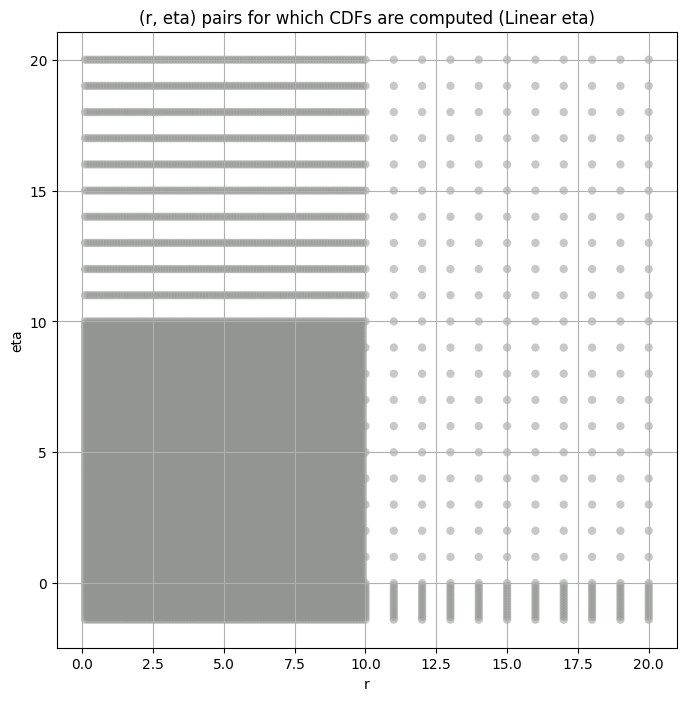

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,53.276510,33.872886,152.802713,68.874435,7.629437,437.942804,480000000.0,dual_color
2,72.914954,46.840640,194.994765,70.467031,8.488360,409.581182,480000000.0,dual_color
3,21.122359,13.977334,48.453006,60.386705,7.087002,367.258826,480000000.0,single_edge
4,87.957409,60.473776,142.215733,21.750371,7.542111,108.327211,480000000.0,dual_color
5,55.207904,39.862001,87.753125,16.862899,5.354291,133.778512,480000000.0,dual_color
6,40.185553,25.679989,105.328409,60.163445,6.741069,394.752770,480000000.0,single_edge
7,22.804529,16.940818,43.045728,22.371653,3.175920,204.336144,480000000.0,inside_out
8,1.781040,1.258188,6.086729,120.835038,3.632314,537.290190,480000000.0,misc
9,8.497680,4.809712,79.841307,1072.609333,6.218030,802.832624,480000000.0,multi_edge


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,53.276510,53.276510,46.256614,43.461289,39.648461
2,72.914954,72.914954,63.118029,59.149630,53.656881
3,21.122359,21.122359,18.339972,17.214603,15.686373
4,87.957409,87.957409,79.929777,75.717095,69.608173
5,55.207904,55.207904,50.896948,48.722548,45.565019
6,40.185553,40.185553,35.093465,33.001450,30.131485
7,22.804529,22.804529,20.947886,20.139012,18.997708
8,1.781040,1.781040,1.555322,1.486920,1.393185
9,8.497680,8.497680,6.413194,6.020045,5.505596


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.025802814503554705 53.276510482134775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.0258145246509065 46.25661439658976


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.02629467155683074 43.461289405666456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.026067815247285464 39.64846081916629
Number of samples: 100000, Without approximation : 480000000.0


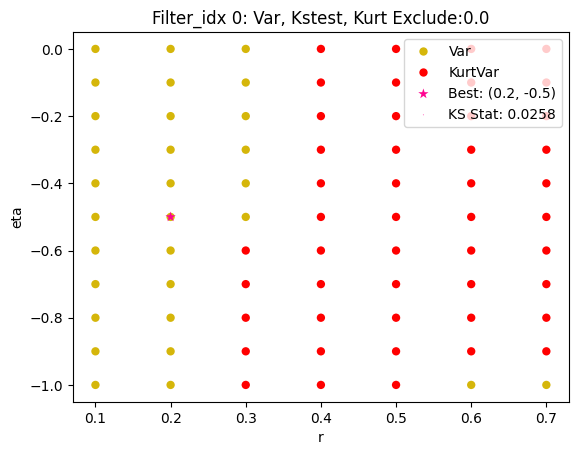

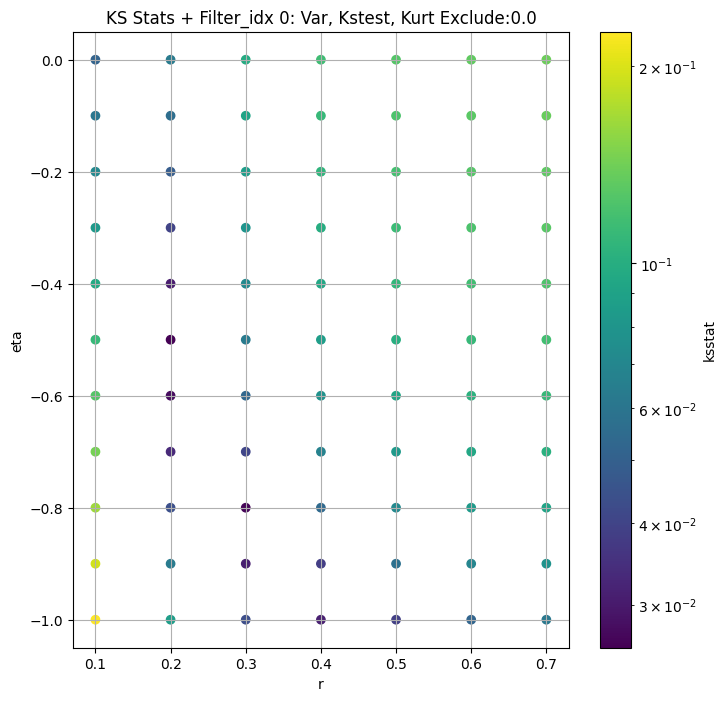

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.015951909773321976 72.9149543891323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.01737063962178287 63.118028615210235


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.017815959112720187 59.149630366031694


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.01710196572231637 53.656881208263016
Number of samples: 100000, Without approximation : 480000000.0


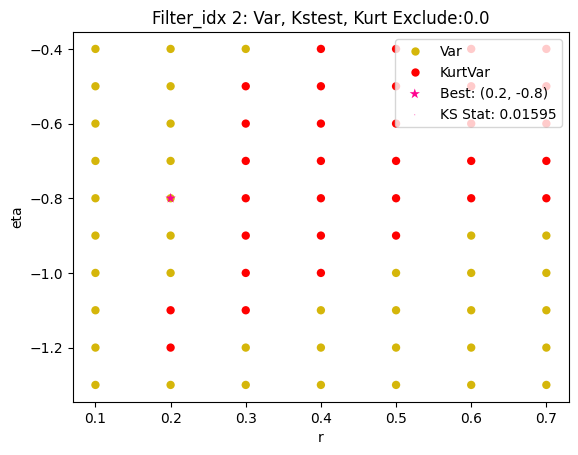

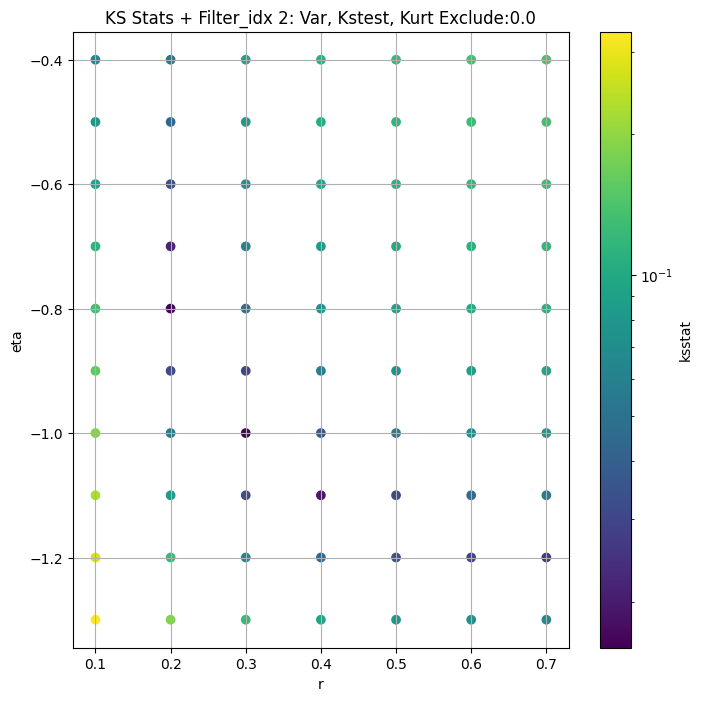

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.006575931485040543 21.122358538745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.009377696816938896 18.339971717243493


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.010966842613120864 17.214602652449333


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.010037048144313165 15.686373492277626
Number of samples: 100000, Without approximation : 480000000.0


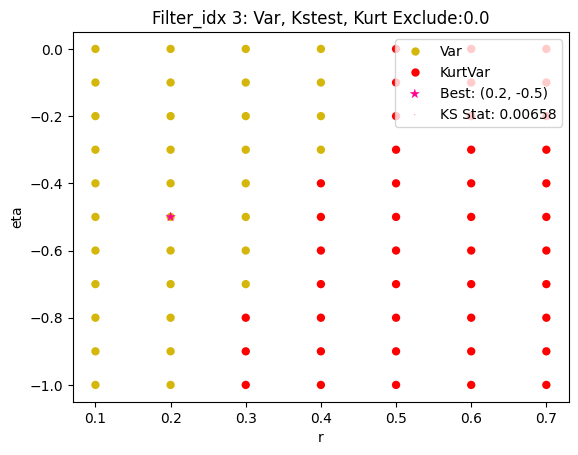

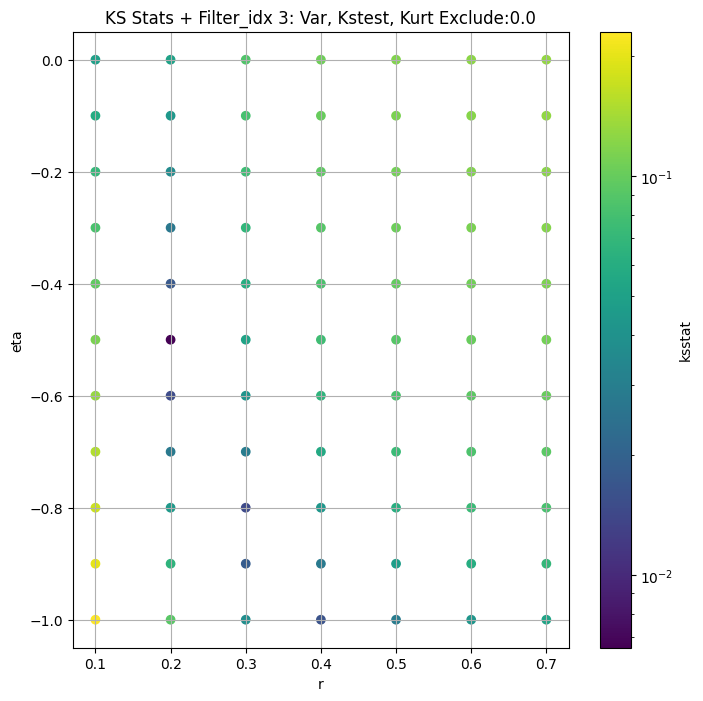

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.01781109715373365 87.95740886669597


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.015418285623909234 79.92977719255323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.014571215547307226 75.71709479850512


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.0173342761762747 69.60817303087032
Number of samples: 100000, Without approximation : 480000000.0


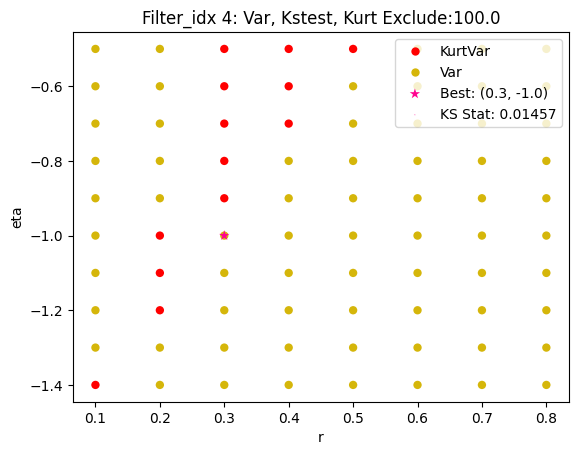

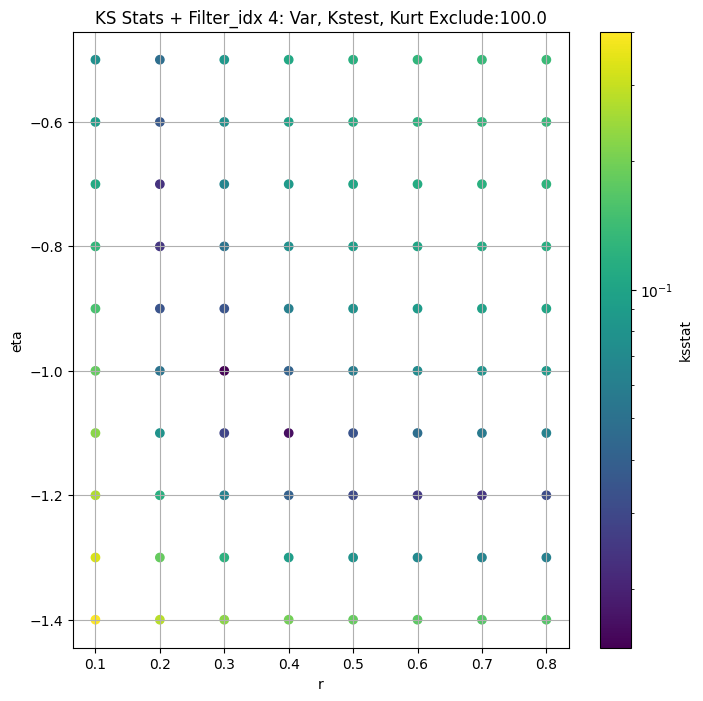

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.02505461660638142 55.20790368051543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.025324547533454977 50.89694766910578


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.02548607025148336 48.72254755846359


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.026899855827003105 45.56501936214529
Number of samples: 100000, Without approximation : 480000000.0


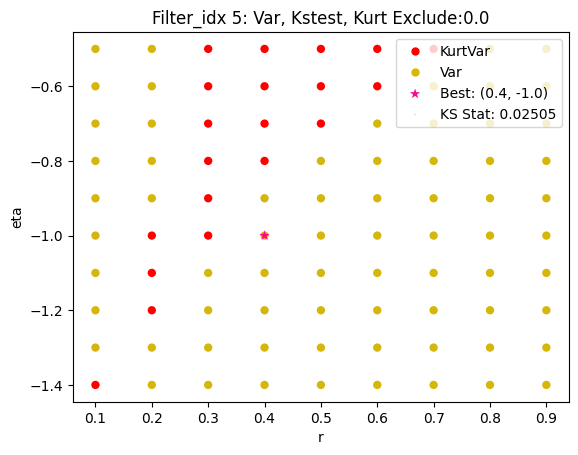

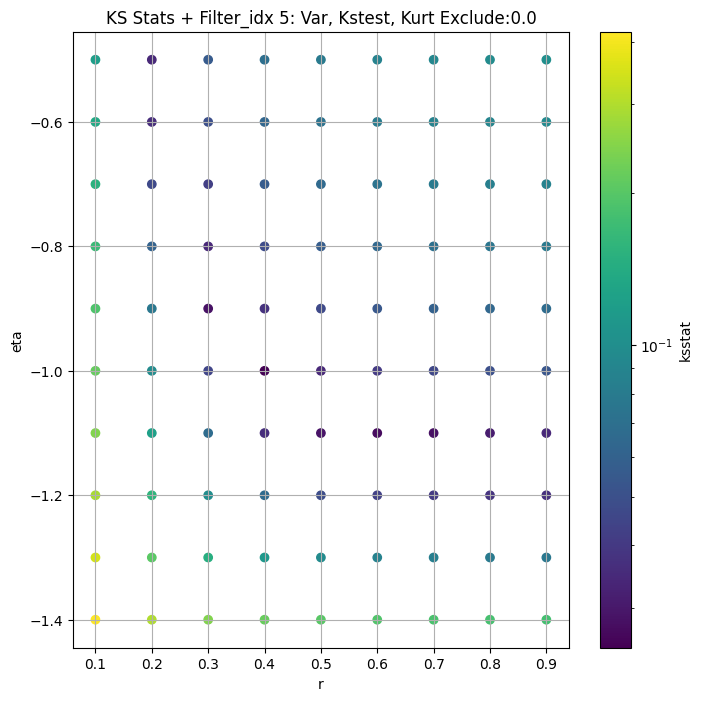

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.017343682919620962 40.185553059698734


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.016722769201298837 35.09346541877432


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.018304527692810102 33.0014501618506


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.015931416383611674 30.13148473250982
Number of samples: 100000, Without approximation : 480000000.0


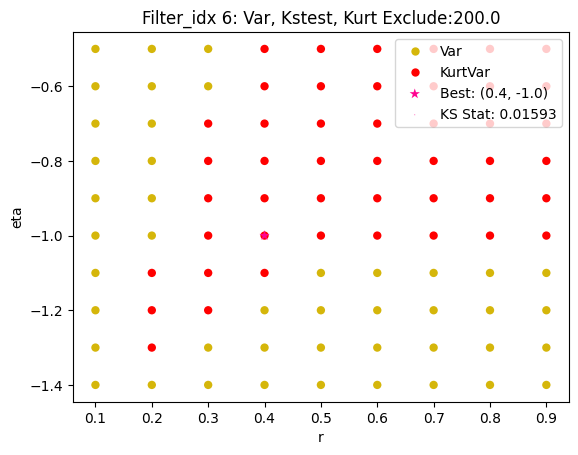

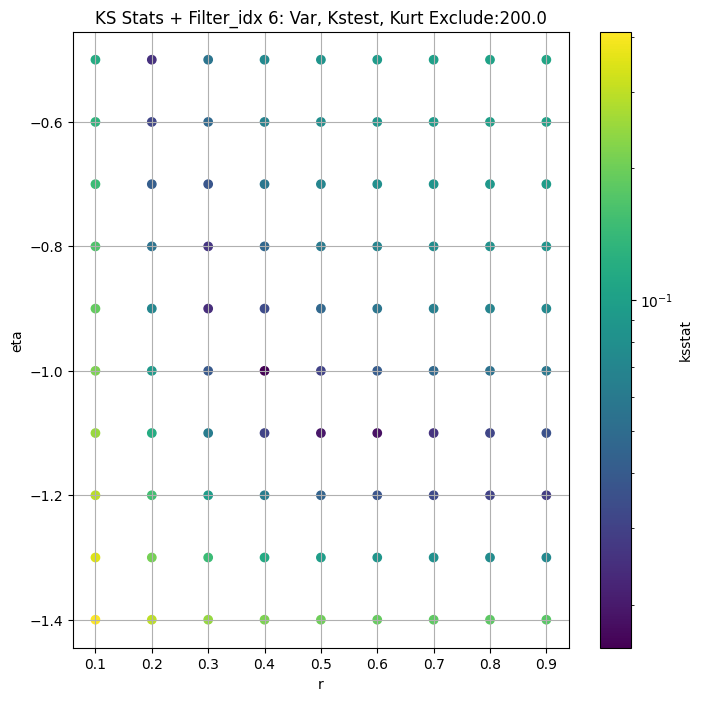

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.029854606684469598 22.804529036081163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.029726535438387214 20.947885589456718


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.029753862327954406 20.13901215652379


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.02969948034811809 18.997707621416566
Number of samples: 100000, Without approximation : 480000000.0


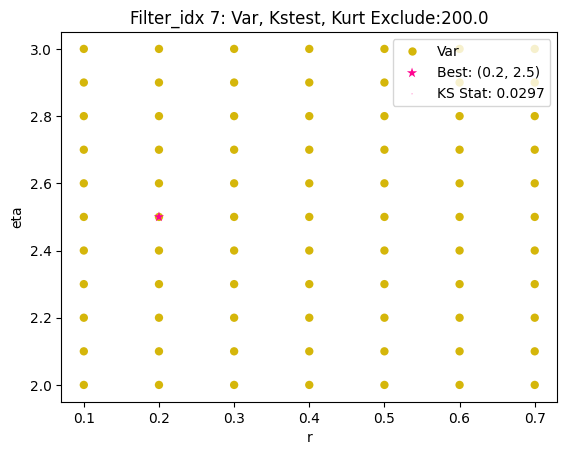

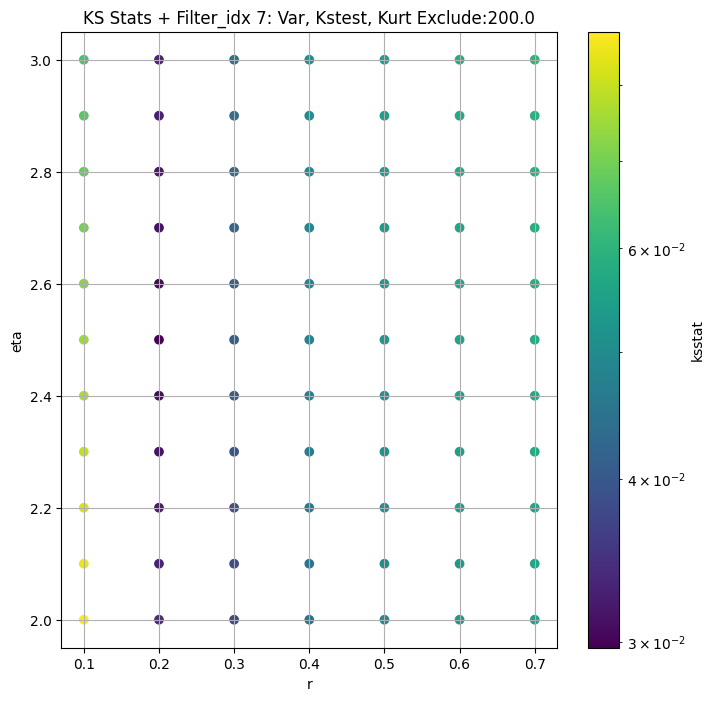

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.014103616961246568 1.7810400944413478


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.014086796784179456 1.5553219639482867


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.014084907129657098 1.4869197676143786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.014081288723968854 1.3931847236325126
Number of samples: 100000, Without approximation : 480000000.0


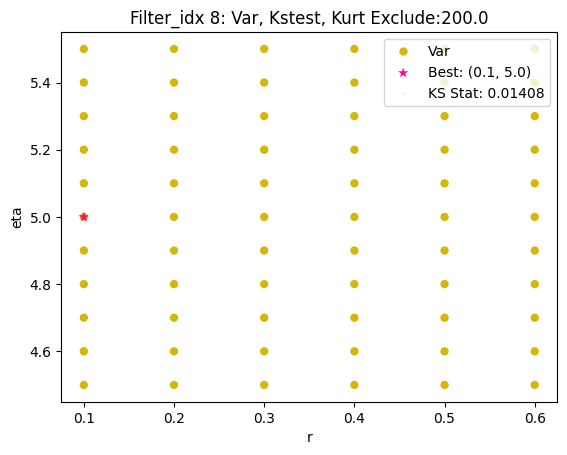

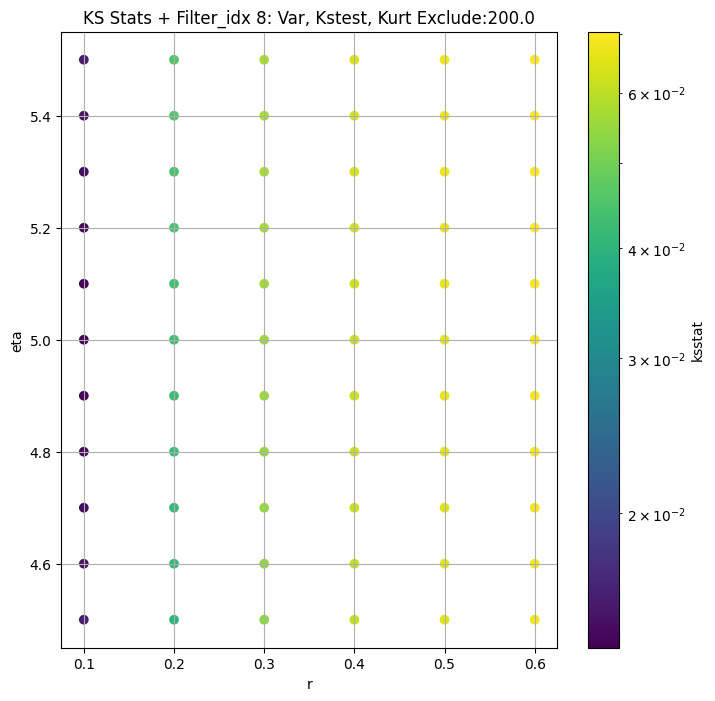

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0036319775009628907 8.497679772193038


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.004569208261594182 6.413194270426675


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.004506925535576571 6.020044697333665


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.0055873812654249205 5.505595676916939
Number of samples: 100000, Without approximation : 480000000.0


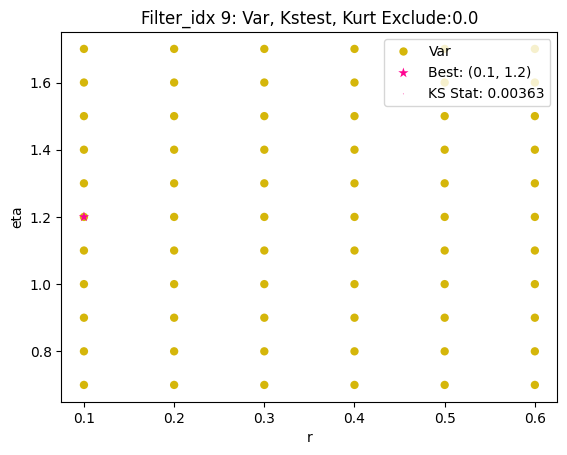

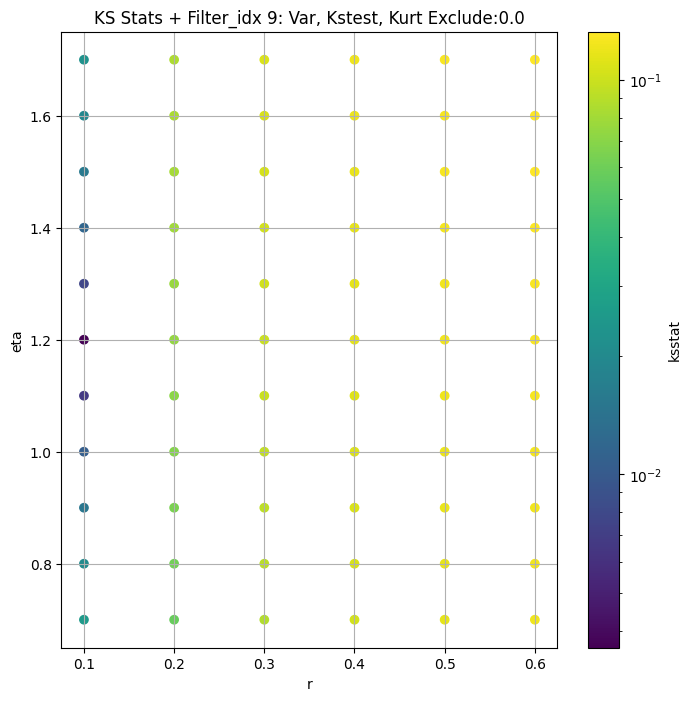

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.013734295763235316 33.37461460247059


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.015026685065591405 29.45187265718814


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.013300720437830038 27.734977902853274


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.016445129758216104 25.38468198213574
Number of samples: 100000, Without approximation : 480000000.0


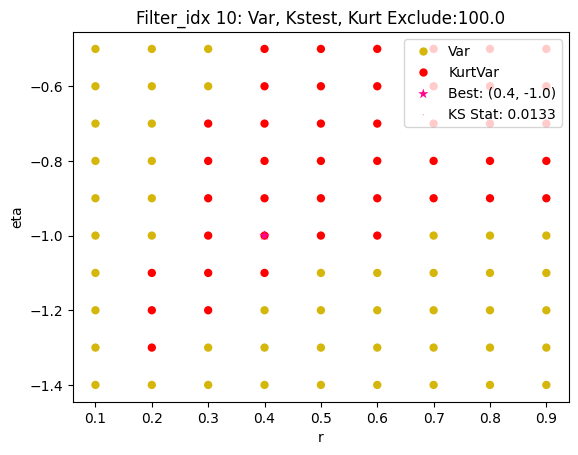

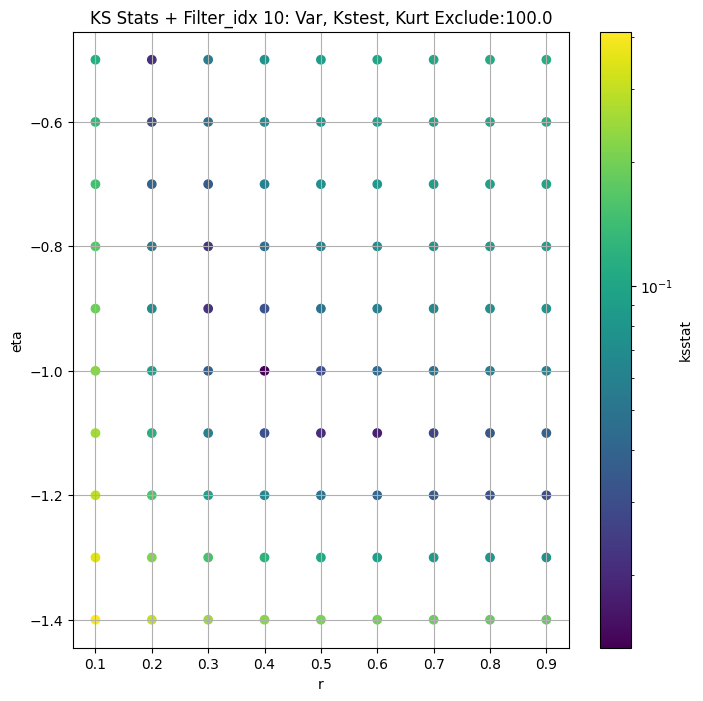

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.016154140455857502 35.6231326704054


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.012617563832569845 29.967909875615256


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.016255183810943055 27.846558089369996


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.017967393770099926 24.999528927357055
Number of samples: 100000, Without approximation : 480000000.0


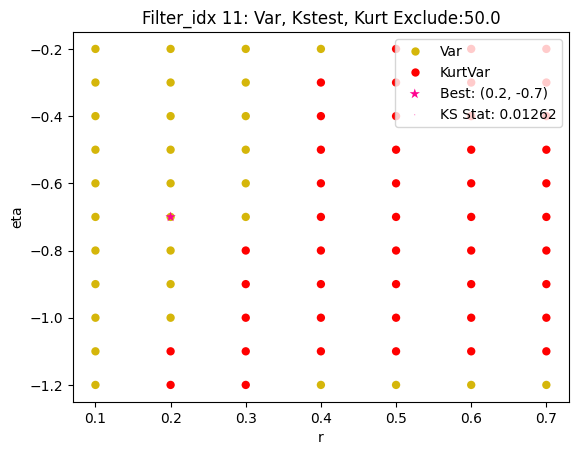

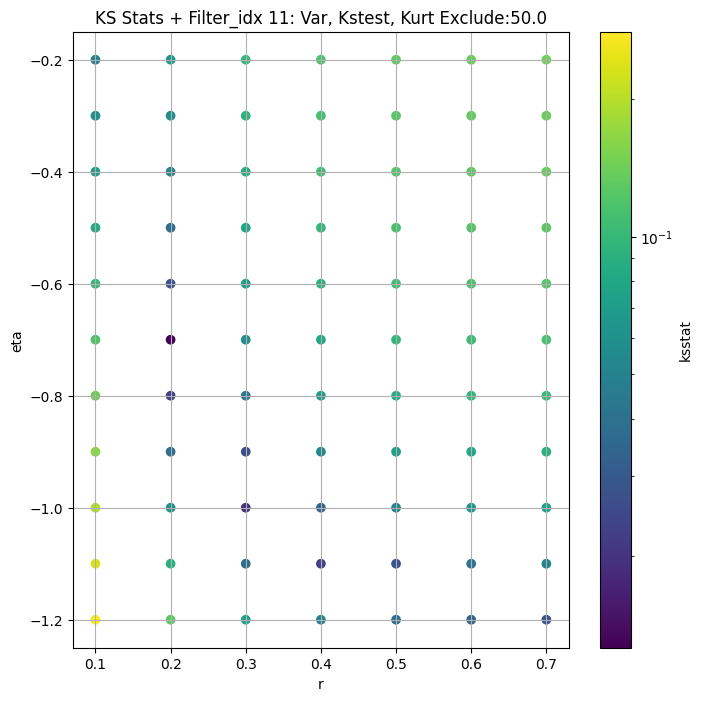

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.0088755289010648 43.917231013103276


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.010903467753409557 37.24088575938206


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.012052279402727128 34.830856819316146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.013382128940621393 31.64508004942818
Number of samples: 100000, Without approximation : 480000000.0


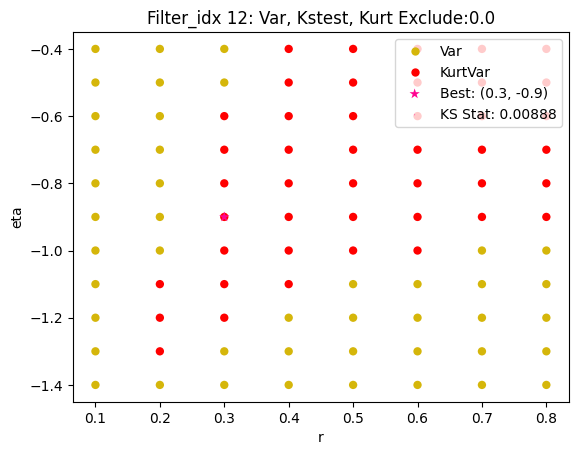

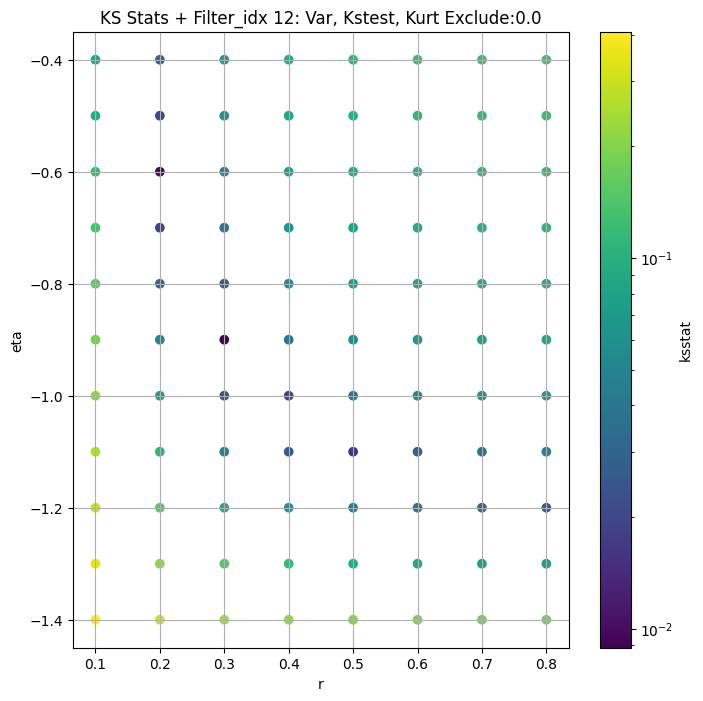

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.011390057515519025 26.80083113292681


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.013026273162087043 23.150267672165267


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.010647791865493916 21.715201628357498


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.014164157177423392 19.79773644820884
Number of samples: 100000, Without approximation : 480000000.0


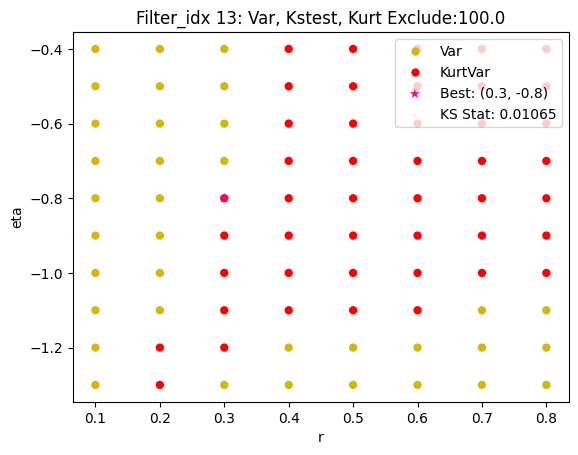

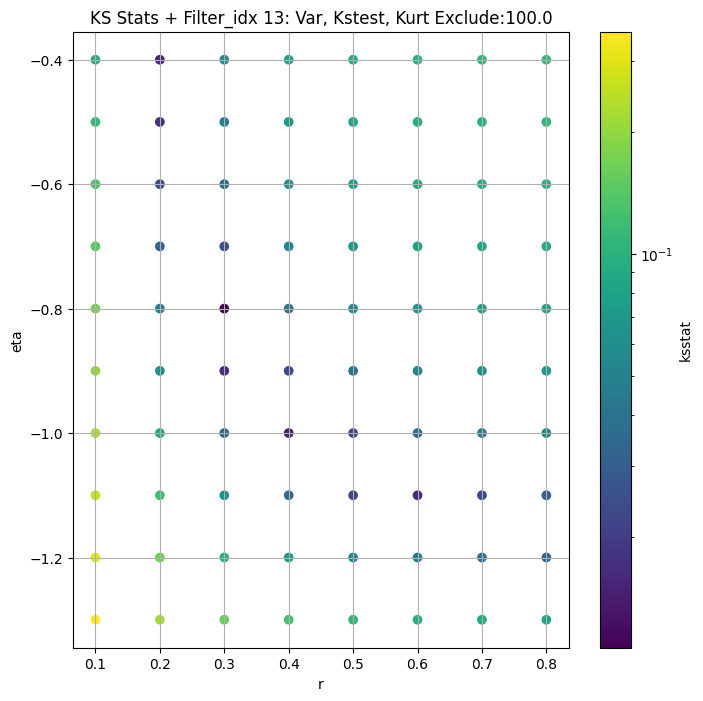

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.019352237686500517 34.87331626467633


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.022170488647107744 30.55263883678577


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.019521484087677066 28.7115176875239


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.019701797065185267 26.19248568911704
Number of samples: 100000, Without approximation : 480000000.0


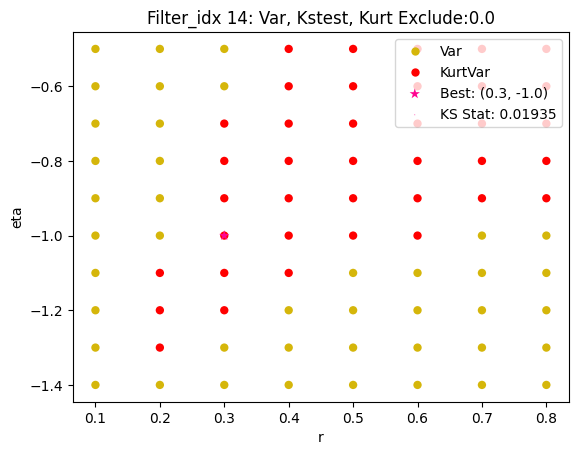

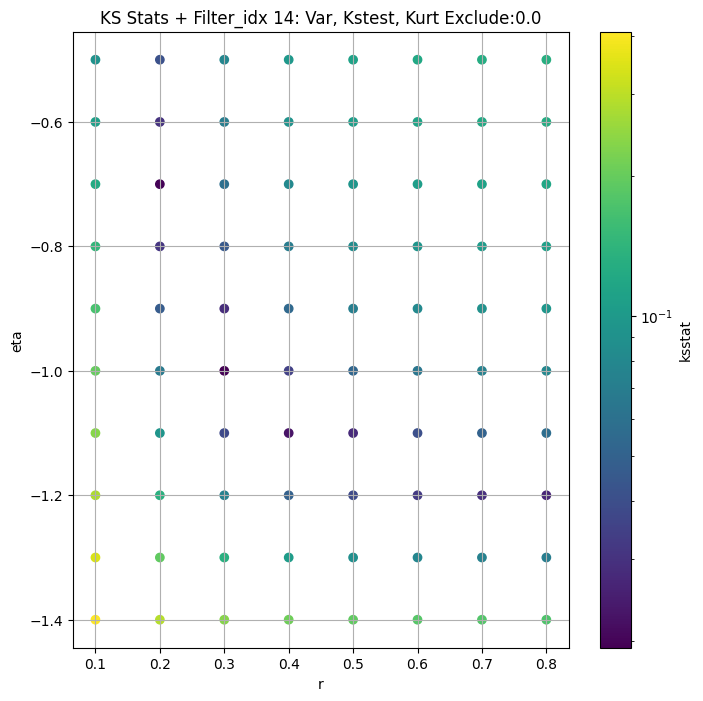

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.01634102850797714 40.983663078548624


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.016177843581687168 38.293910681049056


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.016071031321003848 36.99433502769968


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.01599431961699449 35.157793284578936
Number of samples: 100000, Without approximation : 480000000.0


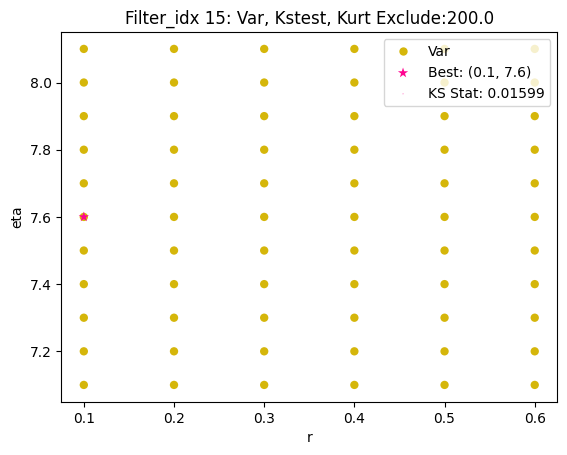

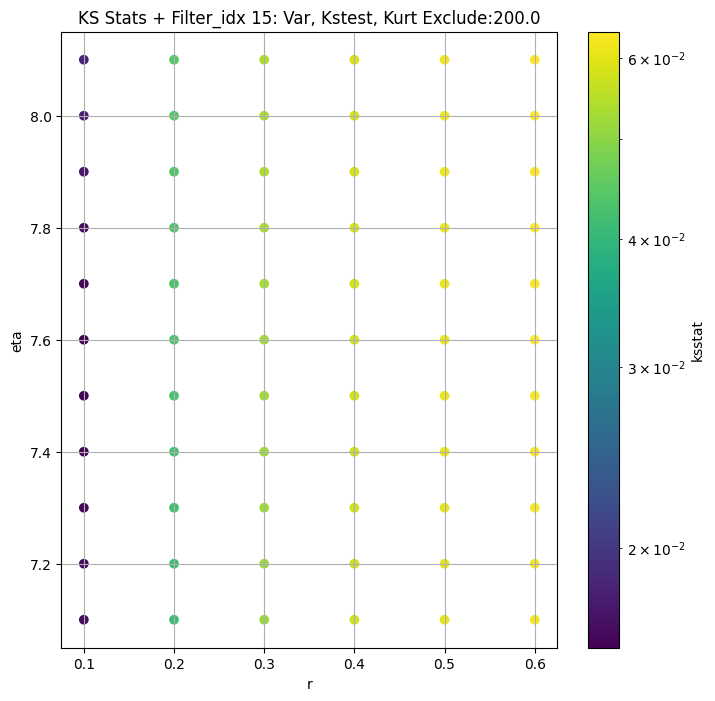

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.004954198575552793 56.9681428884678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.005674661408564152 47.57822527290742


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.008361745339719118 44.41031001470188


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.009986596625039534 40.284554069173375
Number of samples: 100000, Without approximation : 480000000.0


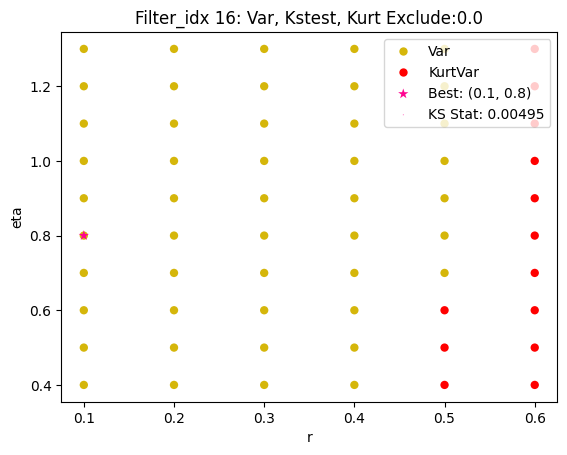

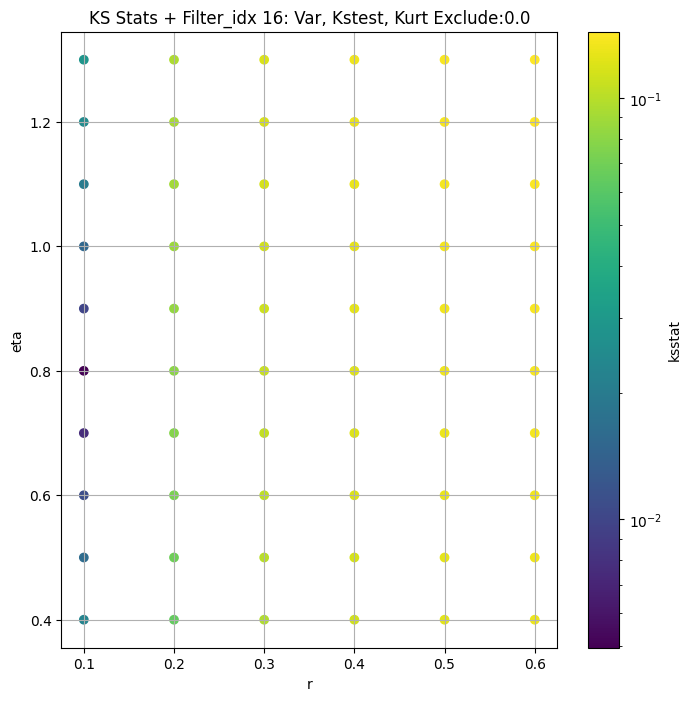

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.022263111707261474 53.075738172875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.023460735486582895 47.913122779145674


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.02395212091311738 45.42236850279344


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.024713630731737823 41.88794741851437
Number of samples: 100000, Without approximation : 480000000.0


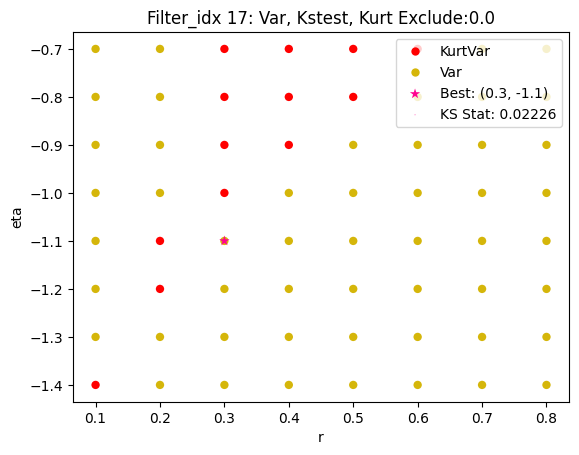

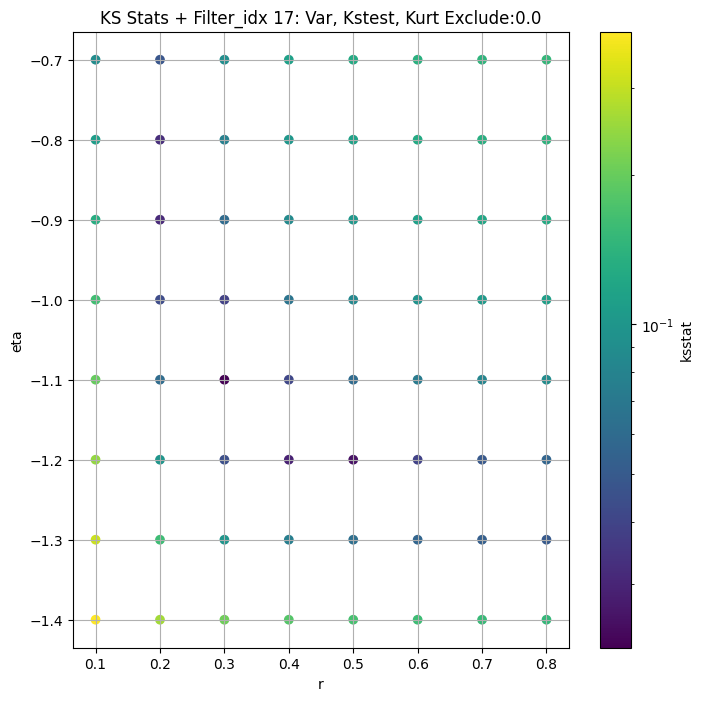

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.008263320559411869 44.322678443361845


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.008179451564816864 36.67477674359165


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.010191543773111322 34.10429252726647


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.0084595730180691 30.80608722174045
Number of samples: 100000, Without approximation : 480000000.0


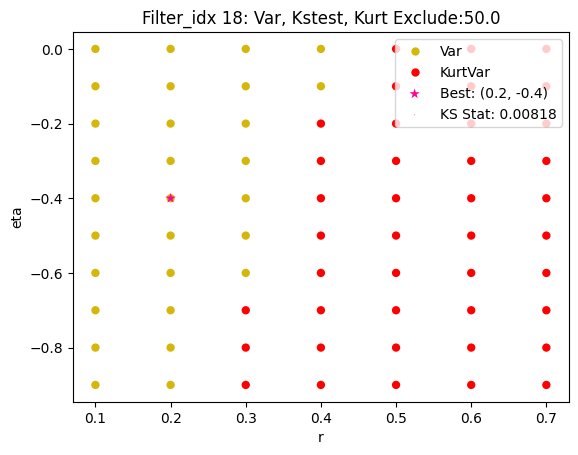

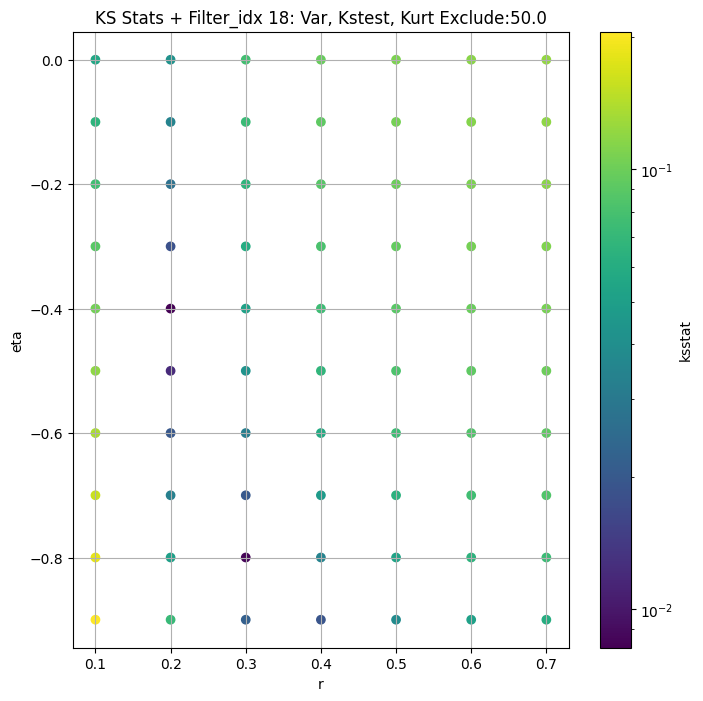

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.011932568328126725 33.46226181605903


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.014049635556393825 28.146996173335385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.013976682898888926 26.3512379589517


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.015580934394297863 23.9581002988103
Number of samples: 100000, Without approximation : 480000000.0


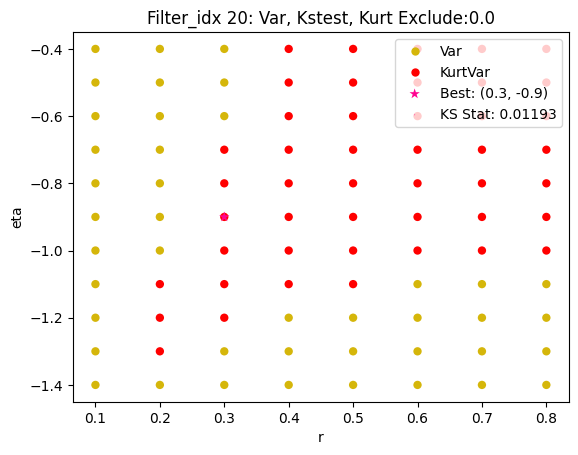

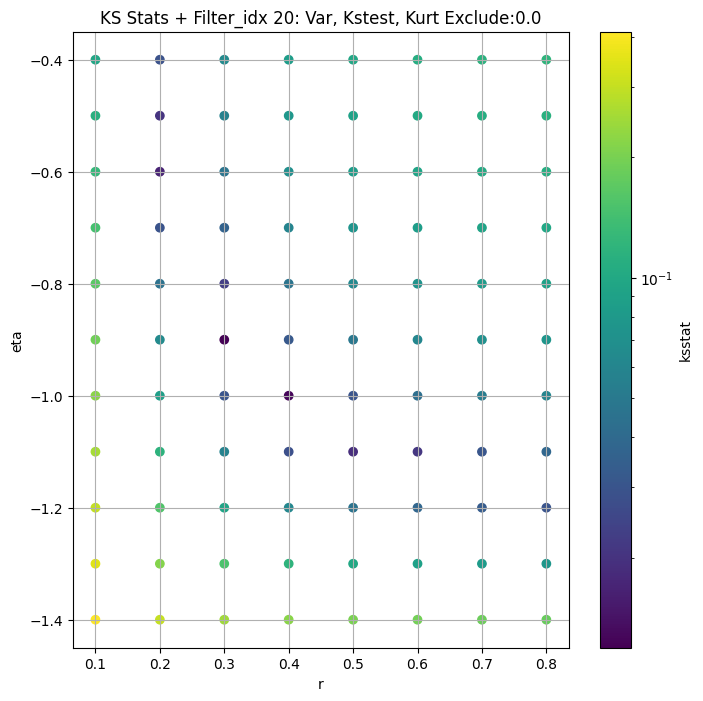

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.010374996369811873 16.84434584248119


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.011468809814449185 14.804790483778156


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.012341532410803047 13.985523868692836


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.010312380492694562 12.86123104149543
Number of samples: 100000, Without approximation : 480000000.0


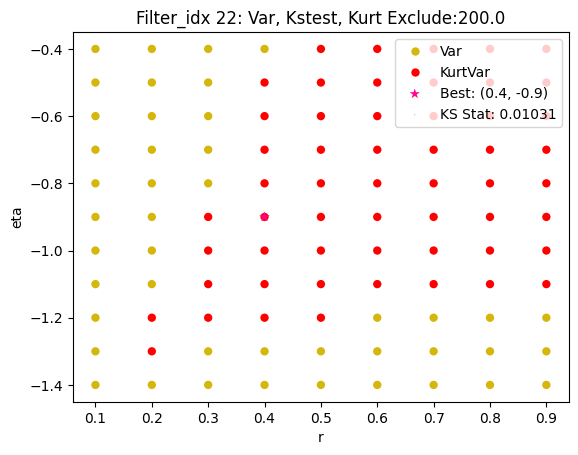

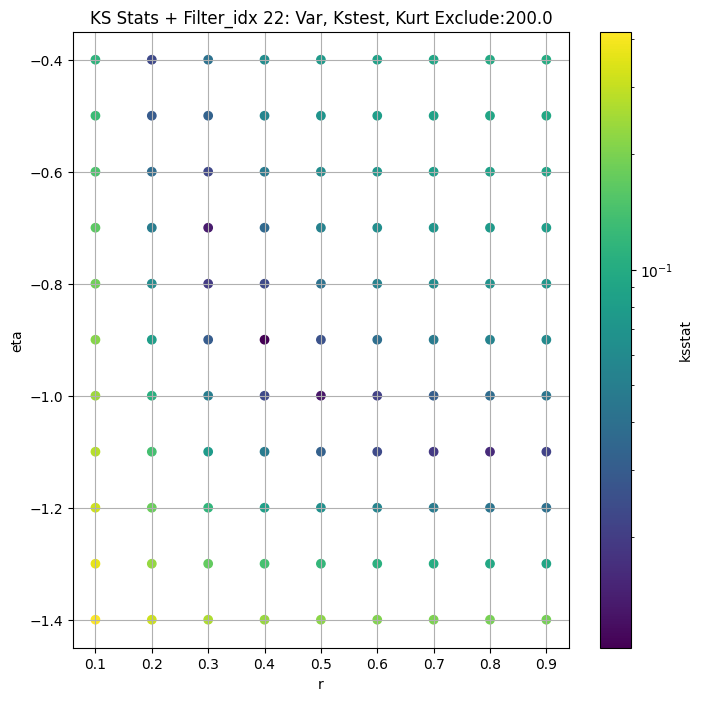

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.014020919573203616 29.395191745986853


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.011332827431056541 26.27839142539741


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.014422861127079717 24.92363383590627


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.01624417400760836 23.027425574928504
Number of samples: 100000, Without approximation : 480000000.0


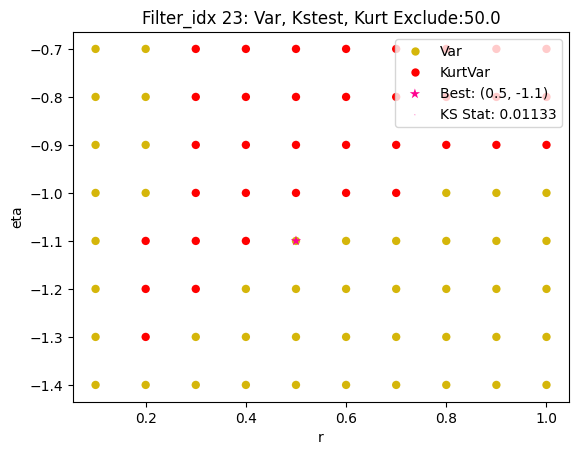

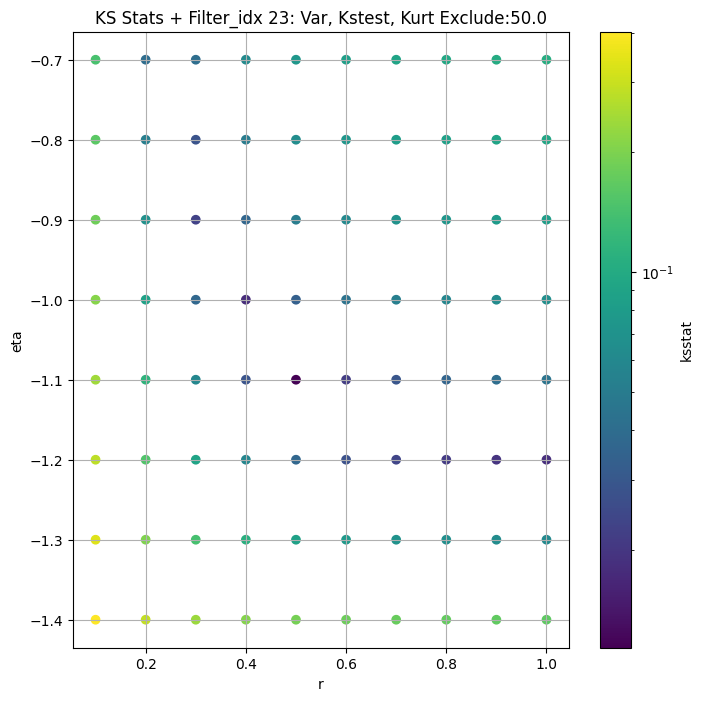

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.00805840654331691 19.61666404451466


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.009494432647475126 16.355217423085808


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.009381671279953485 15.269404617705801


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.011140235089465711 13.813791776876542
Number of samples: 100000, Without approximation : 480000000.0


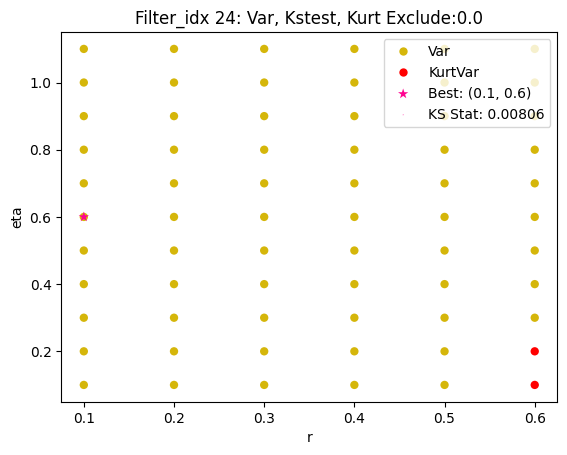

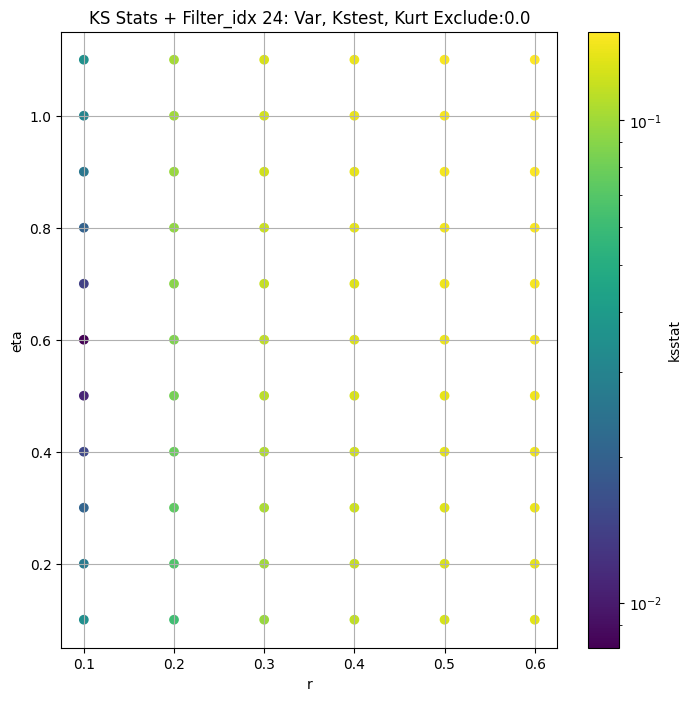

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.0035888060451545467 8.296648013517709


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.0047825612807888 7.065442941976558


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.005749211648473418 6.6522566387069695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.00696105040289411 6.101265865785954
Number of samples: 100000, Without approximation : 480000000.0


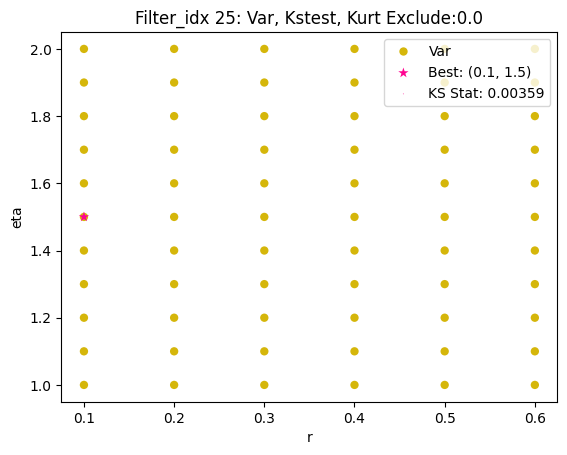

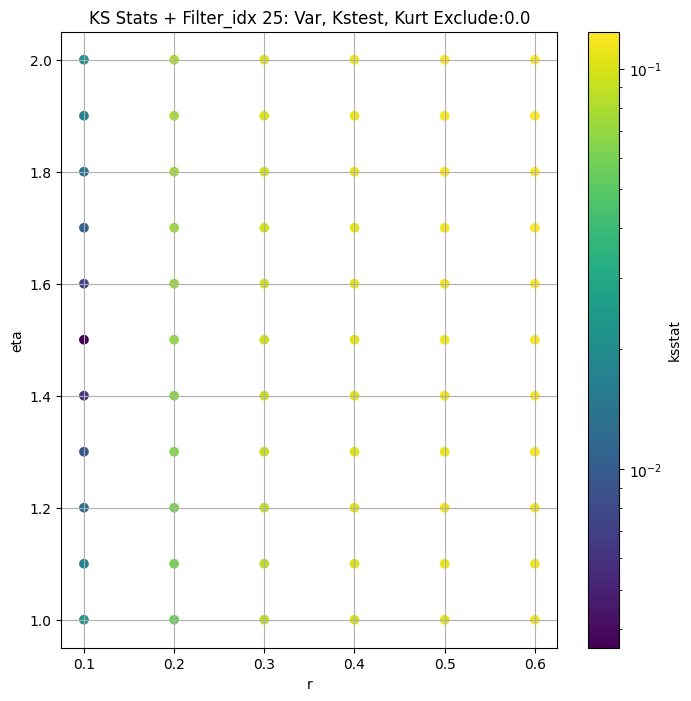

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.02154676453423765 39.24263668891069


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.02125792232948165 34.94919705716338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.02118132487118013 33.10830886934289


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.02145139117023004 30.559027882936995
Number of samples: 100000, Without approximation : 480000000.0


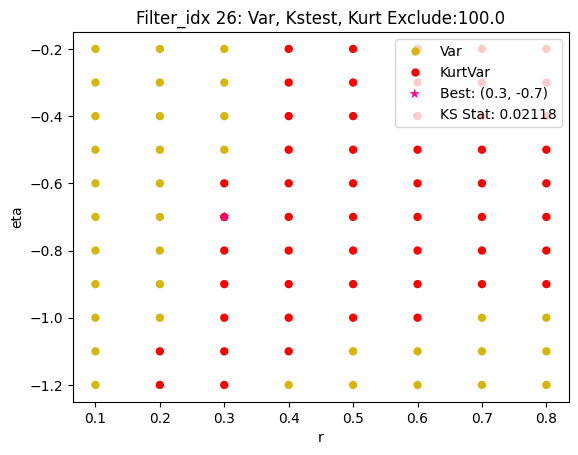

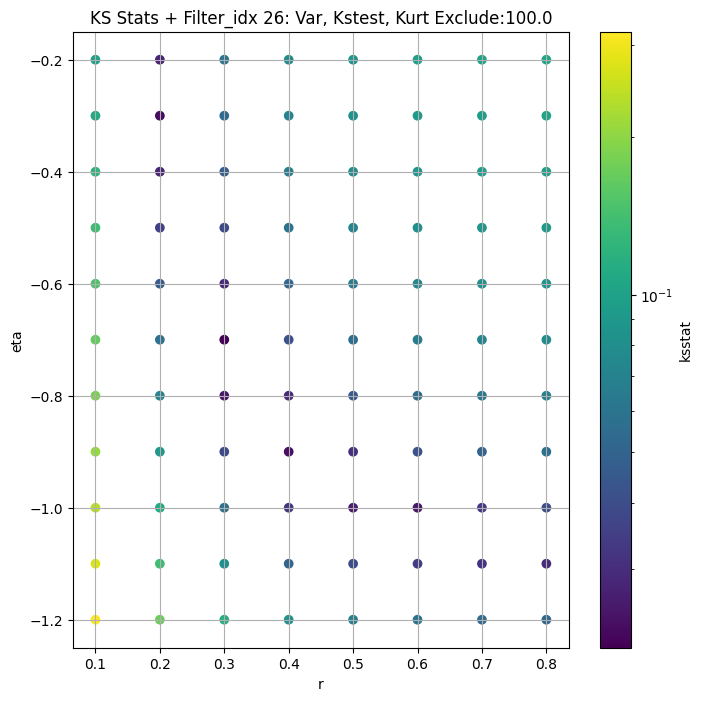

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.0046619283124441635 8.69216657365792


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.004505342231794565 6.661957742696044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.00446875582260553 6.233462656356547


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.006527006727638618 5.672320948441734
Number of samples: 100000, Without approximation : 480000000.0


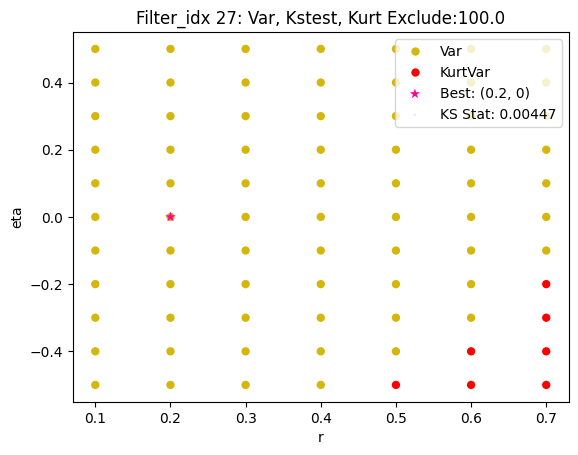

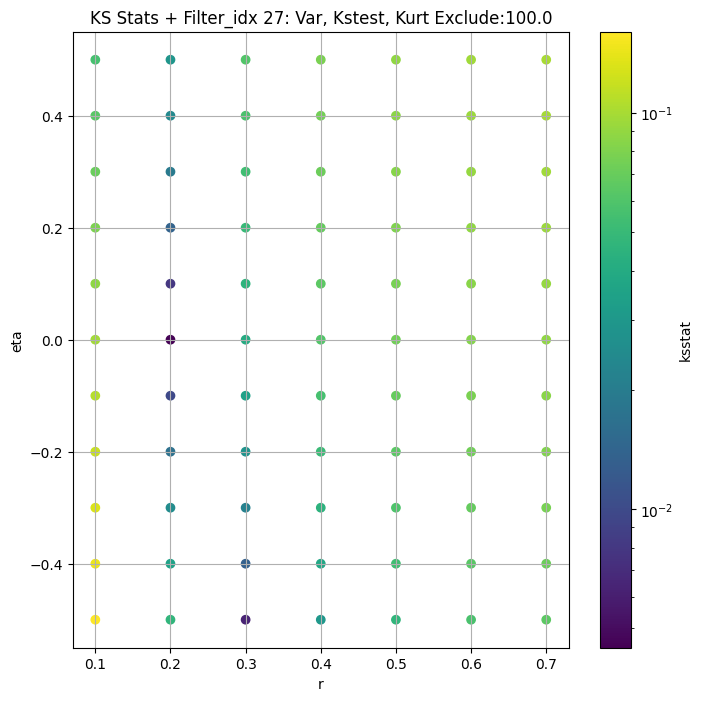

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.011890384826243494 26.206570779202075


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.012479009079737702 22.52746519584463


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.009369187899131604 21.20239803595793


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.013879843634408306 19.39413524368263
Number of samples: 100000, Without approximation : 480000000.0


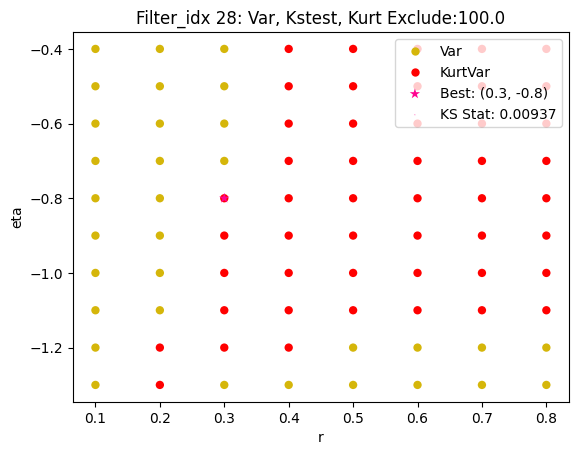

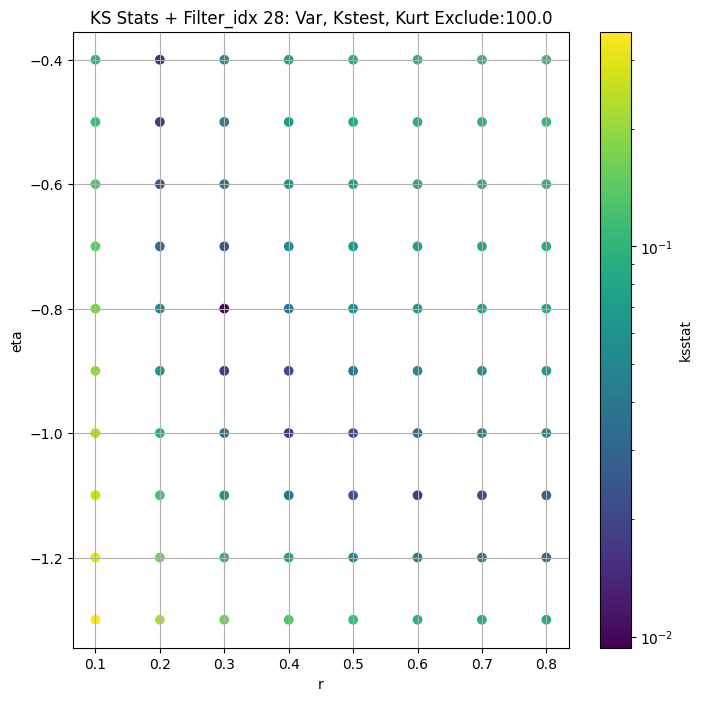

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.03012891923059352 18.060452239672472


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.03011162470425993 15.675591730469767


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.03029144245423404 14.684336708406057


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.030116134231518765 13.322549923109957
Number of samples: 100000, Without approximation : 480000000.0


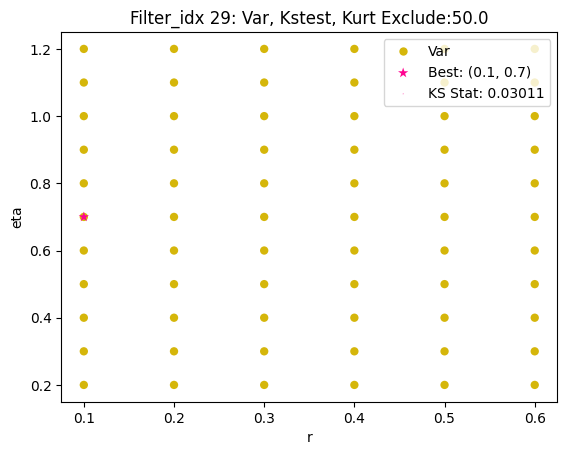

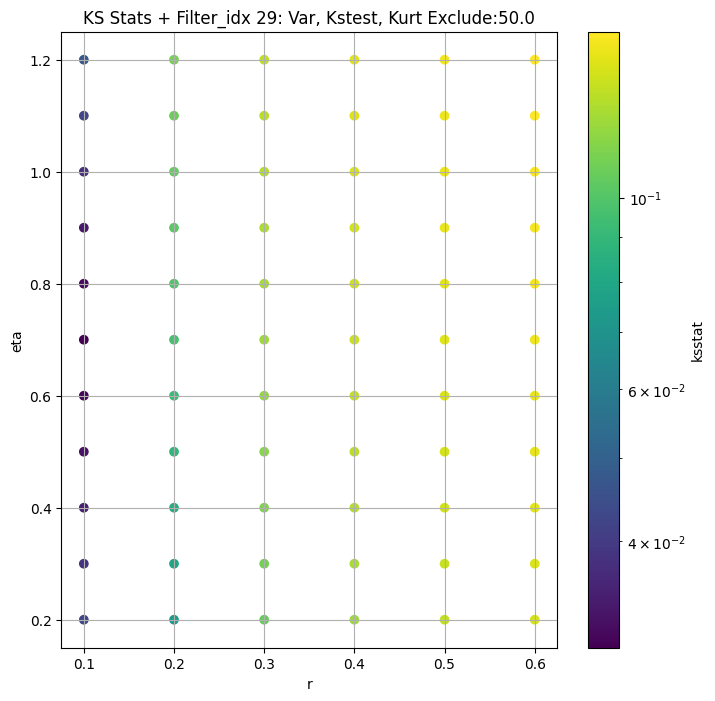

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.006785005238884853 17.88258225366284


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.007907524422381296 14.745936686490285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.007973528611394179 13.676543821483993


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.009777762778177643 12.263470043021565
Number of samples: 100000, Without approximation : 480000000.0


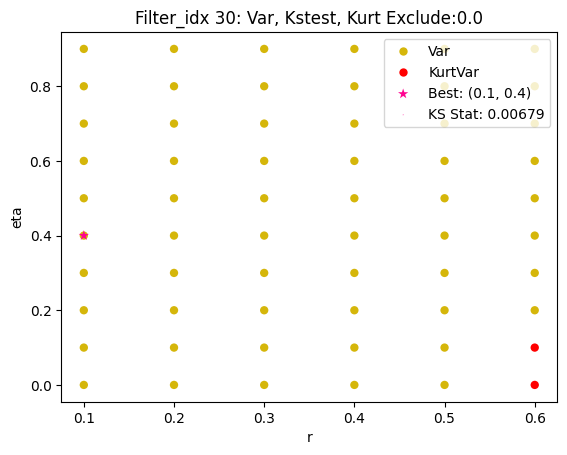

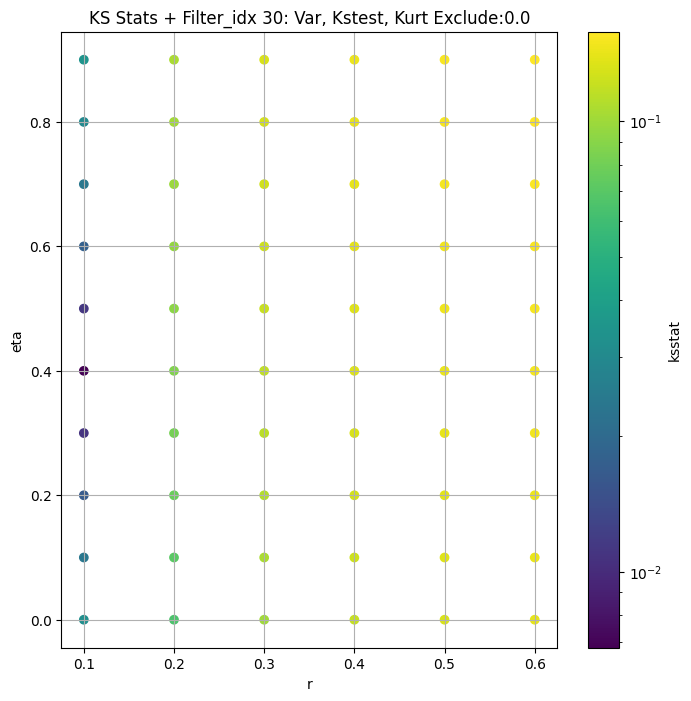

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.05878467714538416 42.23151078674035


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.058785465187035923 38.09357601081868


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.058786874343846496 36.17139321775513


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.0587847786449337 33.50018704008288
Number of samples: 100000, Without approximation : 480000000.0


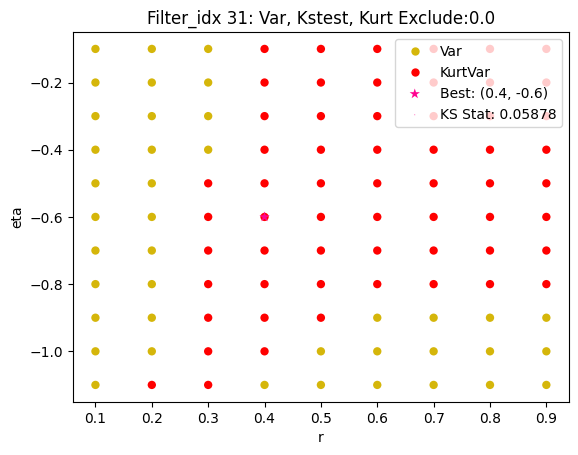

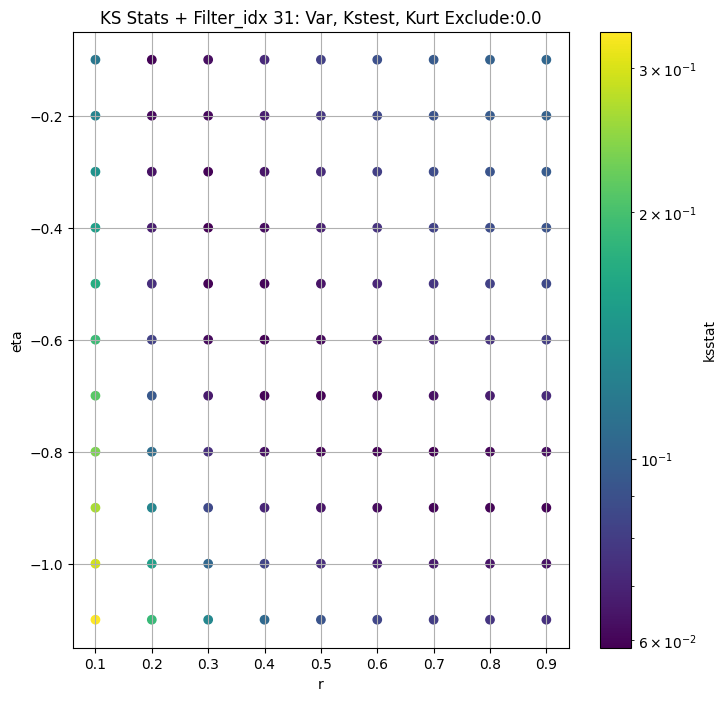

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.017136731963035556 28.368442330781566


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.018175756964174394 25.034929206281316


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.017917669471039843 23.568801127250733


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.016450447717942462 21.550336171197486
Number of samples: 100000, Without approximation : 480000000.0


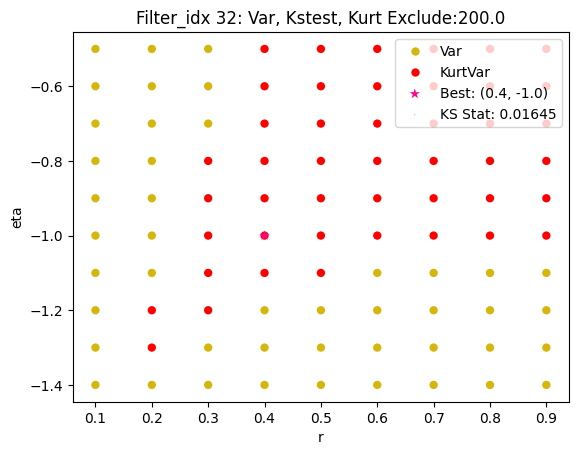

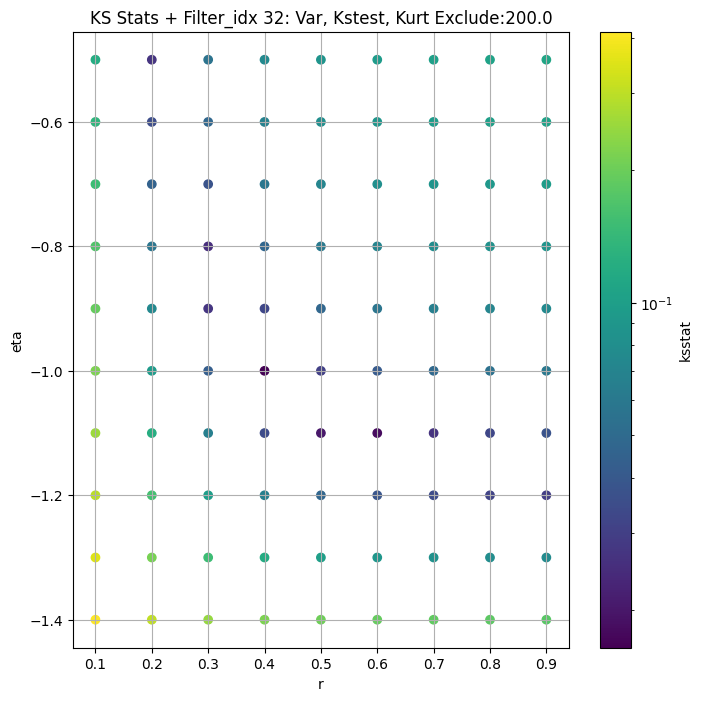

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.00713932140408946 15.705383976929351


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.004757497267440458 12.9970340075278


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.0046358903070137444 12.047982618570895


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.007183774870423099 10.82092697480984
Number of samples: 100000, Without approximation : 480000000.0


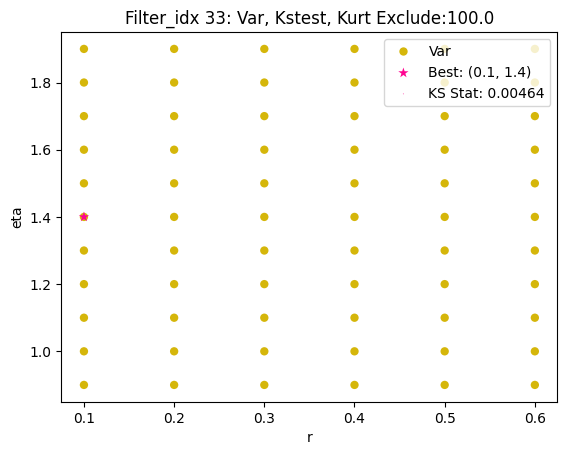

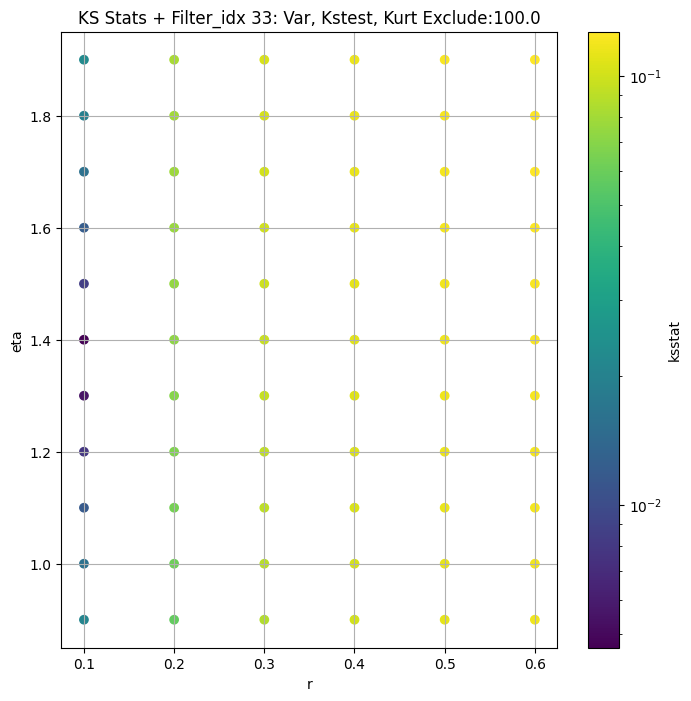

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.009098145222588117 23.40523629107464


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.011778787431025894 20.04356799763931


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.0111671203741609 18.820392629114668


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.01219161966952953 17.159430341742237
Number of samples: 100000, Without approximation : 480000000.0


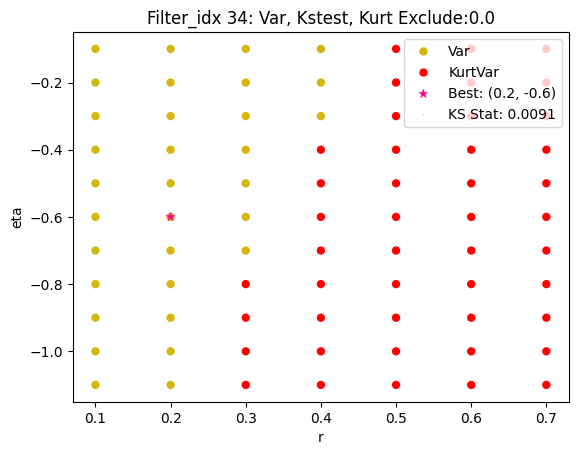

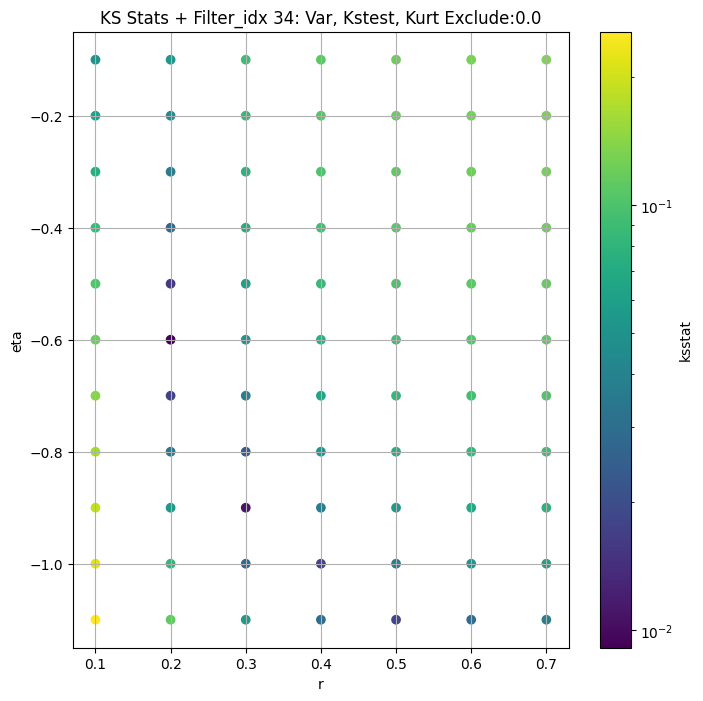

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.02581579065907663 67.93500187794221


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.026346409783535807 60.126265325761786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.02665452991599876 56.63816501342044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.027759539301096037 51.87446049902184
Number of samples: 100000, Without approximation : 480000000.0


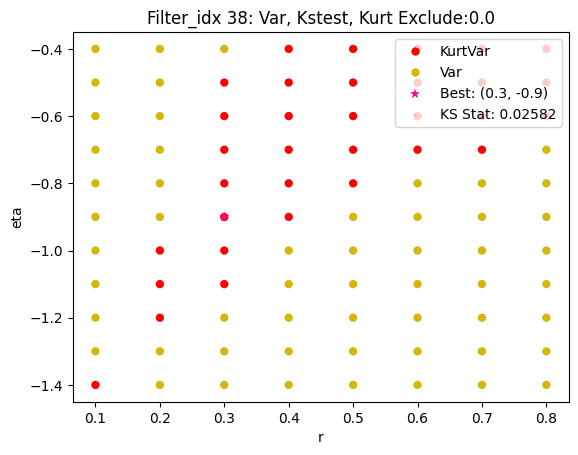

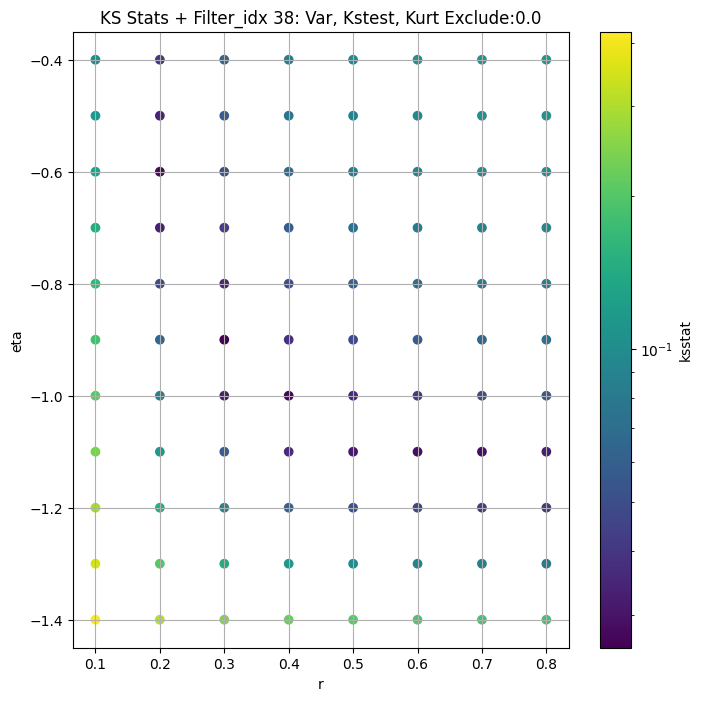

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.06174671630624534 47.87546758155271


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.06174766159786266 43.02074931816775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.06174703231560891 40.80369910828007


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.0617475090899014 37.72815584886442
Number of samples: 100000, Without approximation : 480000000.0


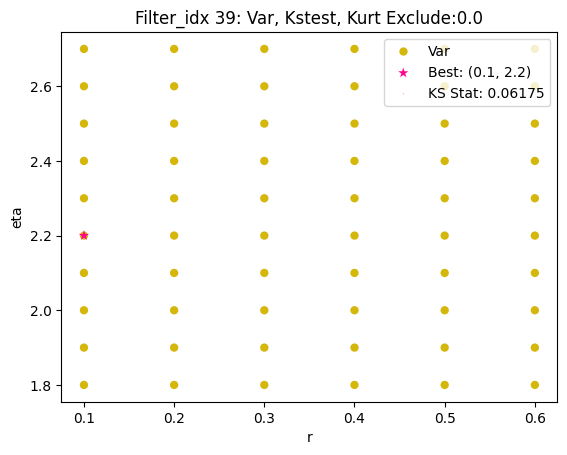

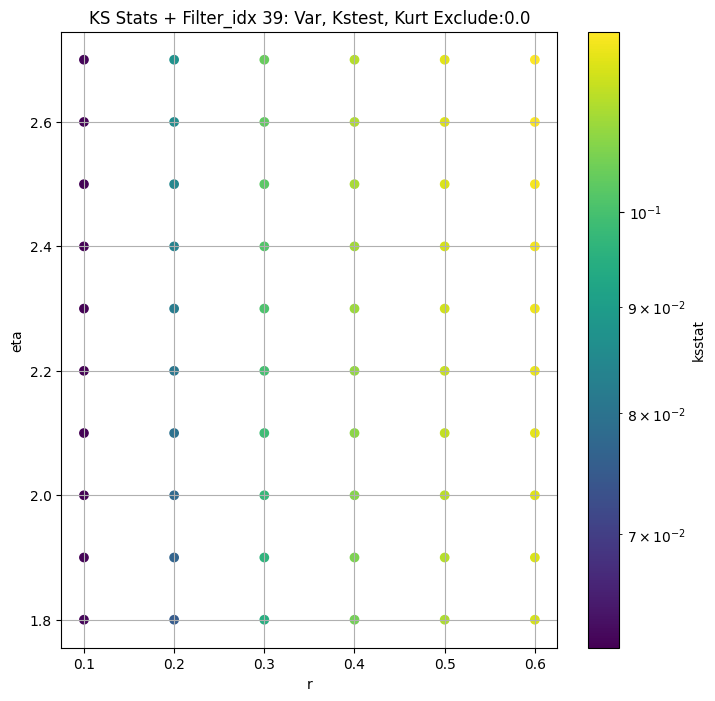

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.010823669416182624 40.60497447138543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.010782185322606164 37.993197203308355


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.01072495655978184 36.75334651736487


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.010713784240241109 34.984144703525416
Number of samples: 100000, Without approximation : 480000000.0


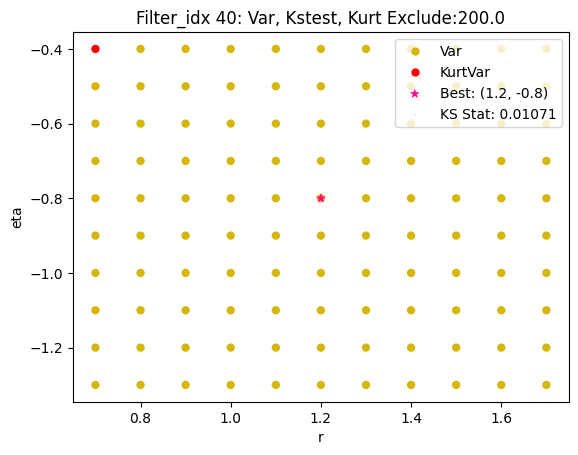

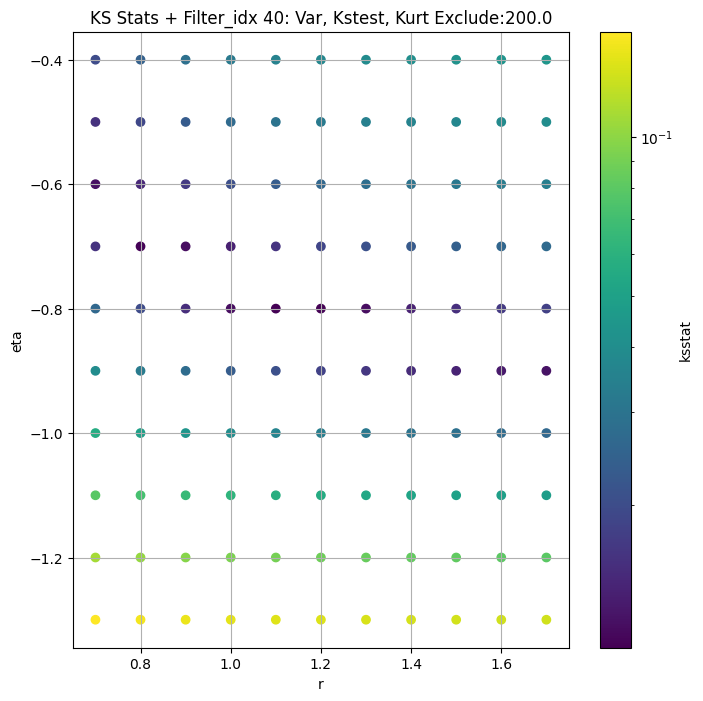

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.006694553760264399 27.048979509814643


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.005591997465169807 22.15413681372297


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.007546563069689927 20.441766195360163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.007092697867652542 18.233410962028504
Number of samples: 100000, Without approximation : 480000000.0


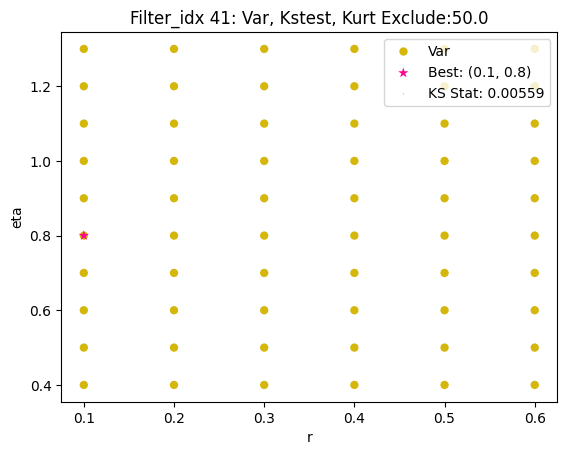

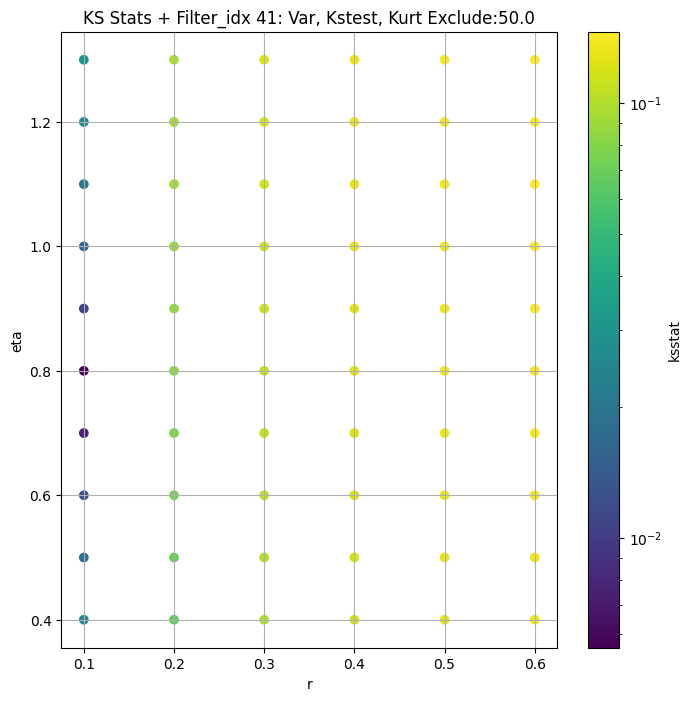

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.01216386707910111 72.9980805274623


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.014034409990746677 63.38132968546119


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.017370099909002512 59.31222989599197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.014528909233654352 53.72401564162994
Number of samples: 100000, Without approximation : 480000000.0


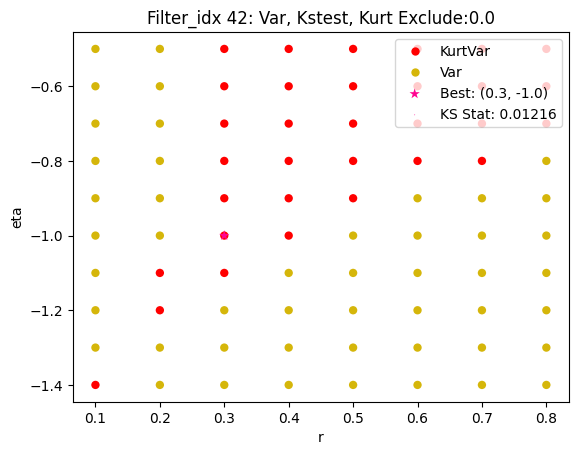

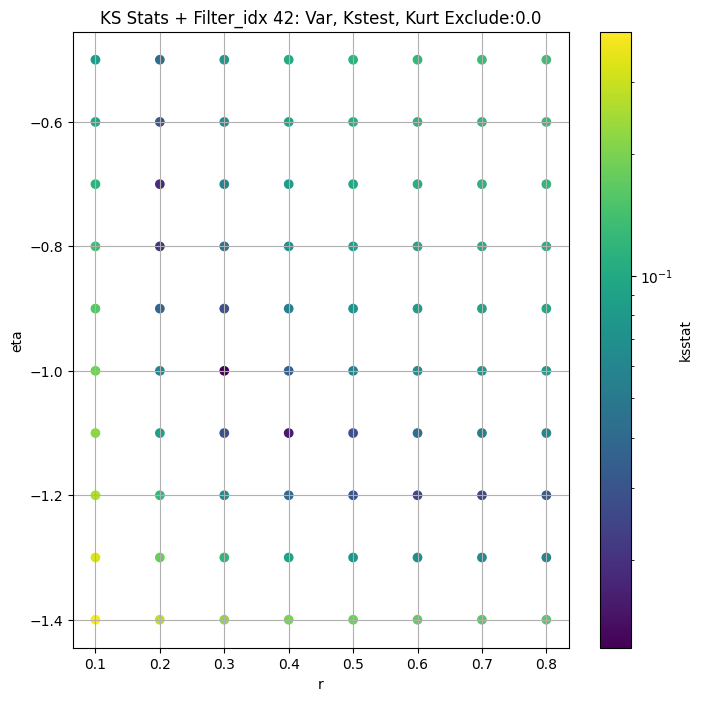

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.019697705328936443 27.02525070488623


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.019773401080380615 23.945199807855506


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.018101404436268065 22.630577082011115


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.019040906222594772 20.811231302116507
Number of samples: 100000, Without approximation : 480000000.0


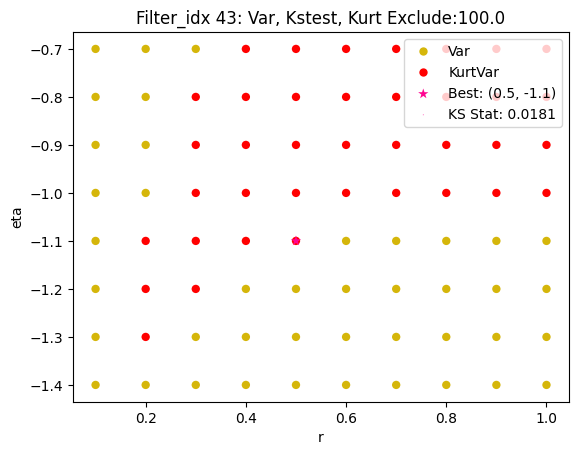

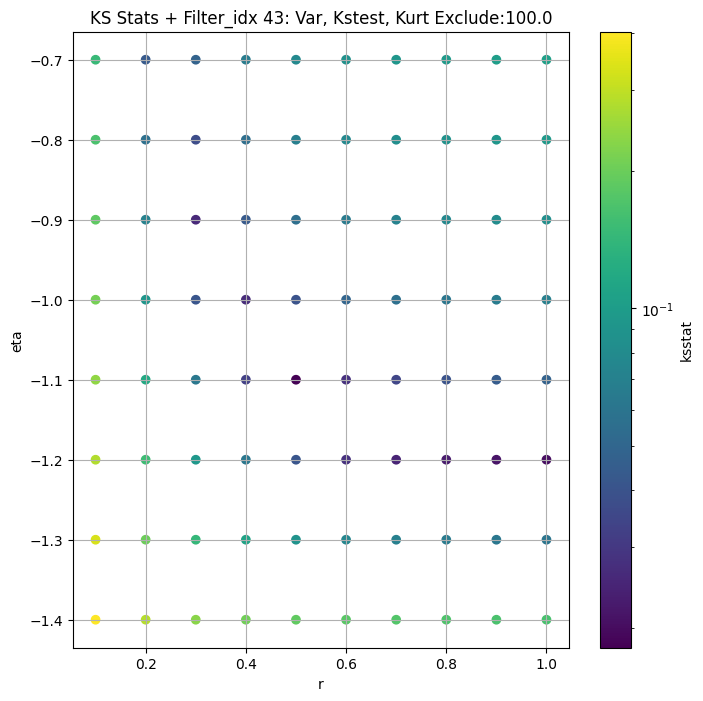

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.021381650525967966 58.2231766209637


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.02268598849797049 50.72438796051985


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.022379071565082842 47.35953371602822


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.023146913329756824 42.73278311389412
Number of samples: 100000, Without approximation : 480000000.0


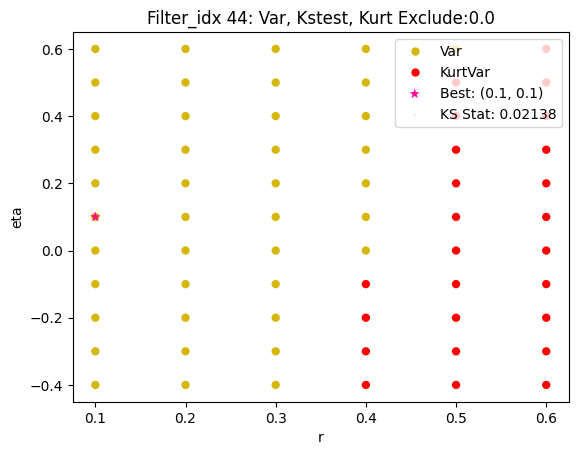

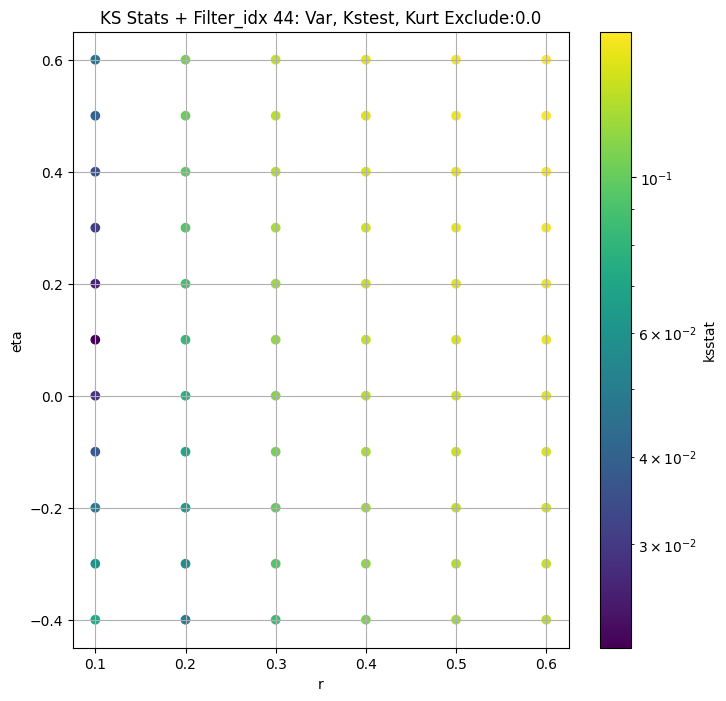

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.027875053284542595 36.25946688273299


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.02788290809747035 32.209509437327576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.028119037411825254 30.42867450015054


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.027919760611884448 27.97300829913679
Number of samples: 100000, Without approximation : 480000000.0


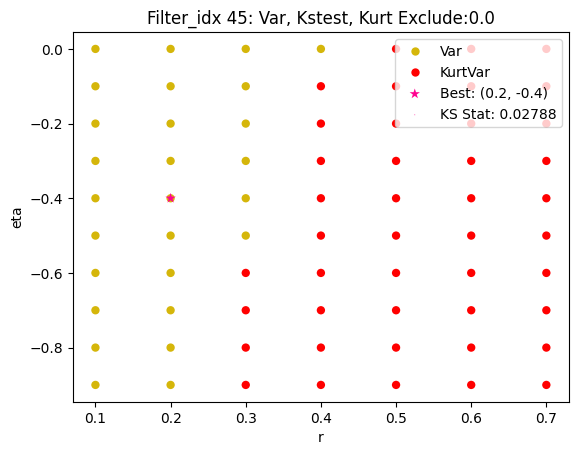

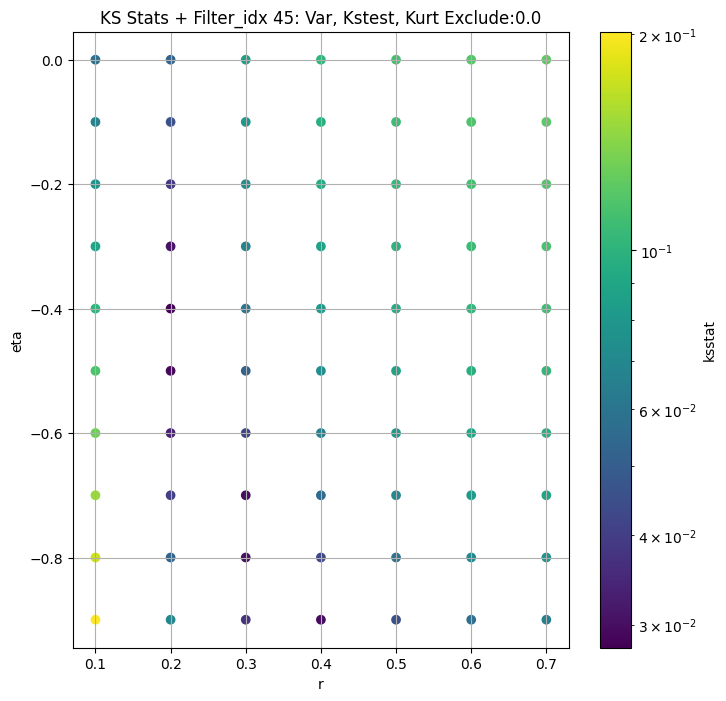

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.03793862024227679 24.26179300739225


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.037314840641508695 22.194218670910903


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.03713284369878722 21.21491605276852


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.03701379924370446 19.833427177353872
Number of samples: 100000, Without approximation : 480000000.0


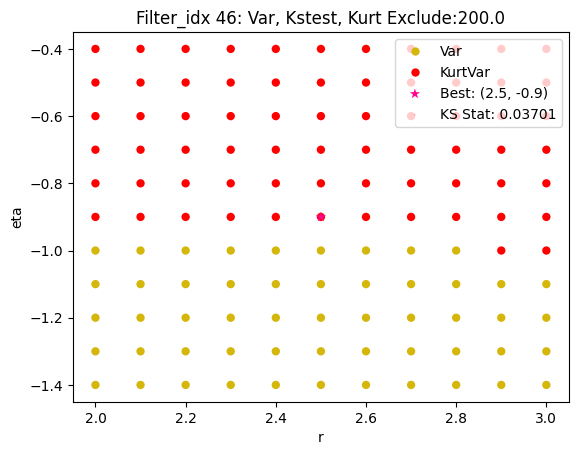

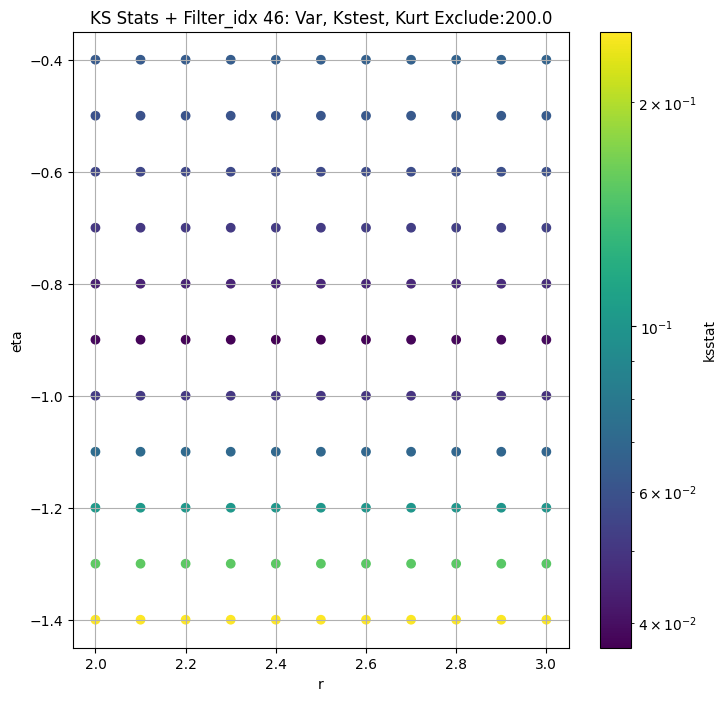

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.012975199617537125 46.93459430100687


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.012990567792901864 43.08764441061171


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.013234168153905213 41.138514892434955


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.012819855677784098 38.30260510846674
Number of samples: 100000, Without approximation : 480000000.0


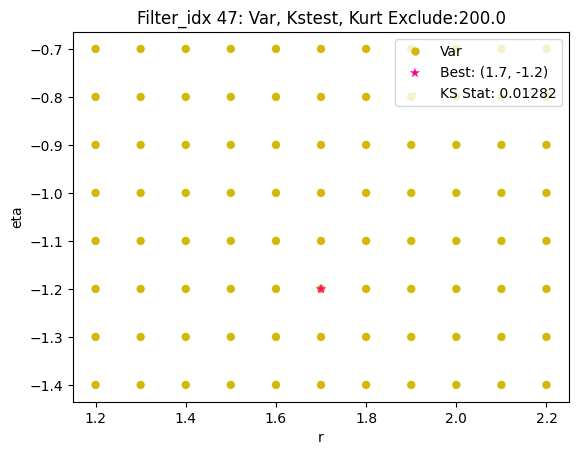

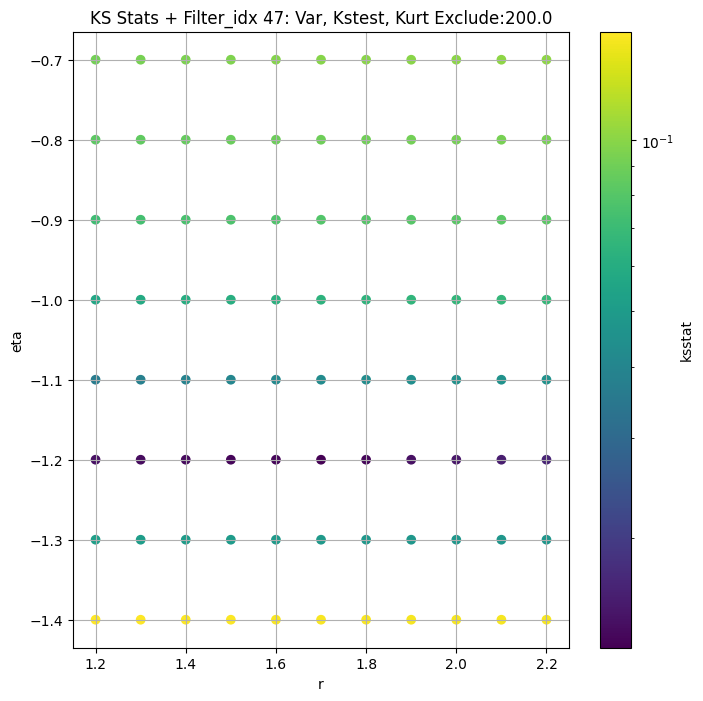

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.011474167023506676 18.0165819166905


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.011103916402856406 15.338555091335573


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.012678745246277545 14.279865510446932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.012690178189714518 12.865895366048296
Number of samples: 100000, Without approximation : 480000000.0


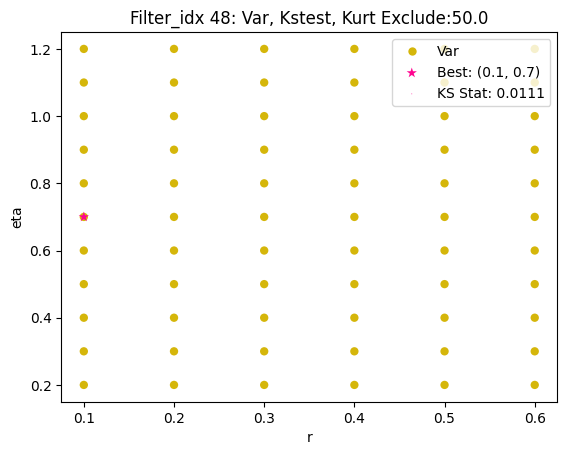

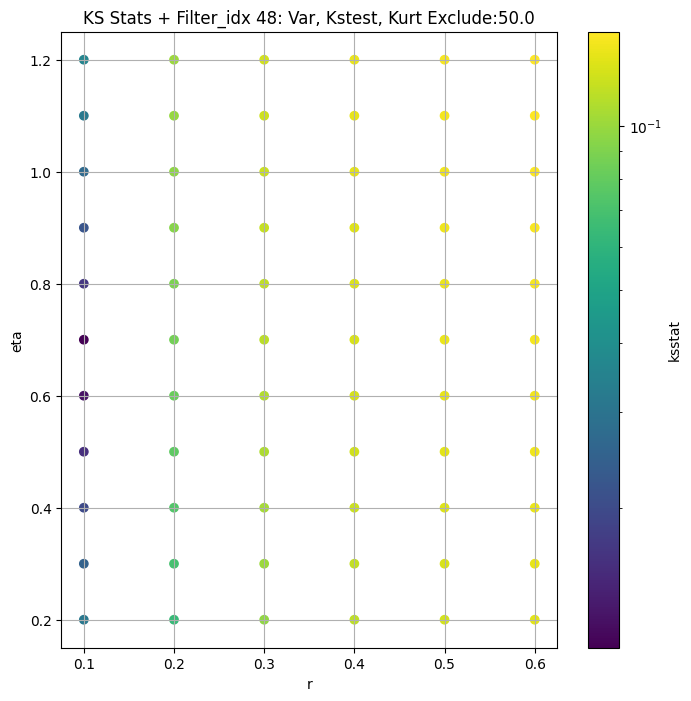

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.01531971413669797 69.44232218976379


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.018569981470206276 60.259796344138515


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.01969843381194547 56.14722669040746


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.021243974974649582 50.53991092732582
Number of samples: 100000, Without approximation : 480000000.0


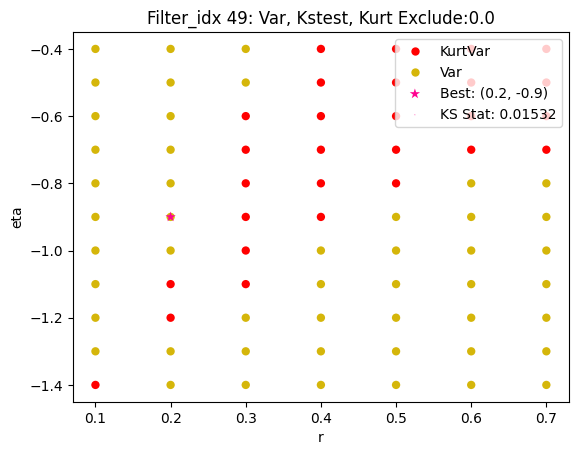

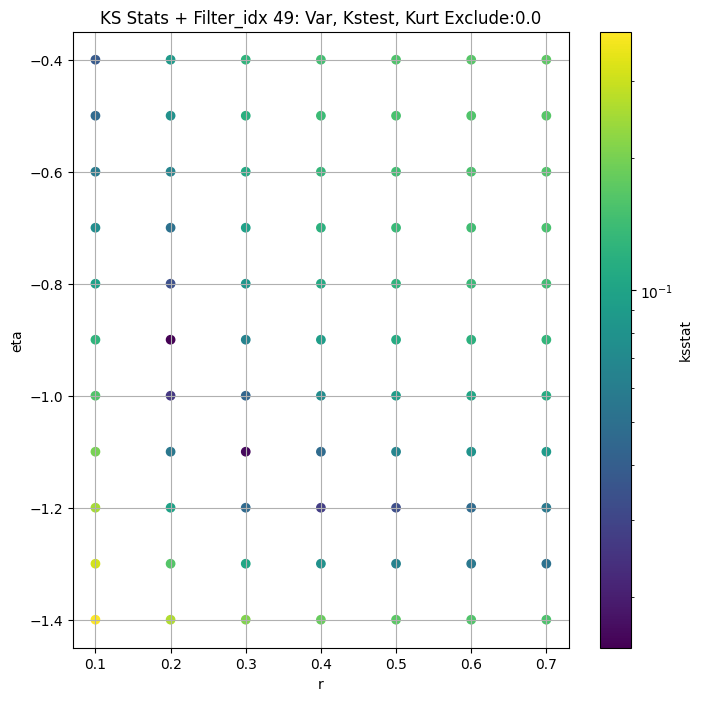

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.018573397260470914 53.79102487969156


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.022445818372186288 46.88118193834001


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.020493155164772292 44.04844886658286


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.019207315149594117 40.17148951564985
Number of samples: 100000, Without approximation : 480000000.0


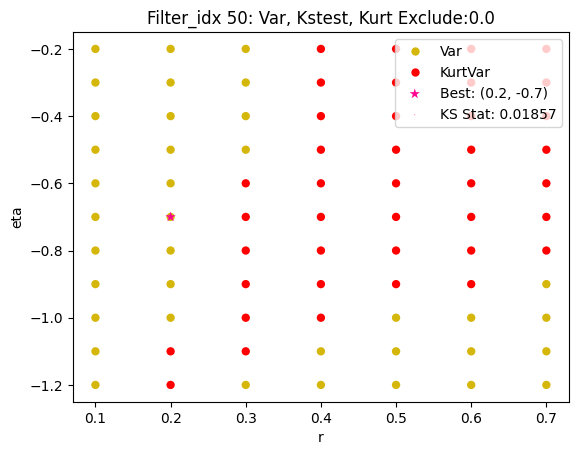

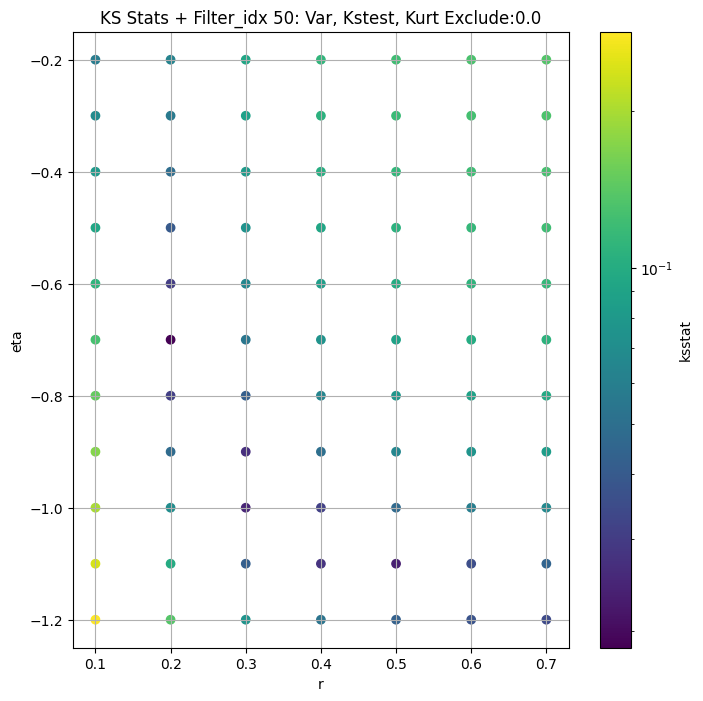

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.021286220884167262 39.61305712978559


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.02127215541139127 36.884482036710935


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.021271949046347494 35.56373557204745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.021271041946196723 33.732738884215486
Number of samples: 100000, Without approximation : 480000000.0


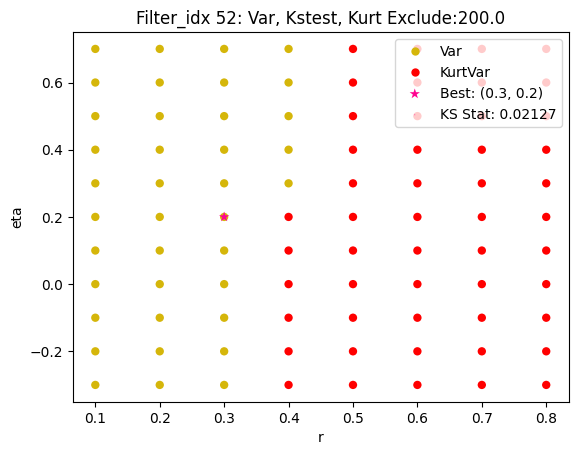

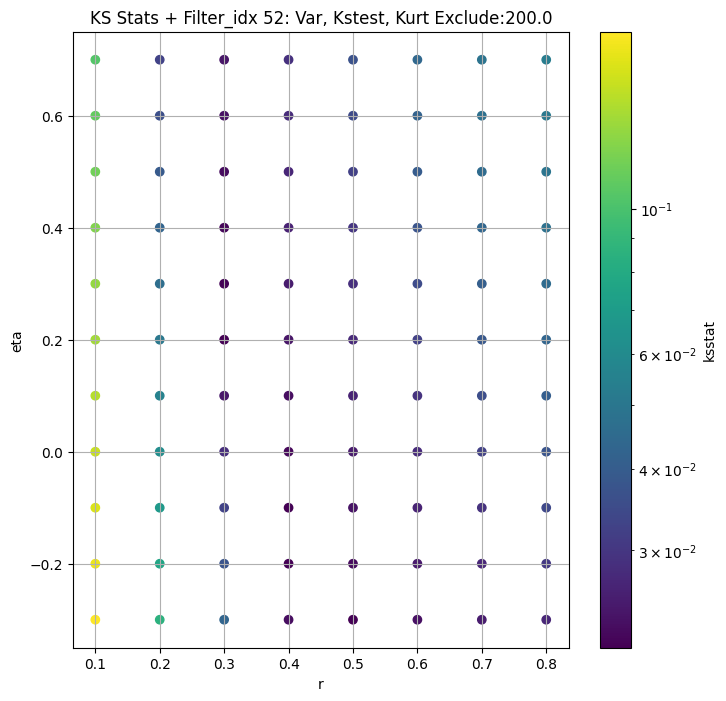

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.00462253378106714 5.910095395399763


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.003779835280774857 4.937975713401619


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.005368723290633481 4.632621780396664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.006123787861727459 4.238296932691712
Number of samples: 100000, Without approximation : 480000000.0


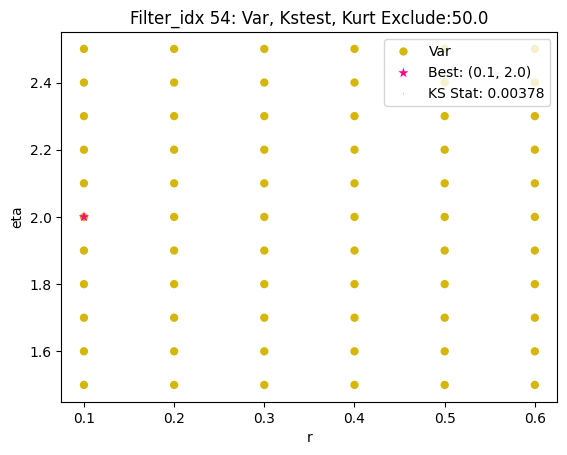

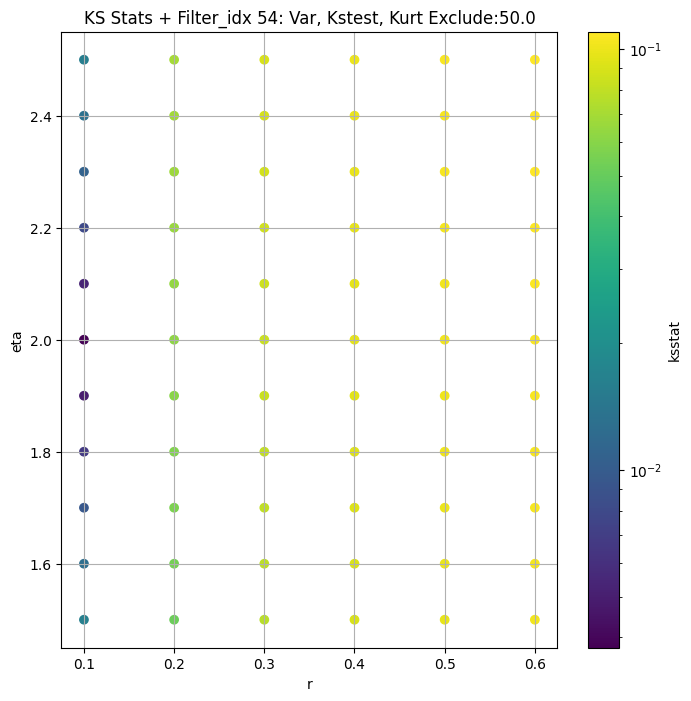

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.008696200783746555 28.245968155496502


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.008725767342106061 23.525398226135323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.009209259687495586 21.823147384402056


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.010387498966780373 19.61504775111583
Number of samples: 100000, Without approximation : 480000000.0


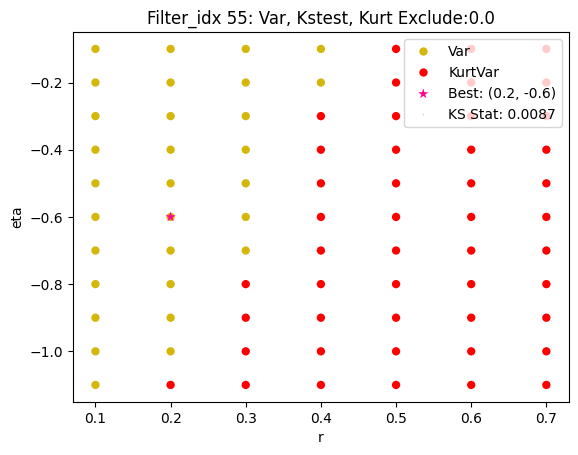

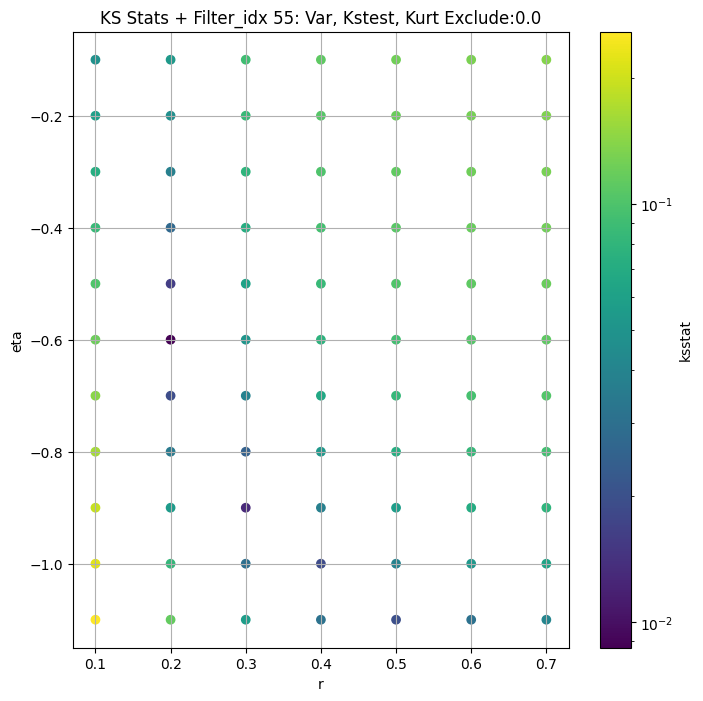

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.015391829728821693 61.738980325914646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.015207435676164588 54.37577618033677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.017523414873290122 51.014249543138554


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.018286808015671063 46.37191742876762
Number of samples: 100000, Without approximation : 480000000.0


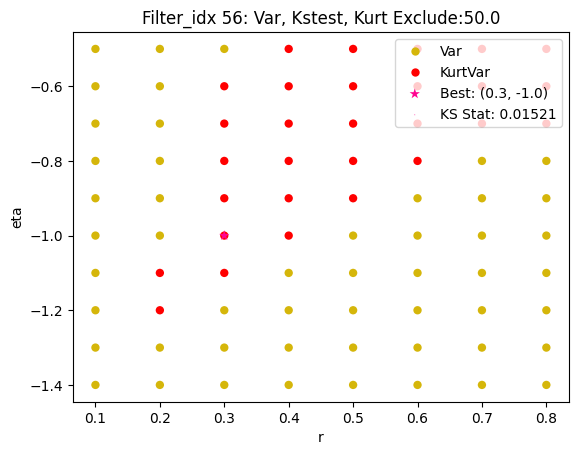

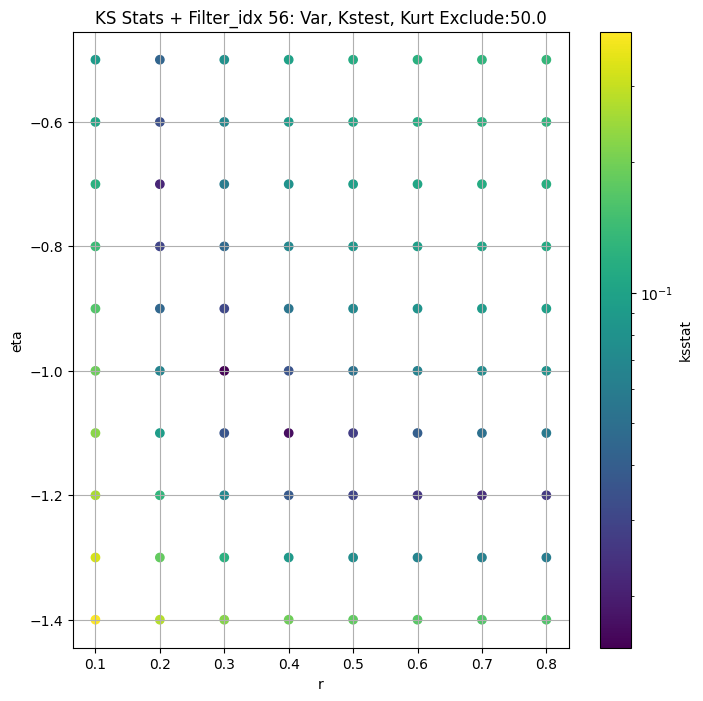

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.015219226593264079 46.4092453378672


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.010662588061115419 40.22581761511787


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.011597445309391718 37.68715067188307


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.012634310408300431 34.25492723936792
Number of samples: 100000, Without approximation : 480000000.0


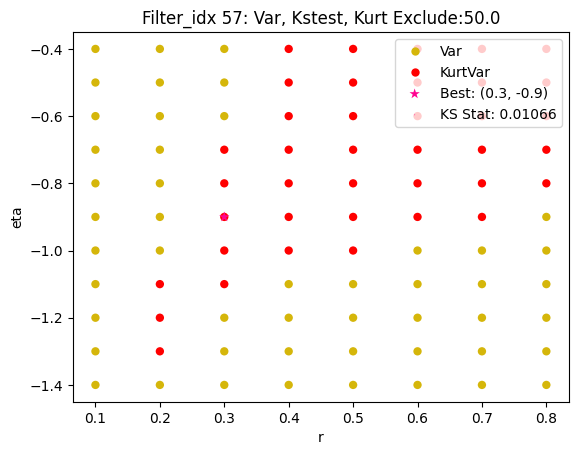

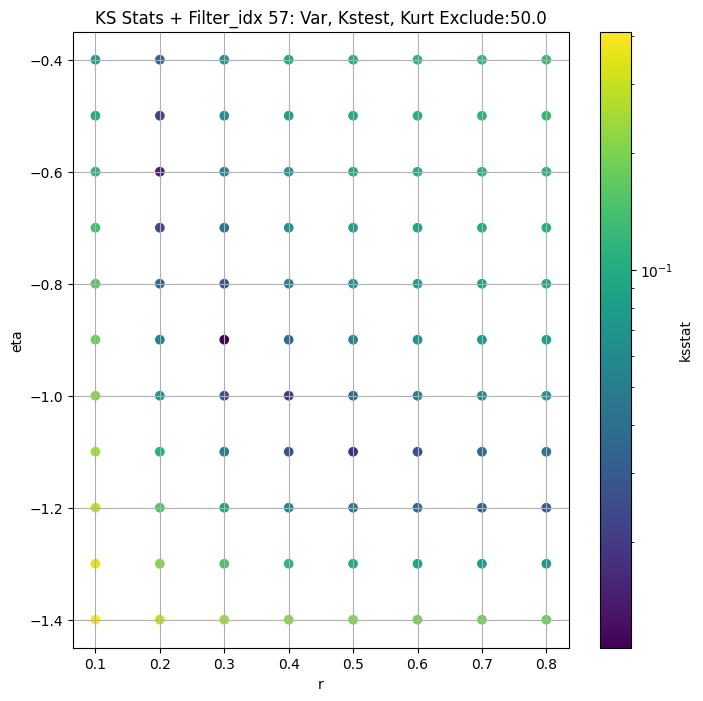

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.024207921816288835 20.315382582668345


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.022755981319384555 18.920781805264234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.021973128821598353 18.271282440926644


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.02099931495303392 17.35293239050904
Number of samples: 100000, Without approximation : 480000000.0


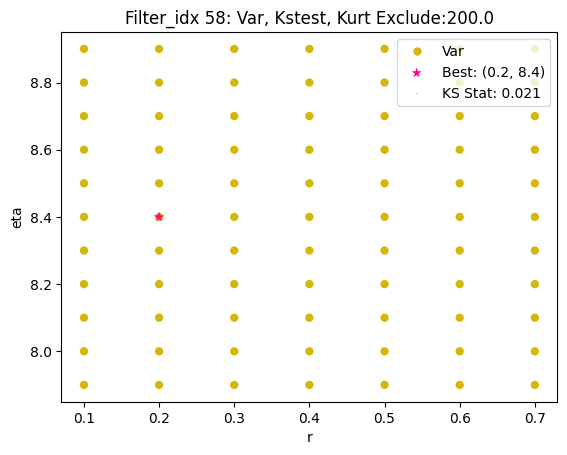

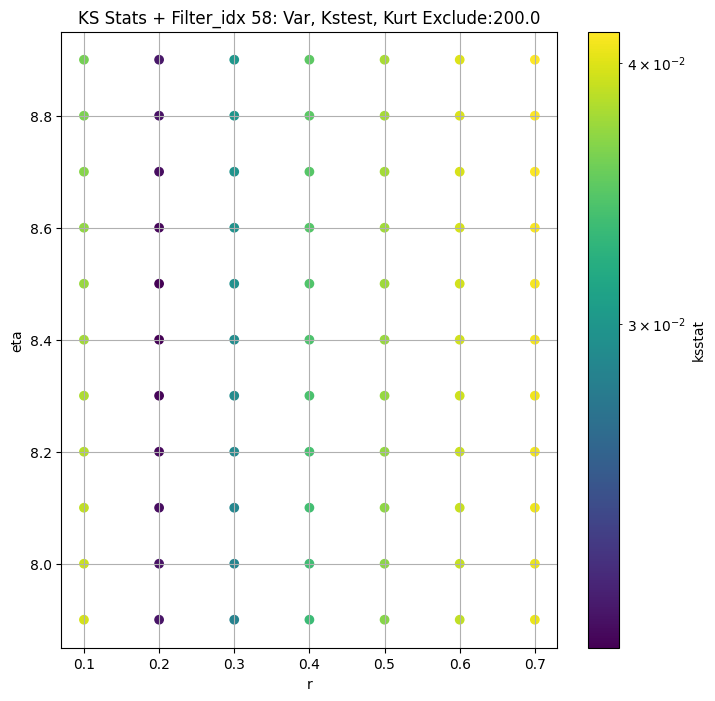

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.016616652777209973 71.705622302549


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.015628156370921964 65.03620316881579


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.014476043597255517 61.77055583394157


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.01488192722600798 57.100124148489144
Number of samples: 100000, Without approximation : 480000000.0


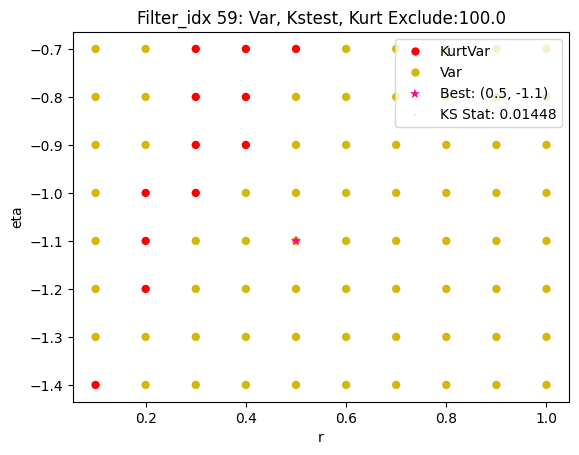

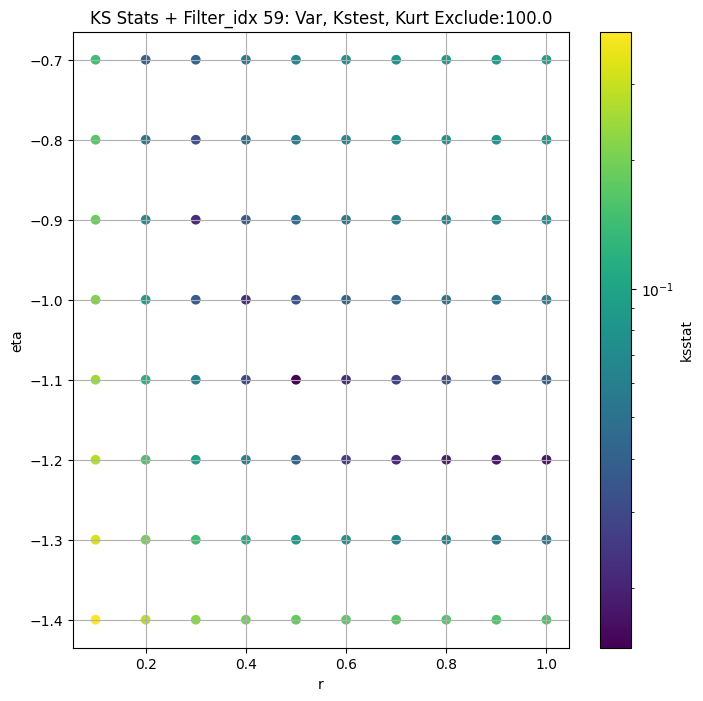

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.009977346365001805 4.826455507626006


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.00842336059627291 4.198374725200917


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.007828209044727807 3.971012642173954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.00739814203610778 3.667592926536633
Number of samples: 100000, Without approximation : 480000000.0


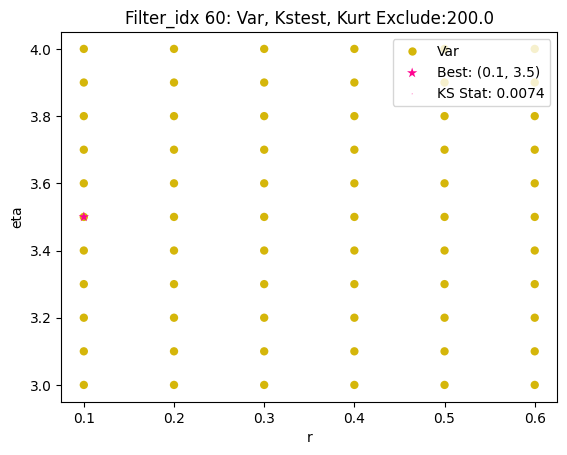

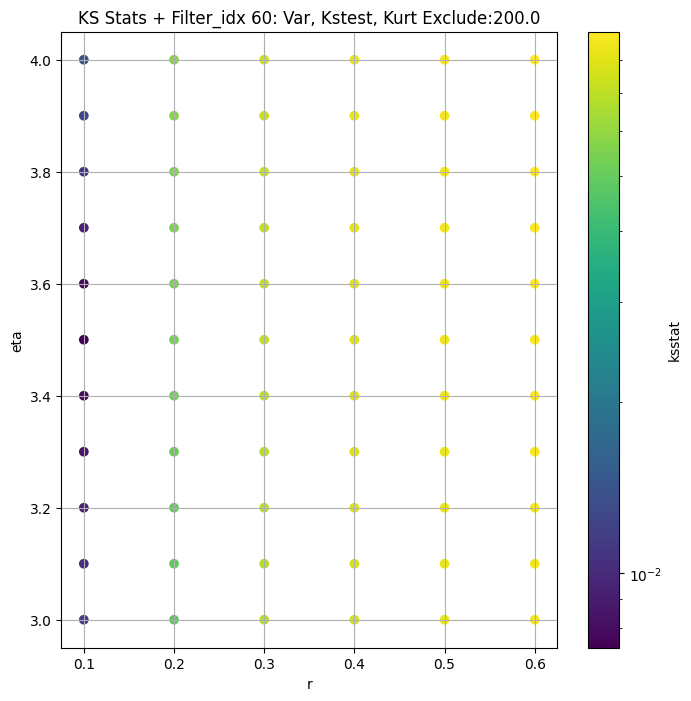

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.013731371494592248 18.599342555035143


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.013794936022613169 16.317119592029073


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.01074348195689756 15.373639728841216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.015192059644349928 14.078150129858507
Number of samples: 100000, Without approximation : 480000000.0


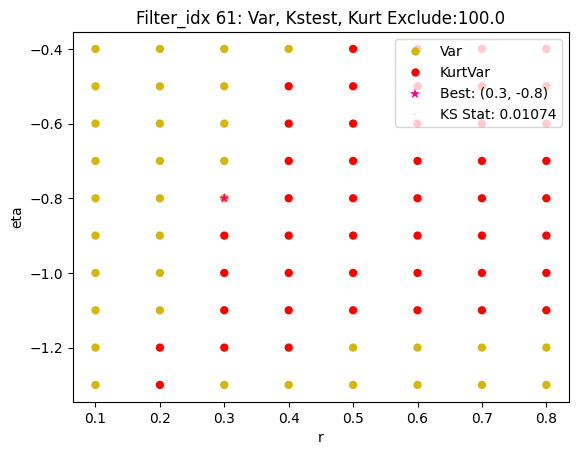

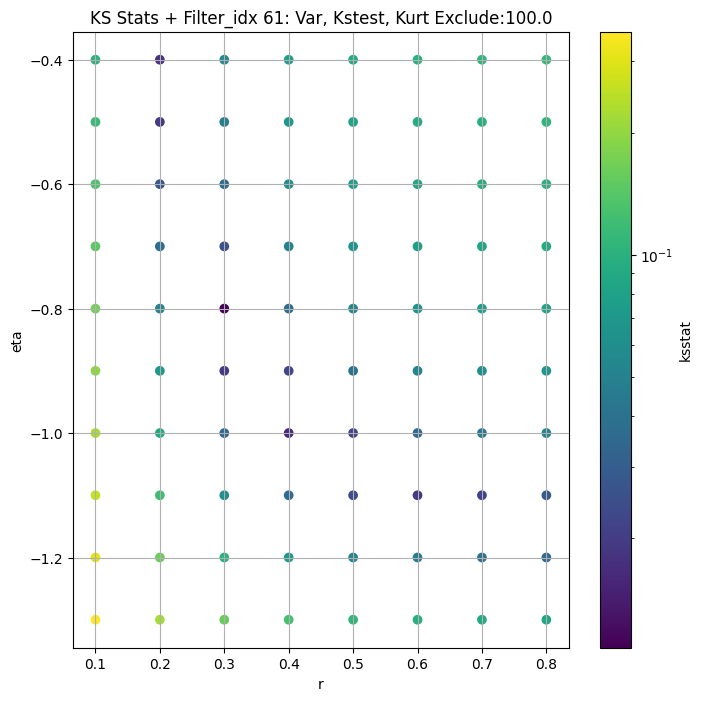

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.03171336481944714 58.03867676431666


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.03195312594740124 52.724263336609084


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.03213727734433858 50.1536358265829


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.032546239900039964 46.47290812097026
Number of samples: 100000, Without approximation : 480000000.0


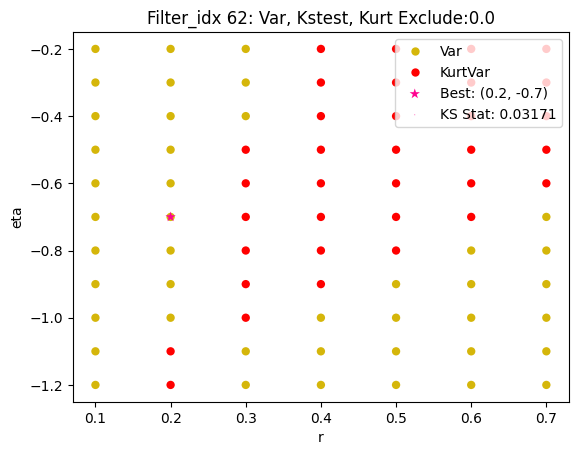

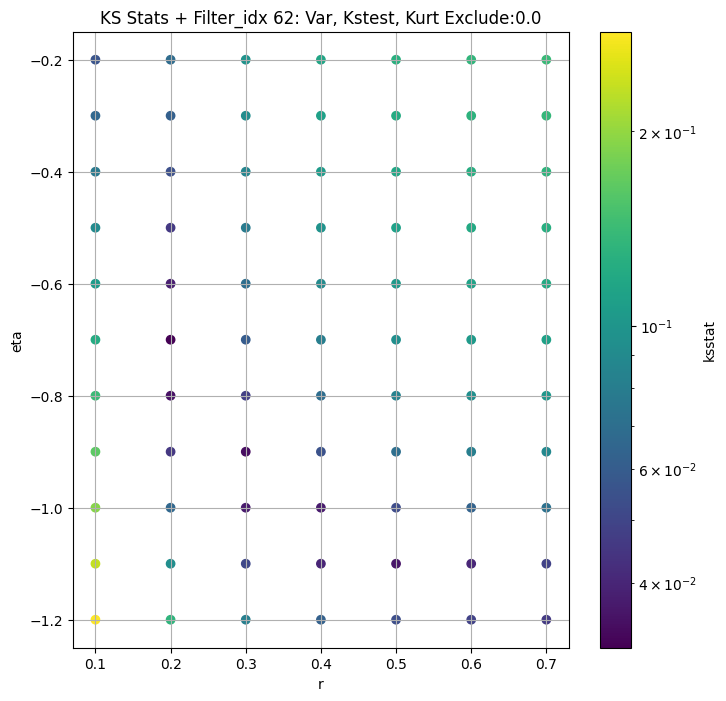

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.006218611280646491 14.228201687632874


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.0036759484871280446 11.758588921122437


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.00405827362728009 10.954213091615797


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.005131634313501242 9.928836739870354
Number of samples: 100000, Without approximation : 480000000.0


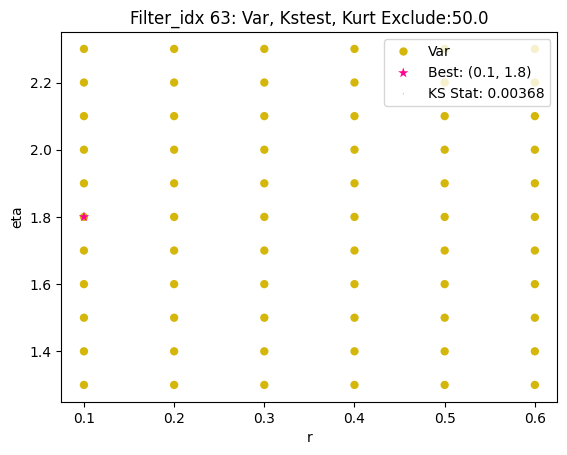

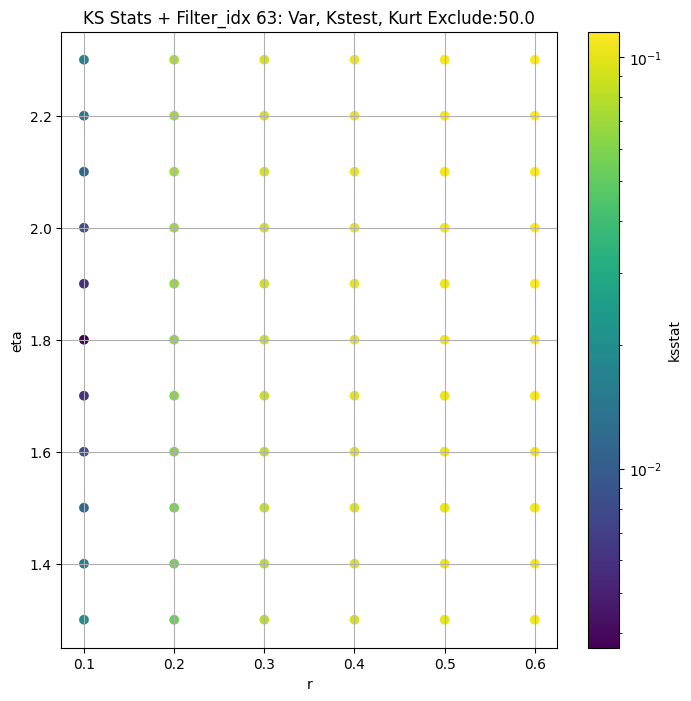

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,53.276510,33.872886,152.802713,68.874435,7.629437,437.942804,480000000.0,dual_color,0.025803,0.2,-0.5,3.523579e-03,0.0,53.276510,0.000062
2,72.914954,46.840640,194.994765,70.467031,8.488360,409.581182,480000000.0,dual_color,0.015952,0.2,-0.8,1.726628e-02,0.0,72.914954,0.000062
3,21.122359,13.977334,48.453006,60.386705,7.087002,367.258826,480000000.0,single_edge,0.006576,0.2,-0.5,1.396981e-03,0.0,21.122359,0.000062
4,87.957409,60.473776,142.215733,21.750371,7.542111,108.327211,480000000.0,dual_color,0.014571,0.3,-1.0,2.848052e+00,100.0,75.717095,0.000062
5,55.207904,39.862001,87.753125,16.862899,5.354291,133.778512,480000000.0,dual_color,0.025055,0.4,-1.0,1.131375e+01,0.0,55.207904,0.000062
6,40.185553,25.679989,105.328409,60.163445,6.741069,394.752770,480000000.0,single_edge,0.015931,0.4,-1.0,6.174842e+00,200.0,30.131485,0.000062
7,22.804529,16.940818,43.045728,22.371653,3.175920,204.336144,480000000.0,inside_out,0.029699,0.2,2.5,3.724690e-06,200.0,18.997708,0.000062
8,1.781040,1.258188,6.086729,120.835038,3.632314,537.290190,480000000.0,misc,0.014081,0.1,5.0,5.344107e-19,200.0,1.393185,0.000062
9,8.497680,4.809712,79.841307,1072.609333,6.218030,802.832624,480000000.0,multi_edge,0.003632,0.1,1.2,9.212643e-15,0.0,8.497680,0.000062


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.02580719572066459, var: 43.461289405666456


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.025800070188341462, var: 44.73394388446415


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.025800057479344107, var: 46.25661439658976


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.025820743671803148, var: 48.23290158659176


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.025802814503554705, var: 53.276510482134775
Number of samples: 100000, Without approximation : 480000000.0


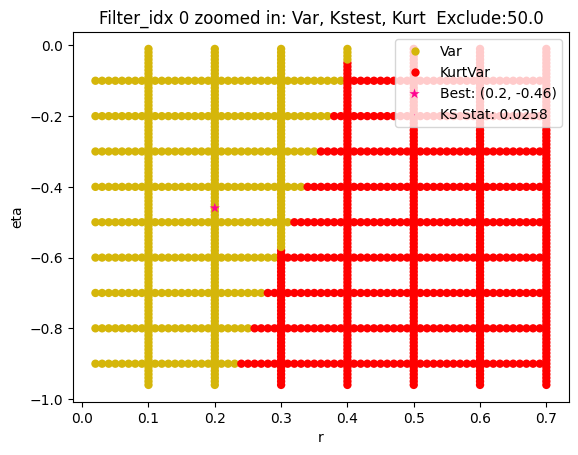

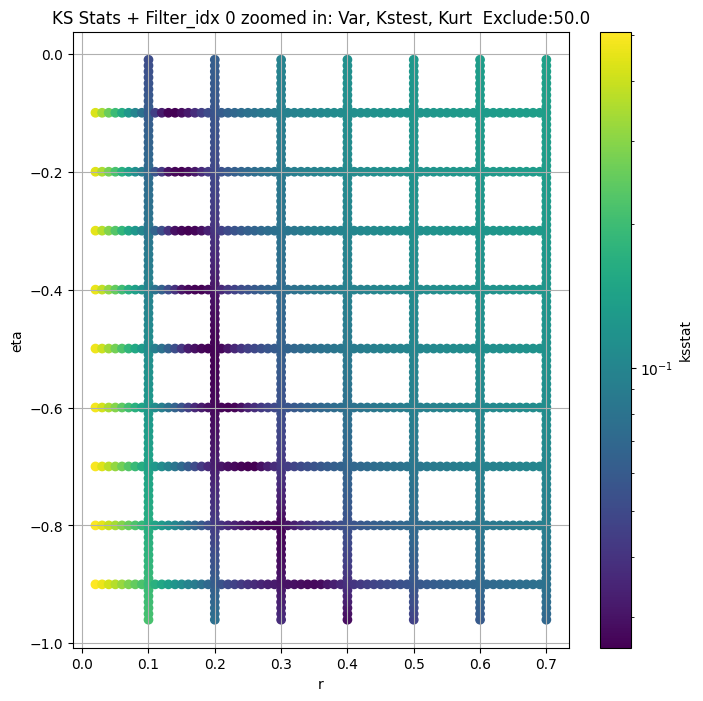

Filter_idx 2


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.014263197721856885, var: 59.149630366031694


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.013890969649646423, var: 60.96336715621326


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.013646270229504154, var: 63.118028615210235


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.014252317572108542, var: 65.89182547047272


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.012901174541165655, var: 72.9149543891323
Number of samples: 100000, Without approximation : 480000000.0


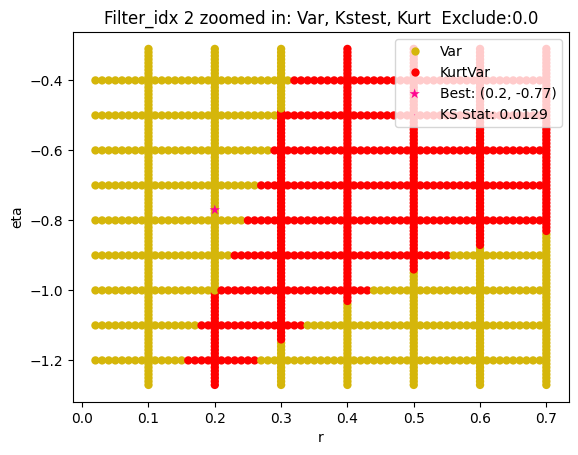

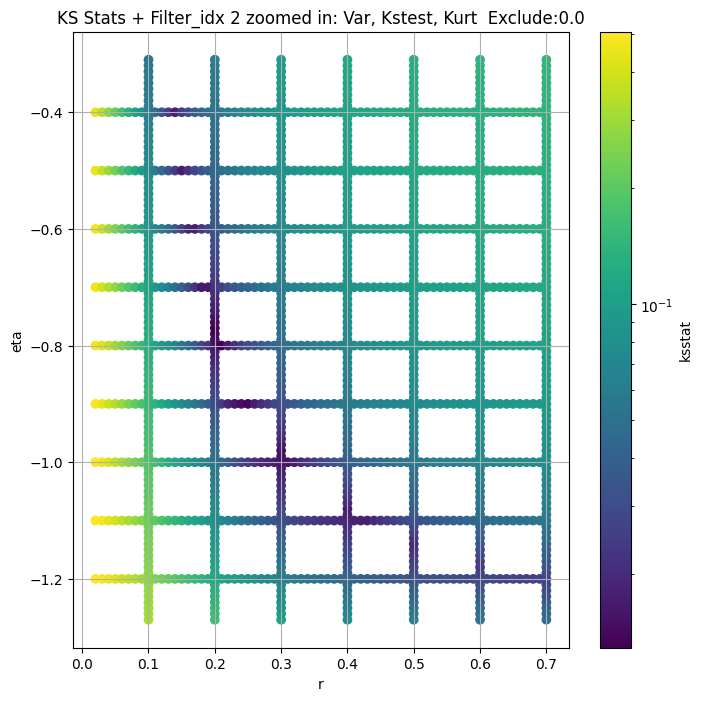

Filter_idx 3


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.008246706156274652, var: 17.214602652449333


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.00782529409173005, var: 17.72666151732009


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.00847476106769729, var: 18.339971717243493


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.007783406901744616, var: 19.137995679956397


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.006575931485040543, var: 21.122358538745
Number of samples: 100000, Without approximation : 480000000.0


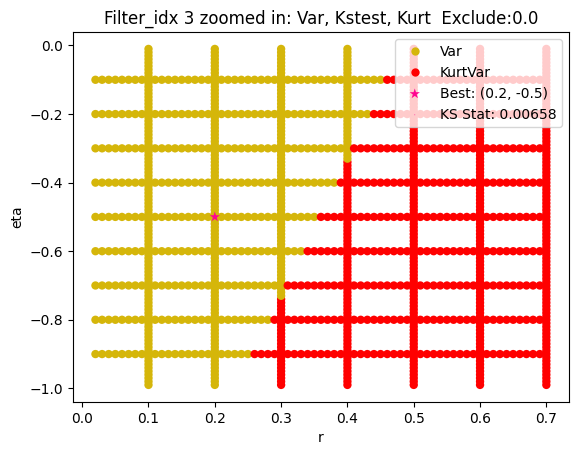

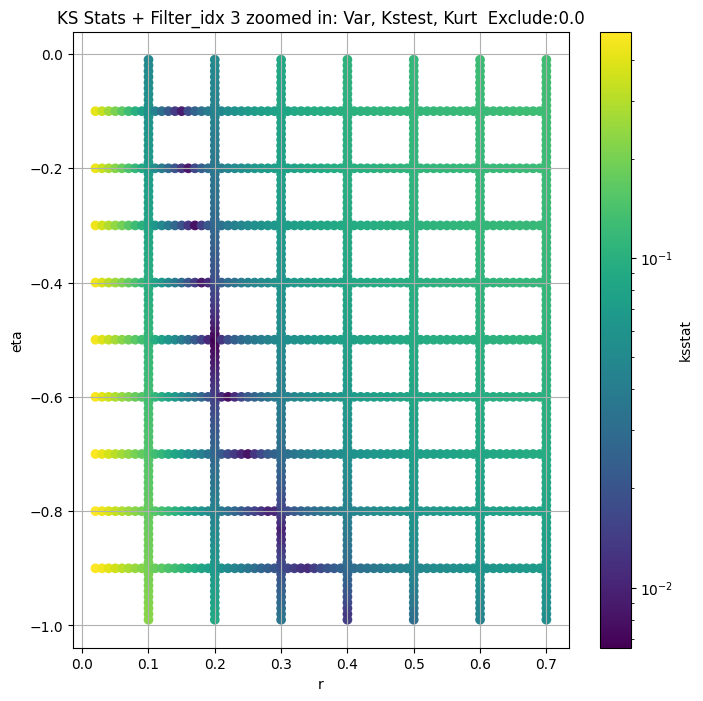

Filter_idx 4


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.01598138651490466, var: 69.60817303087032


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.015760596094147802, var: 70.95636702310773


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.014931319003829949, var: 72.40686888768413


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.014896585553637473, var: 73.98237943837364


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.014571215547307226, var: 75.71709479850512


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.014183746382727264, var: 77.66638308230756


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.013821485195900762, var: 79.92977719255323


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.013602514298323931, var: 82.73384480468019


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.014169058844066051, var: 87.95740886669597
Number of samples: 100000, Without approximation : 480000000.0


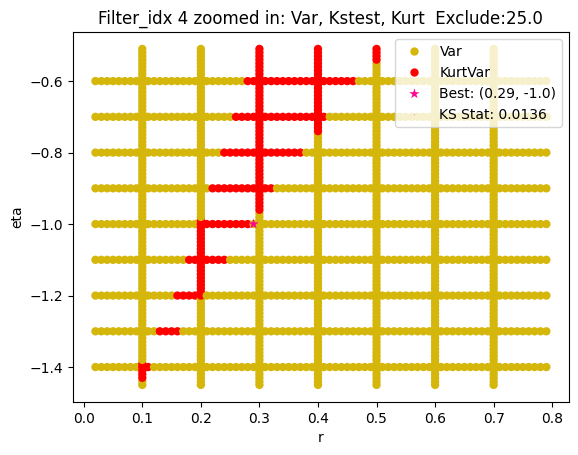

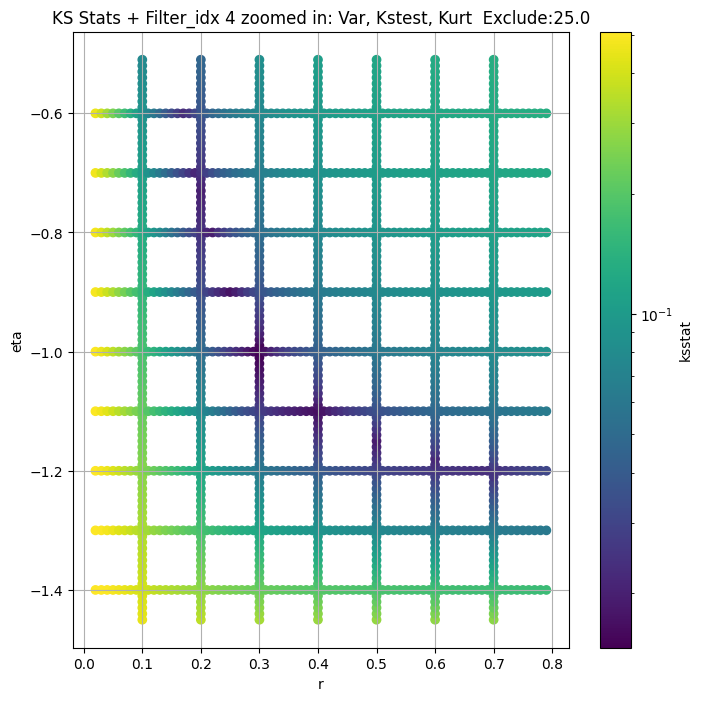

Filter_idx 5


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.025046842946048198, var: 48.72254755846359


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.025000741534639825, var: 49.728418729071585


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.02493214777785413, var: 50.89694766910578


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.02502150628347699, var: 52.352935567205755


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.02505461660638142, var: 55.20790368051543
Number of samples: 100000, Without approximation : 480000000.0


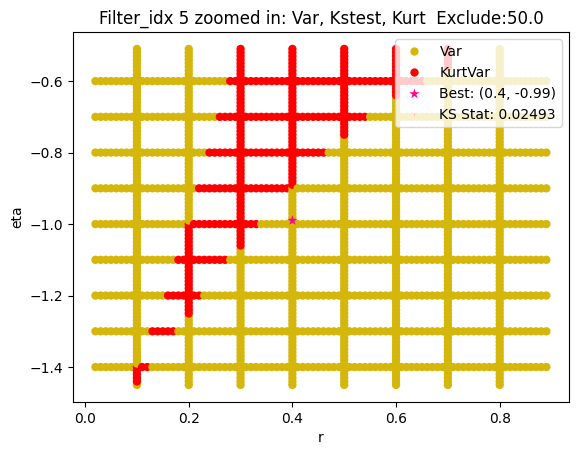

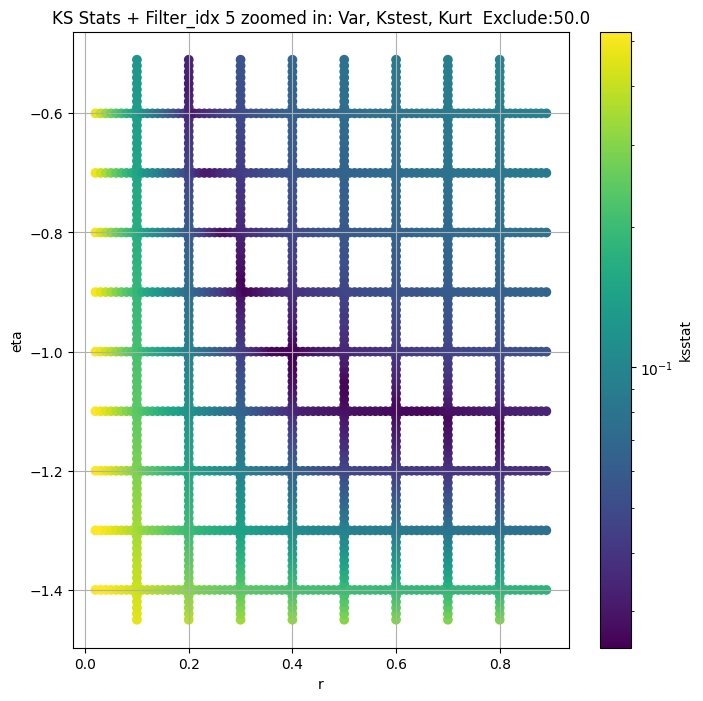

Filter_idx 6


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + 100 = 300, ksstat: 0.015283724643945062, var: 28.044766446547033


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + 75 = 275, ksstat: 0.015830008793796257, var: 28.518842933134565


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + 50 = 250, ksstat: 0.01567102168510226, var: 29.021607679153142


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + 25 = 225, ksstat: 0.015307034659527374, var: 29.557324372410225


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + 0 = 200, ksstat: 0.014828784533768569, var: 30.13148473250982


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + -25 = 175, ksstat: 0.01456025552706841, var: 30.751246725811


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + -50 = 150, ksstat: 0.014544031954172532, var: 31.426068151705415


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + -75 = 125, ksstat: 0.01433632222435094, var: 32.16945477733862


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 6, 200.0 + -100 = 100, ksstat: 0.01414405299937549, var: 33.0014501618506
Number of samples: 100000, Without approximation : 480000000.0


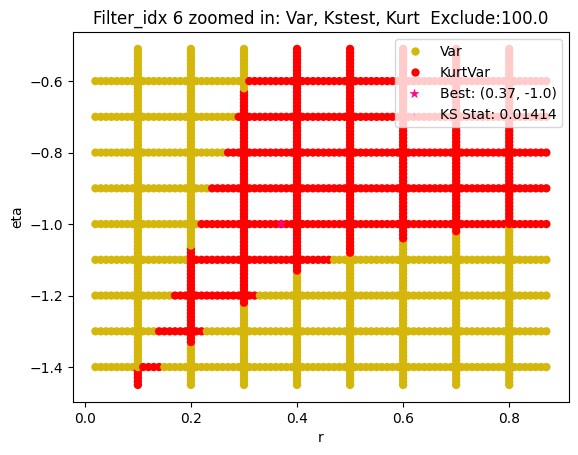

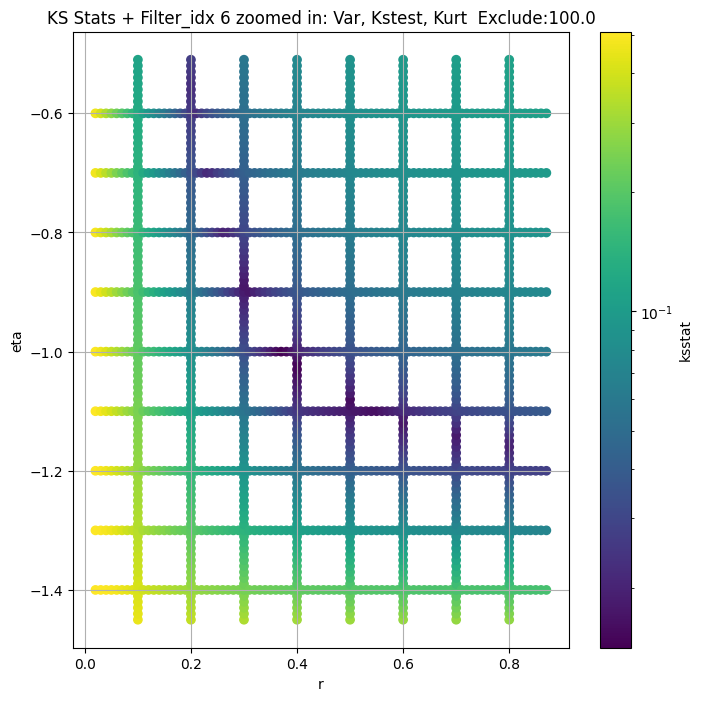

Filter_idx 7


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 100 = 300, ksstat: 0.029708194510861263, var: 18.141351699753738


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 75 = 275, ksstat: 0.029631908286261388, var: 18.33794031341658


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 50 = 250, ksstat: 0.029669253646575244, var: 18.545125421022135


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 25 = 225, ksstat: 0.02964848637770212, var: 18.76440784827829


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 0 = 200, ksstat: 0.02969948034811809, var: 18.997707621416566


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -25 = 175, ksstat: 0.029639456321846724, var: 19.2475615367647


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -50 = 150, ksstat: 0.029662146243326304, var: 19.517364909671098


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -75 = 125, ksstat: 0.02982930917319848, var: 19.812076412442487


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -100 = 100, ksstat: 0.02976583628259233, var: 20.13901215652379
Number of samples: 100000, Without approximation : 480000000.0


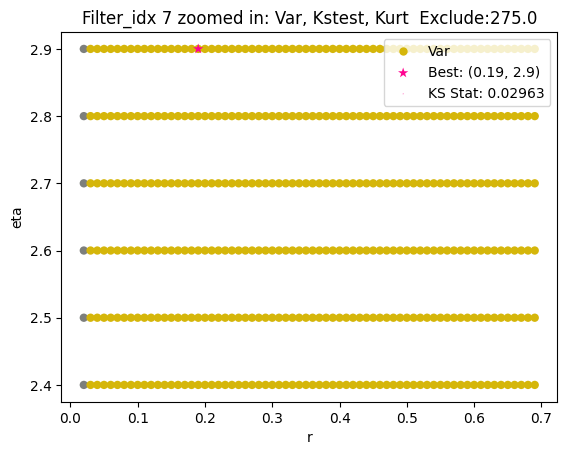

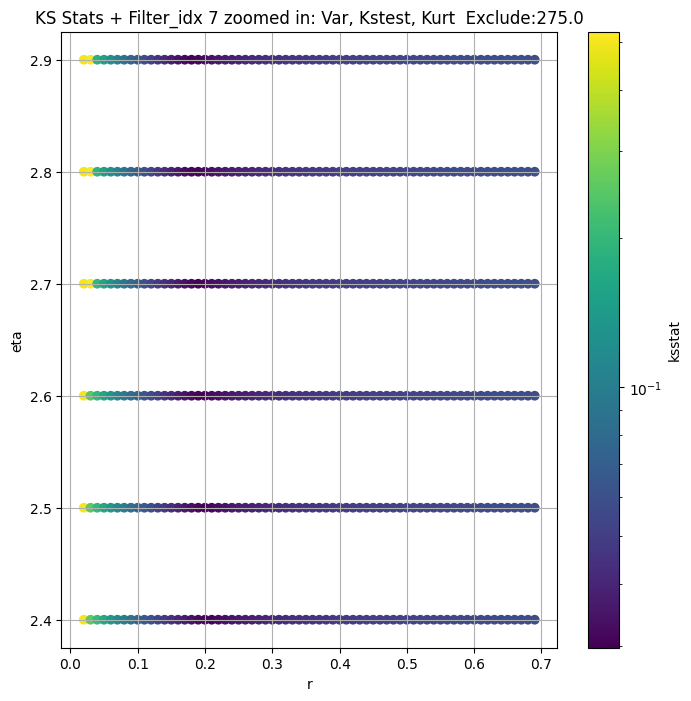

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.01407951998887813, var: 1.3242007468972512


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.014085551351327275, var: 1.3399632481093966


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.014096827728715566, var: 1.356616990888921


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.01408718619120164, var: 1.37429996963168


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.014081288723968854, var: 1.3931847236325126


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.01408446993394119, var: 1.4135003078829353


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.01409531341342296, var: 1.4355600381268014


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.01409937569532671, var: 1.4598088073712423


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.014093510598858938, var: 1.4869197676143786
Number of samples: 100000, Without approximation : 480000000.0


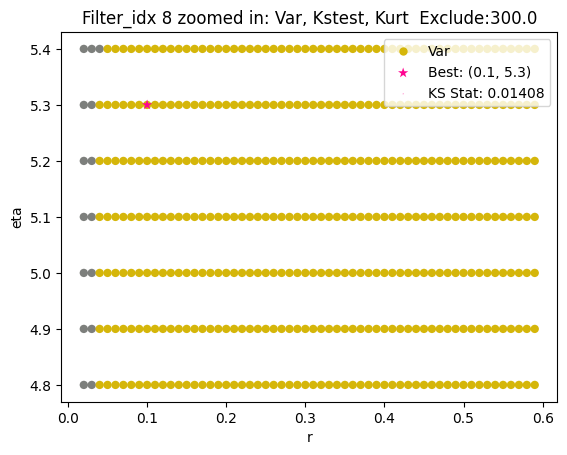

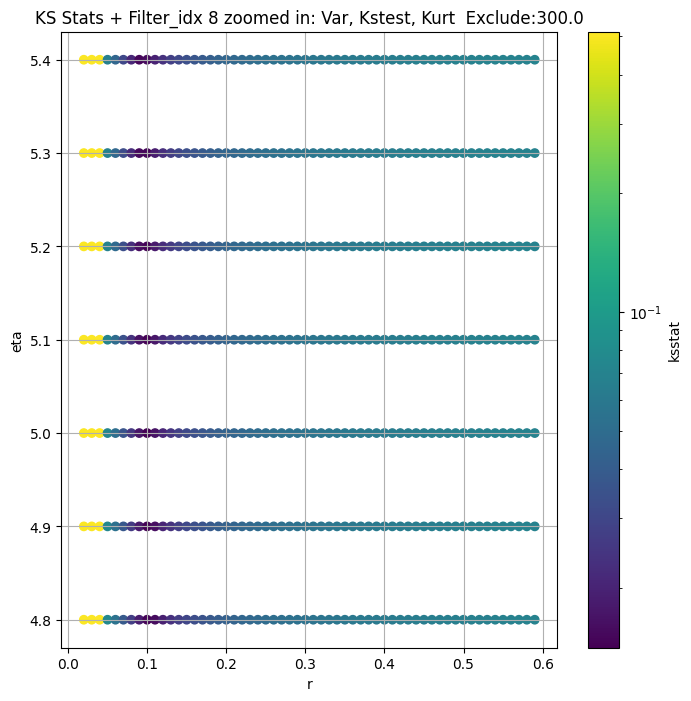

Filter_idx 9


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 0.0 + 100 = 100, ksstat: 0.0055699696701574375, var: 6.020044697333665


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 0.0 + 75 = 75, ksstat: 0.005208792946704802, var: 6.196879087515652


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 0.0 + 50 = 50, ksstat: 0.0049198725460512654, var: 6.413194270426675


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 0.0 + 25 = 25, ksstat: 0.004103890981105959, var: 6.703664326557989


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 0.0 + 0 = 0, ksstat: 0.0036319775009628907, var: 8.497679772193038
Number of samples: 100000, Without approximation : 480000000.0


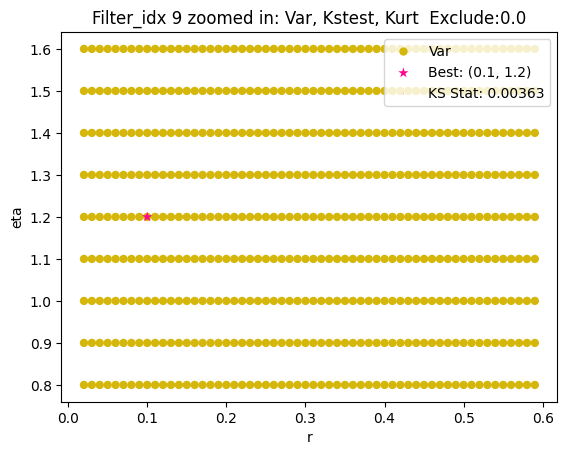

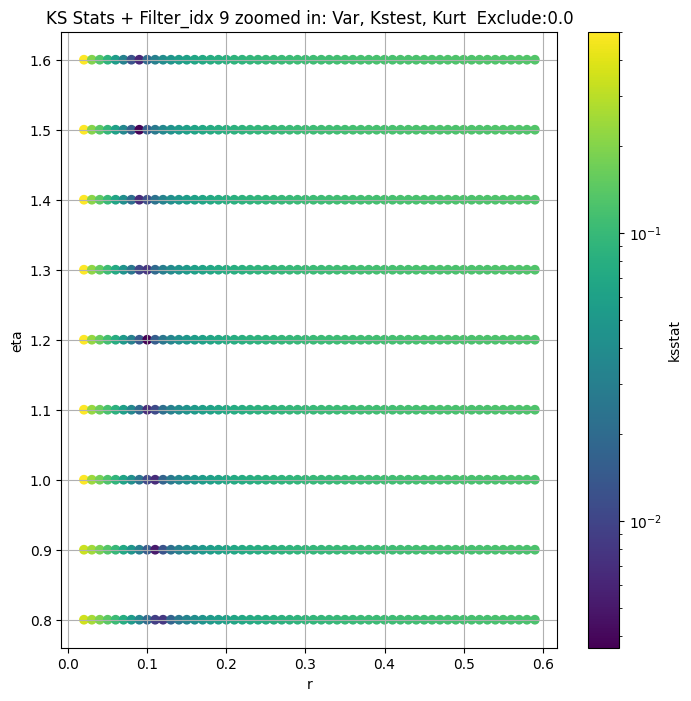

Filter_idx 10


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 100 = 200, ksstat: 0.013200368060947487, var: 25.38468198213574


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 75 = 175, ksstat: 0.013579858139767698, var: 25.891435375011152


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 50 = 150, ksstat: 0.012841276597281404, var: 26.44357152670125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 25 = 125, ksstat: 0.013565293015685431, var: 27.05250407722913


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 0 = 100, ksstat: 0.013300720437830038, var: 27.734977902853274


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -25 = 75, ksstat: 0.013689434529974065, var: 28.518134845006532


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -50 = 50, ksstat: 0.013352382133085539, var: 29.45187265718814


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -75 = 25, ksstat: 0.013511585521653269, var: 30.655182805647254


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -100 = 0, ksstat: 0.0119786039052735, var: 33.37461460247059
Number of samples: 100000, Without approximation : 480000000.0


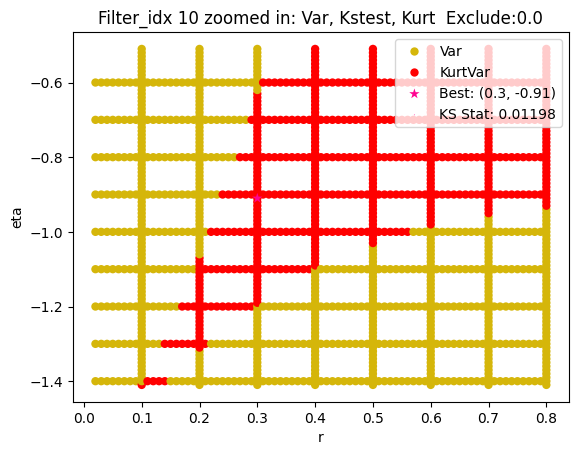

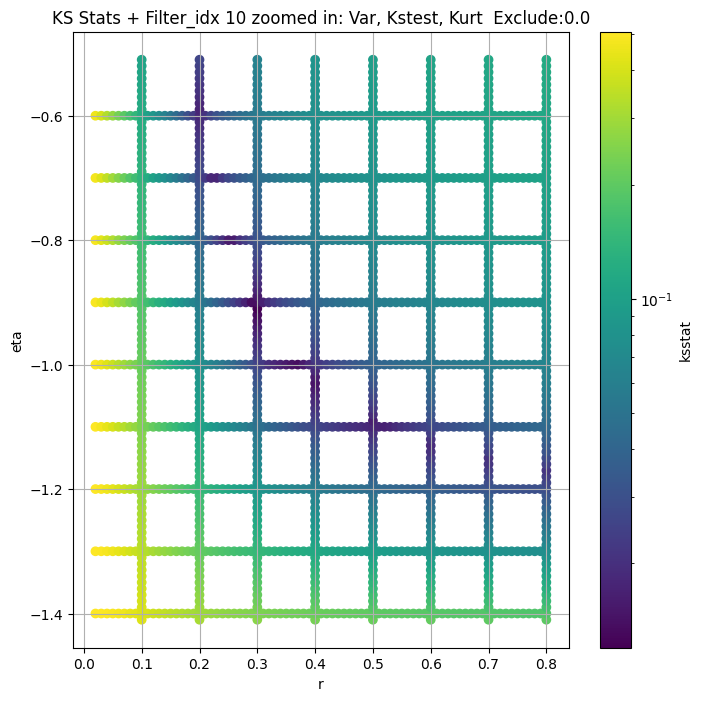

Filter_idx 11


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.013219550188293211, var: 26.27463711317699


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.01387359554790668, var: 27.01350115240891


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.01320722950748883, var: 27.846558089369996


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.012715808199145417, var: 28.809069665850743


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.012617563832569845, var: 29.967909875615256


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.012219968586299479, var: 31.482279420415644


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.012719549449455747, var: 35.6231326704054
Number of samples: 100000, Without approximation : 480000000.0


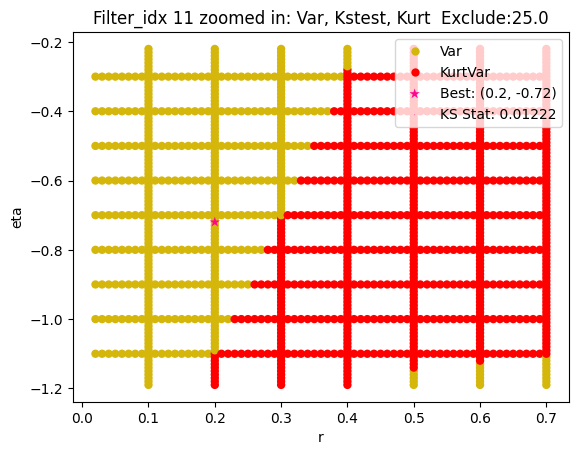

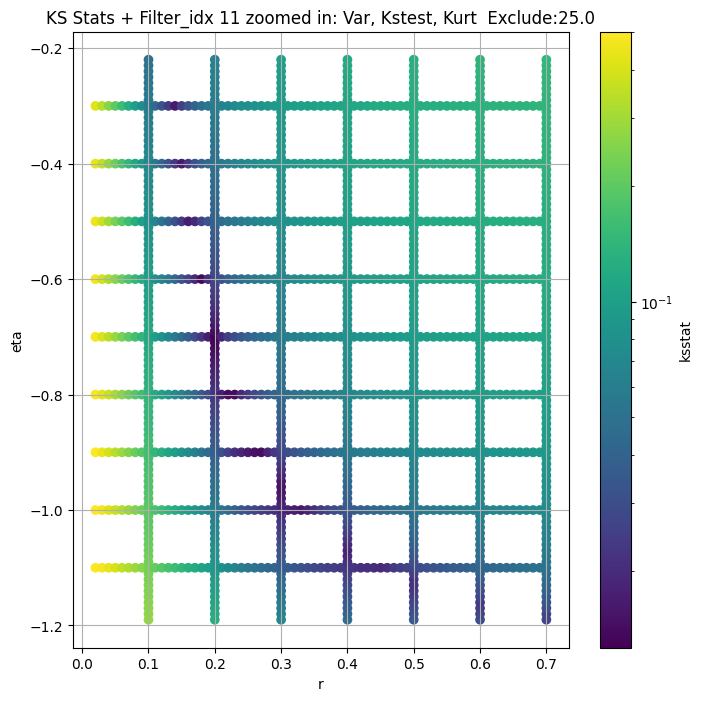

Filter_idx 12


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.009464114607920487, var: 34.830856819316146


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.008309117327192084, var: 35.91817073459768


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.008585379726141706, var: 37.24088575938206


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.007774466346014419, var: 39.00422437802829


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.00826379532840904, var: 43.917231013103276
Number of samples: 100000, Without approximation : 480000000.0


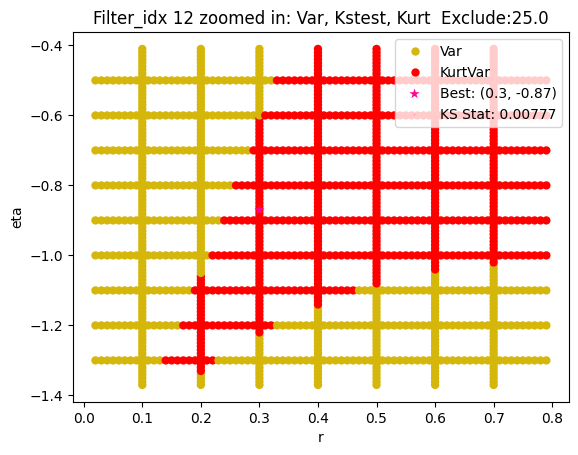

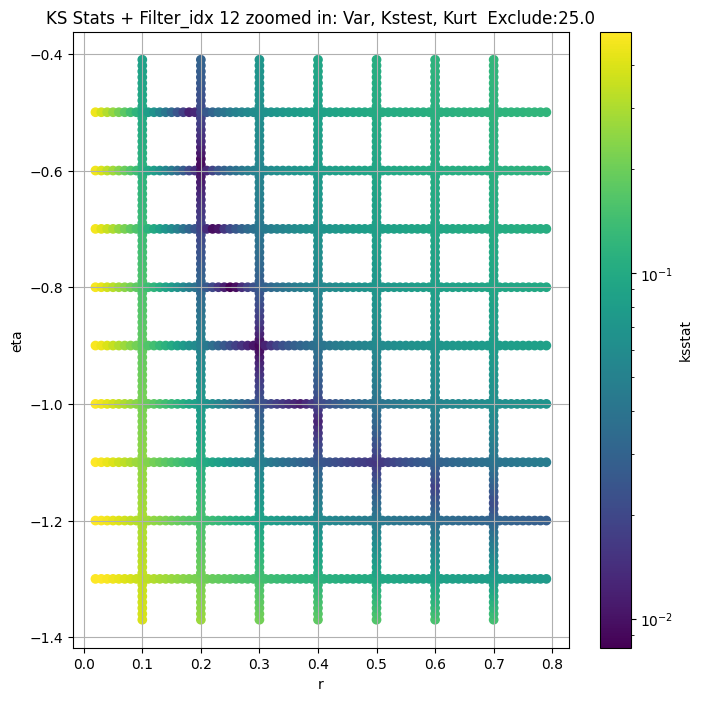

Filter_idx 13


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + 100 = 200, ksstat: 0.009370042309284995, var: 19.79773644820884


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + 75 = 175, ksstat: 0.009441425387177738, var: 20.207958364853457


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + 50 = 150, ksstat: 0.009792617396127246, var: 20.65671659509294


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + 25 = 125, ksstat: 0.008880978393051714, var: 21.15408342399196


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + 0 = 100, ksstat: 0.00902308425163345, var: 21.715201628357498


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + -25 = 75, ksstat: 0.008527006565081319, var: 22.36471260210799


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + -50 = 50, ksstat: 0.008368560638349398, var: 23.150267672165267


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + -75 = 25, ksstat: 0.008024978886515544, var: 24.186989950830064


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 13, 100.0 + -100 = 0, ksstat: 0.008238031160656967, var: 26.80083113292681
Number of samples: 100000, Without approximation : 480000000.0


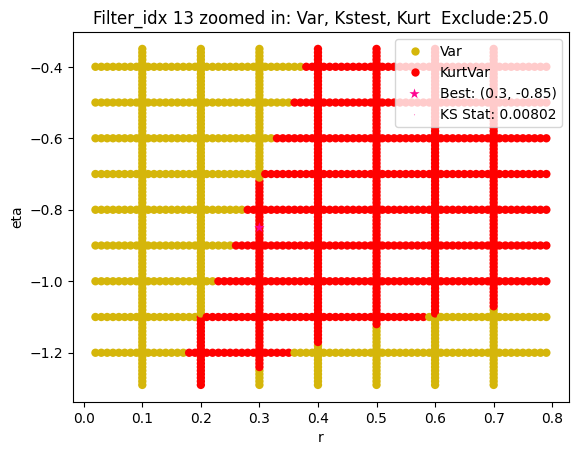

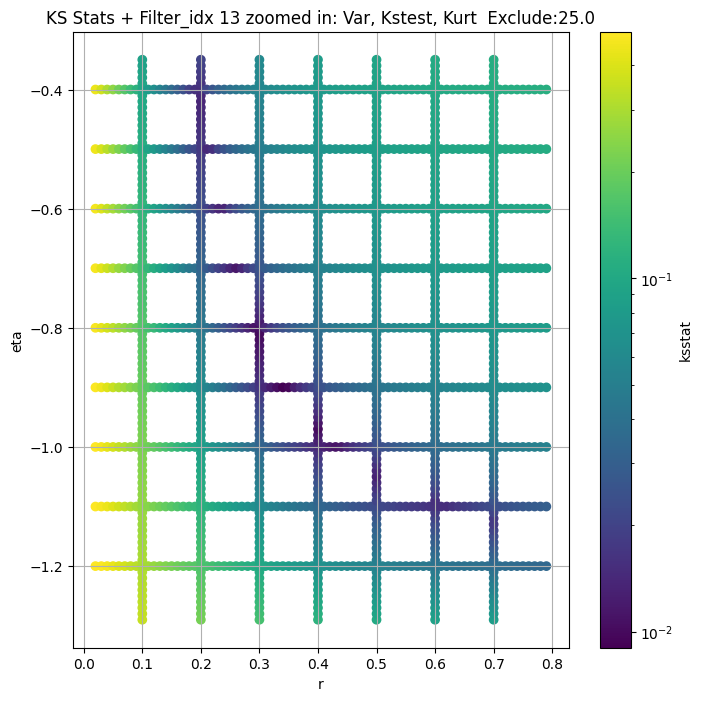

Filter_idx 14


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.016201236543516906, var: 28.7115176875239


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.016069453737486084, var: 29.55115058032759


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.015713610497446018, var: 30.55263883678577


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.015282710976877945, var: 31.845369457560867


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.01599335948478886, var: 34.87331626467633
Number of samples: 100000, Without approximation : 480000000.0


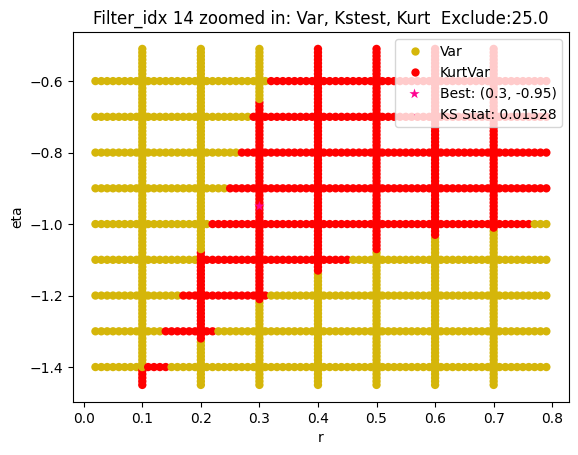

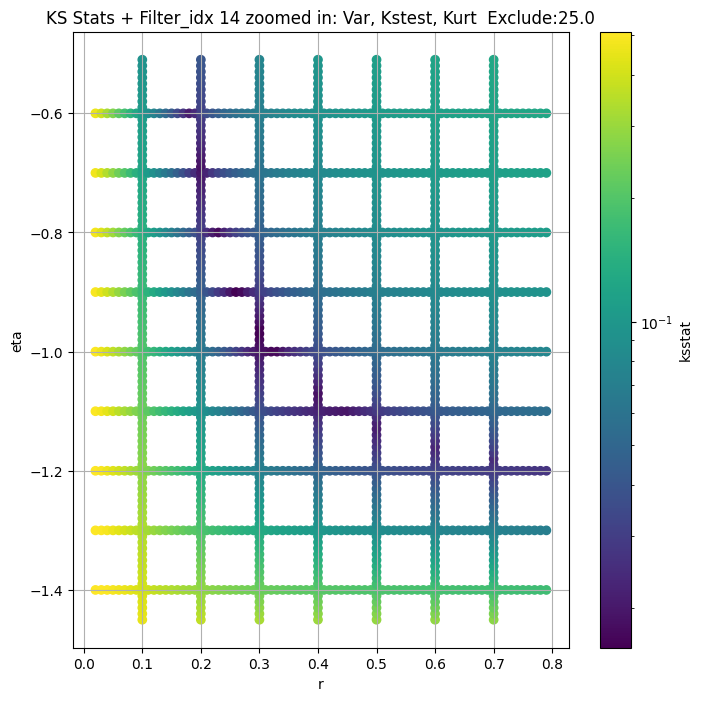

Filter_idx 15


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.01589107098040754, var: 33.75768436884911


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.015887314911982087, var: 34.08187902498456


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.015935232693117696, var: 34.42138603578682


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.01590942788371641, var: 34.779079327379556


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.01599431961699449, var: 35.157793284578936


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.015960619046424207, var: 35.562196118302936


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.016044920242443306, var: 35.99730601836286


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.016005305252258906, var: 36.47052288429863


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.016031522391264874, var: 36.99433502769968
Number of samples: 100000, Without approximation : 480000000.0


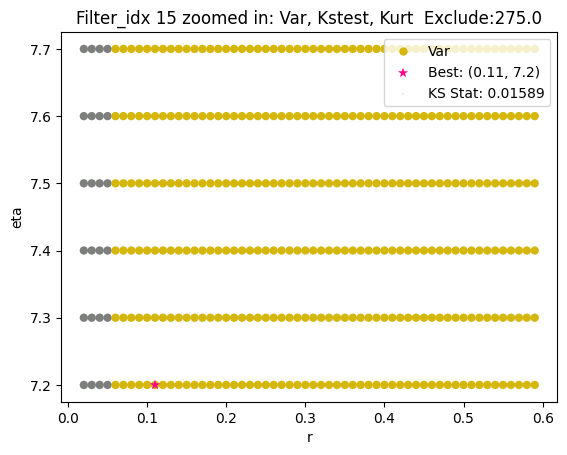

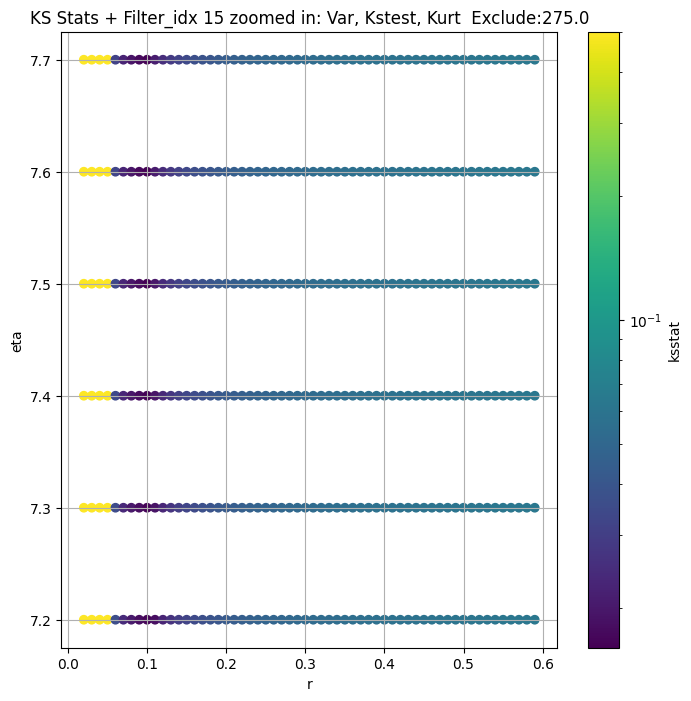

Filter_idx 16


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.009635149779807395, var: 44.41031001470188


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.008353568339270812, var: 45.8341950757536


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.008183421699312632, var: 47.57822527290742


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.007653373698110921, var: 49.925865905317366


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.004954198575552793, var: 56.9681428884678
Number of samples: 100000, Without approximation : 480000000.0


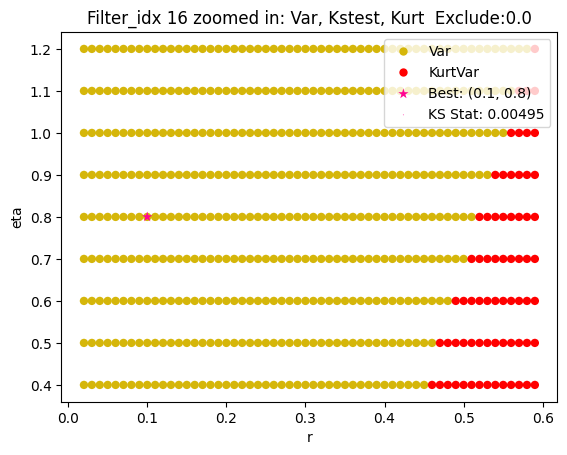

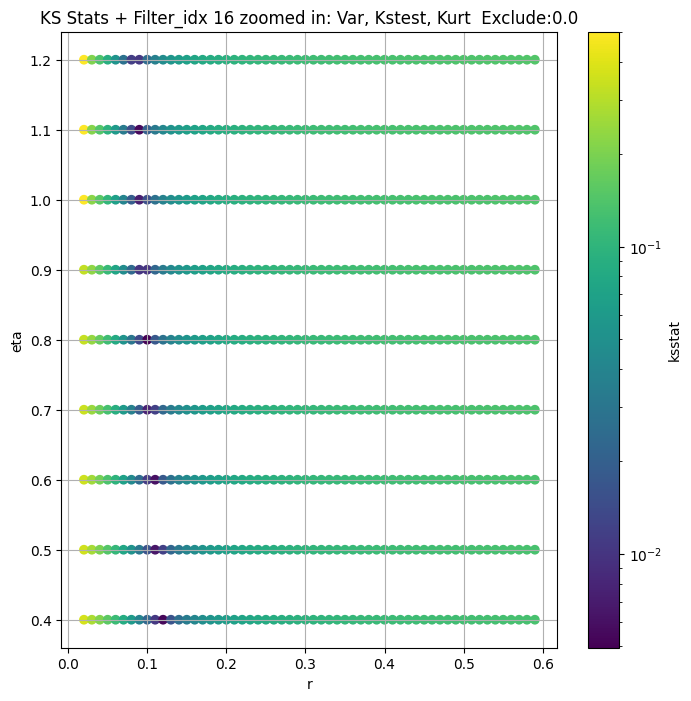

Filter_idx 17


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.01935481729337507, var: 45.42236850279344


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.01914379585544257, var: 46.568004456544685


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.0199384353894681, var: 47.913122779145674


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.01907264002334197, var: 49.60788071631878


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.01797239306152143, var: 53.075738172875
Number of samples: 100000, Without approximation : 480000000.0


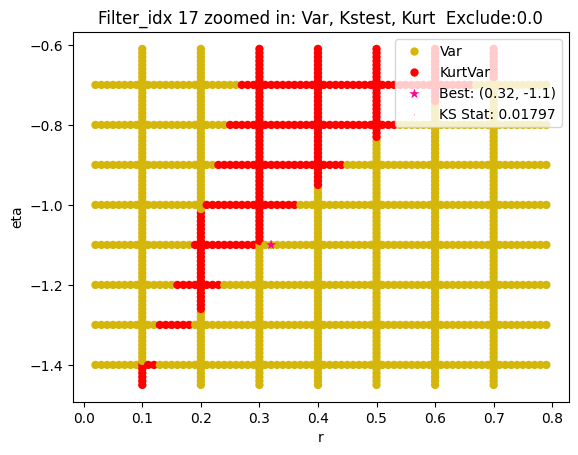

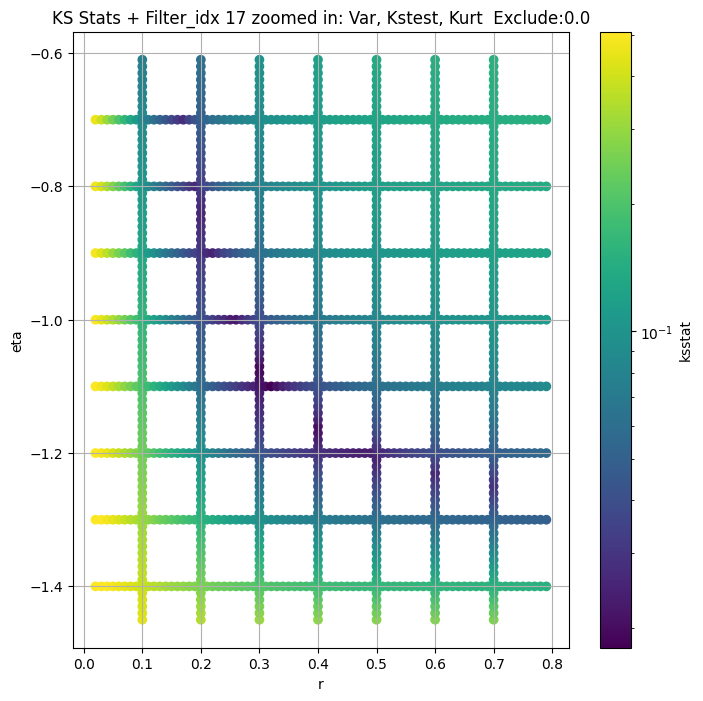

Filter_idx 18


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.00755636444358776, var: 32.267602834795404


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.006884378851521211, var: 33.12524894968442


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.007171254179990982, var: 34.10429252726647


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.00615601456531728, var: 35.255277185119546


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.007484130757272944, var: 36.67477674359165


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.005698500209963819, var: 38.608310019196686


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.005760599323984317, var: 44.322678443361845
Number of samples: 100000, Without approximation : 480000000.0


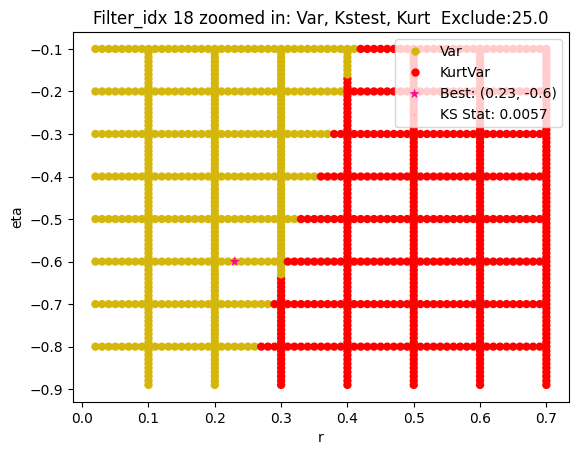

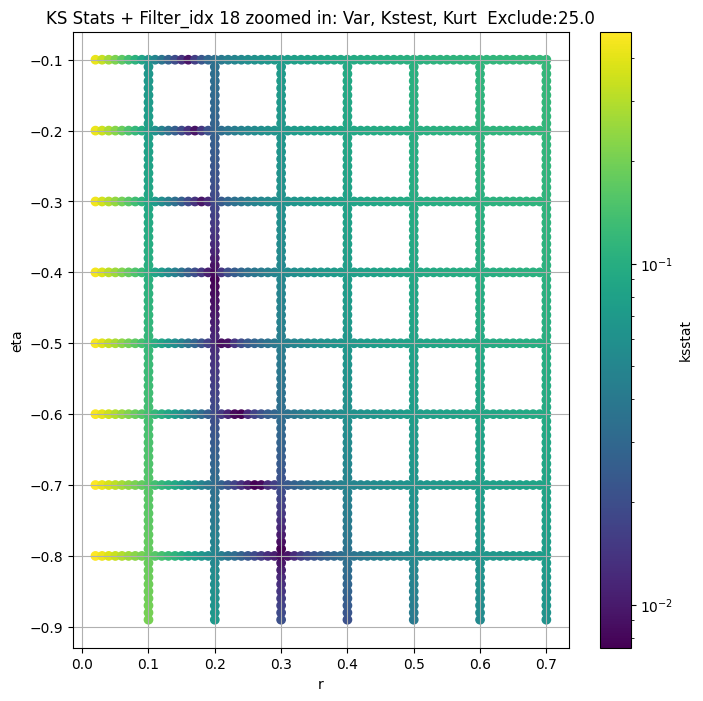

Filter_idx 20


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.011432527278888494, var: 26.3512379589517


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.010358779899206694, var: 27.16261172293565


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.010975962591031951, var: 28.146996173335385


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.01070632178092451, var: 29.46114511926849


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.010471450341287658, var: 33.46226181605903
Number of samples: 100000, Without approximation : 480000000.0


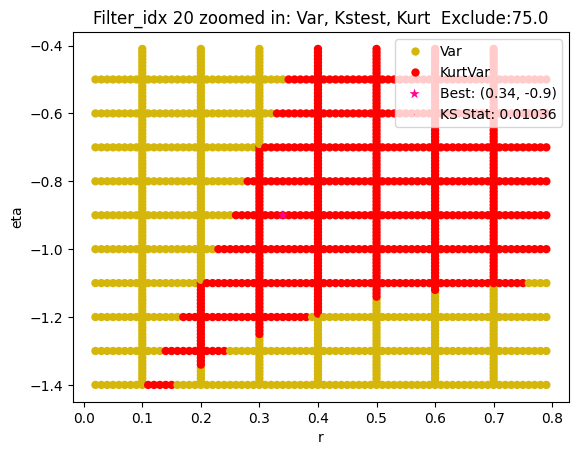

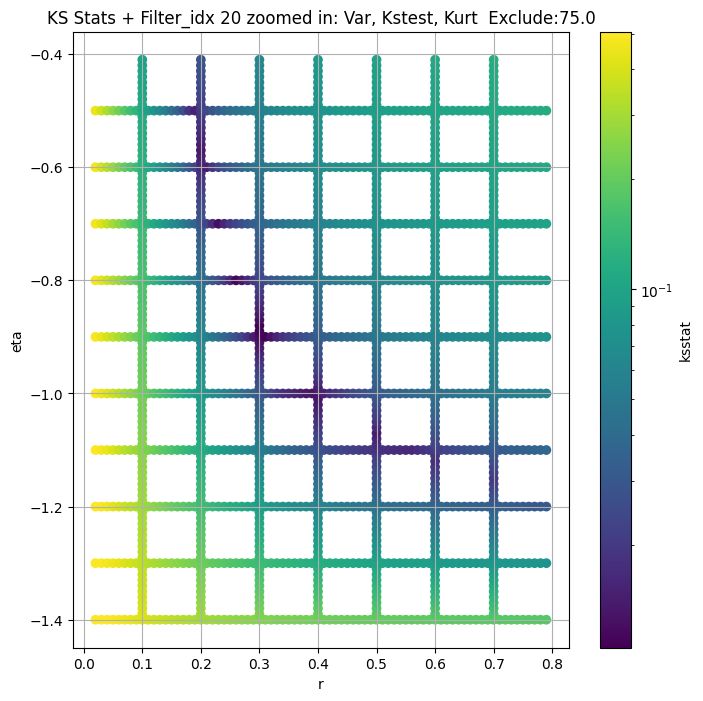

Filter_idx 22


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + 100 = 300, ksstat: 0.010299384499422137, var: 12.040286120010991


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + 75 = 275, ksstat: 0.011001853898753411, var: 12.227175644949522


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + 50 = 250, ksstat: 0.010336437942927934, var: 12.425112129225411


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + 25 = 225, ksstat: 0.010299985609837692, var: 12.63577466902014


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + 0 = 200, ksstat: 0.009841401954139073, var: 12.86123104149543


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + -25 = 175, ksstat: 0.009341147019229501, var: 13.104313333741704


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + -50 = 150, ksstat: 0.00972413234959768, var: 13.368777357439152


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + -75 = 125, ksstat: 0.009345868627321674, var: 13.659879906451405


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 22, 200.0 + -100 = 100, ksstat: 0.00996968116234237, var: 13.985523868692836
Number of samples: 100000, Without approximation : 480000000.0


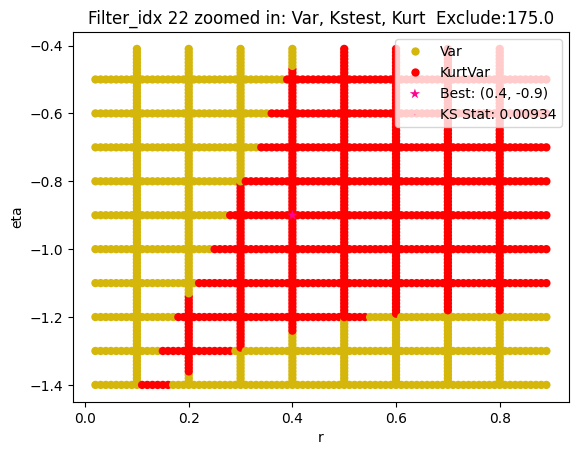

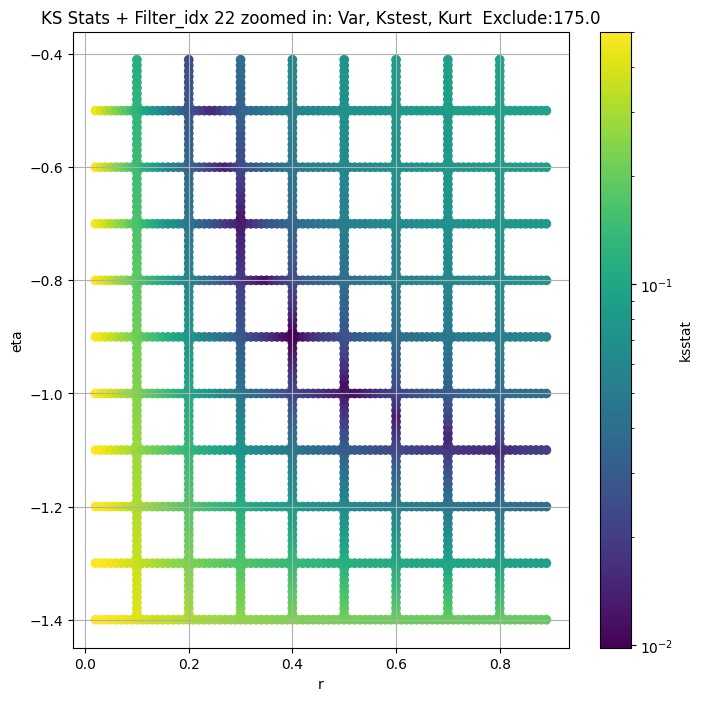

Filter_idx 23


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 100 = 150, ksstat: 0.011952133311273316, var: 23.887974142456883


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 75 = 125, ksstat: 0.012095247507689089, var: 24.37819250579057


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 50 = 100, ksstat: 0.01172981408824647, var: 24.92363383590627


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 25 = 75, ksstat: 0.011408332018619904, var: 25.544437491499707


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 0 = 50, ksstat: 0.011174333581861595, var: 26.27839142539741


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + -25 = 25, ksstat: 0.01080118797917523, var: 27.214622068275492


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + -50 = 0, ksstat: 0.010988065838985706, var: 29.395191745986853
Number of samples: 100000, Without approximation : 480000000.0


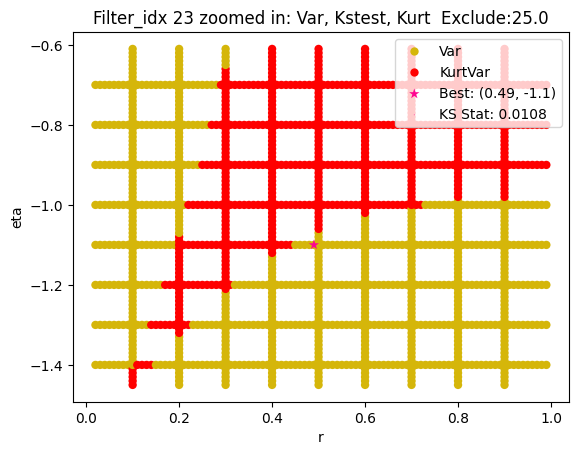

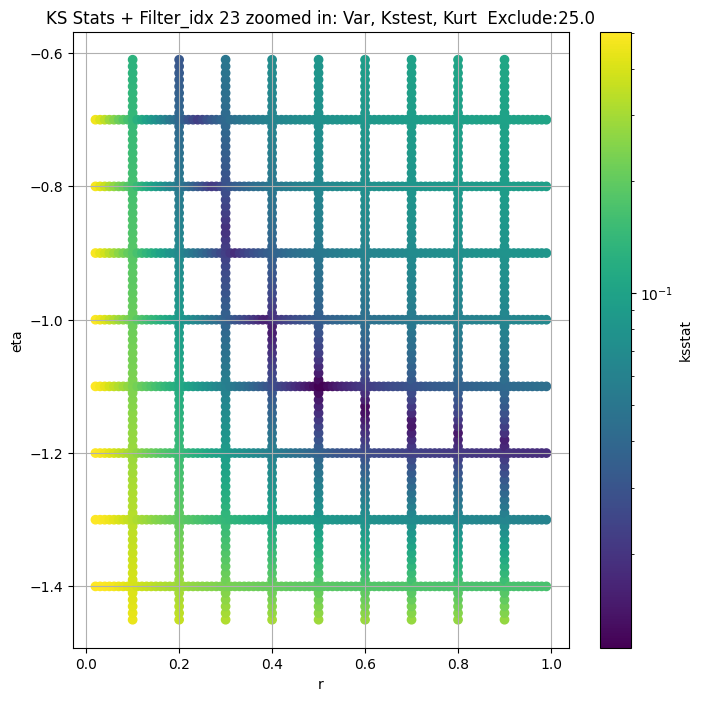

Filter_idx 24


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.011754905846905195, var: 15.269404617705801


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.011642697401709479, var: 15.76188454296096


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.010319928015652513, var: 16.355217423085808


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.009579304419342294, var: 17.13404253351845


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.006956325695545829, var: 19.61666404451466
Number of samples: 100000, Without approximation : 480000000.0


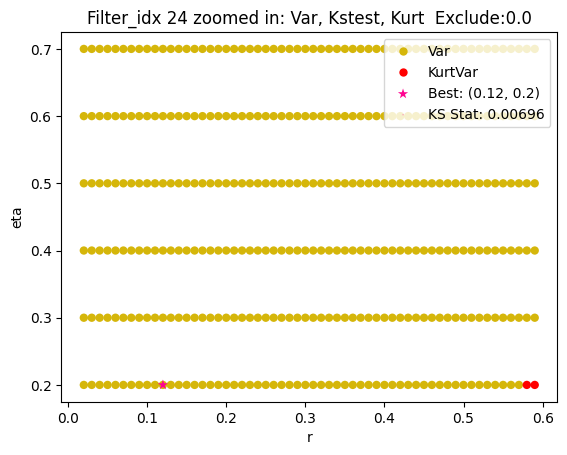

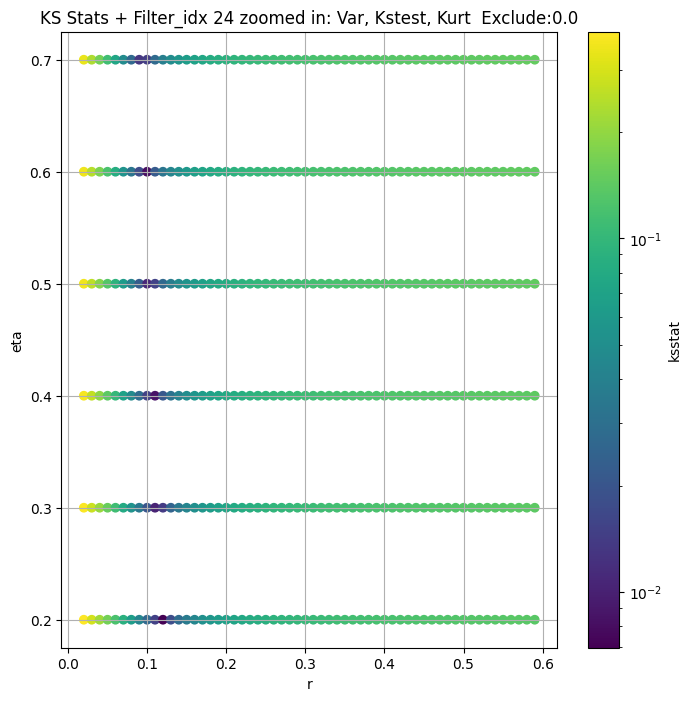

Filter_idx 25


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.005930056531801231, var: 6.6522566387069695


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.005165656891581605, var: 6.839215867322144


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.005166068738197388, var: 7.065442941976558


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.004139034411993717, var: 7.364624700351339


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.0035888060451545467, var: 8.296648013517709
Number of samples: 100000, Without approximation : 480000000.0


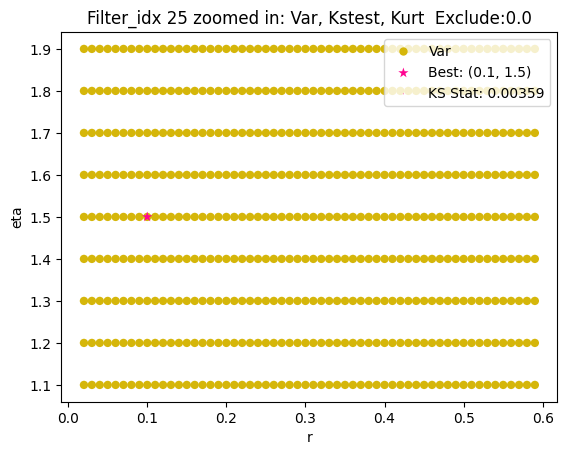

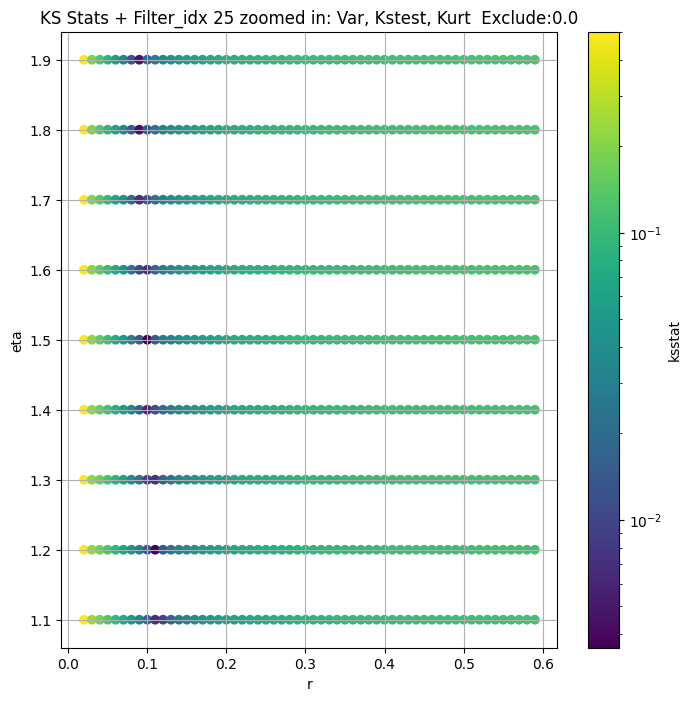

Filter_idx 26


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + 100 = 200, ksstat: 0.020899208870610808, var: 30.559027882936995


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + 75 = 175, ksstat: 0.020924722590744183, var: 31.11210469989755


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + 50 = 150, ksstat: 0.021052173003958397, var: 31.71255611439973


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + 25 = 125, ksstat: 0.02099248880941945, var: 32.372160107268634


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + 0 = 100, ksstat: 0.020939400268325525, var: 33.10830886934289


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + -25 = 75, ksstat: 0.02090580754252791, var: 33.9495036394045


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + -50 = 50, ksstat: 0.021133149529326267, var: 34.94919705716338


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + -75 = 25, ksstat: 0.020901713553751422, var: 36.23605867193313


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 100.0 + -100 = 0, ksstat: 0.020919529031886652, var: 39.24263668891069
Number of samples: 100000, Without approximation : 480000000.0


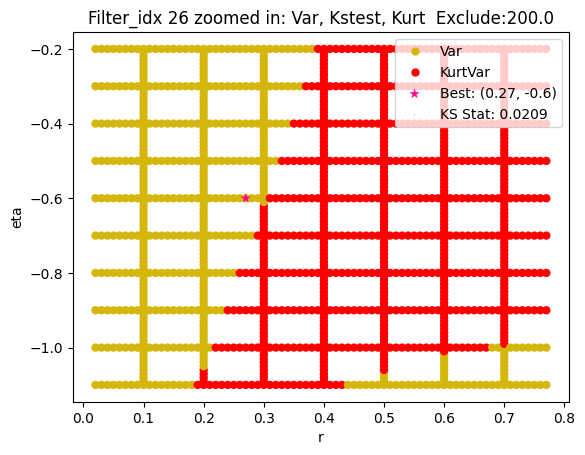

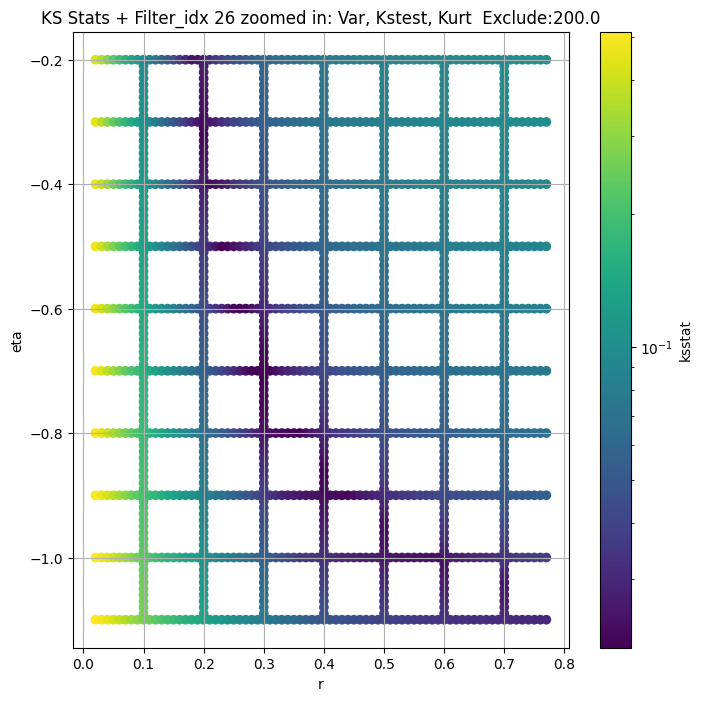

Filter_idx 27


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 100 = 200, ksstat: 0.00489529918562942, var: 5.672320948441734


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 75 = 175, ksstat: 0.00477087075274818, var: 5.79134643522269


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 50 = 150, ksstat: 0.004337826907831133, var: 5.92220997110837


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 25 = 125, ksstat: 0.004262321225504621, var: 6.067995438193966


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 0 = 100, ksstat: 0.004211980989276214, var: 6.233462656356547


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -25 = 75, ksstat: 0.0037716511191071556, var: 6.42637333779385


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -50 = 50, ksstat: 0.00416840595327056, var: 6.661957742696044


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -75 = 25, ksstat: 0.00351689497958535, var: 6.97750260617119


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -100 = 0, ksstat: 0.006387989800695437, var: 8.69216657365792
Number of samples: 100000, Without approximation : 480000000.0


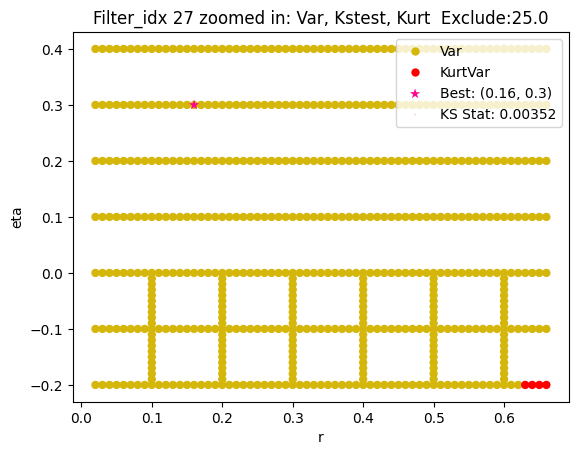

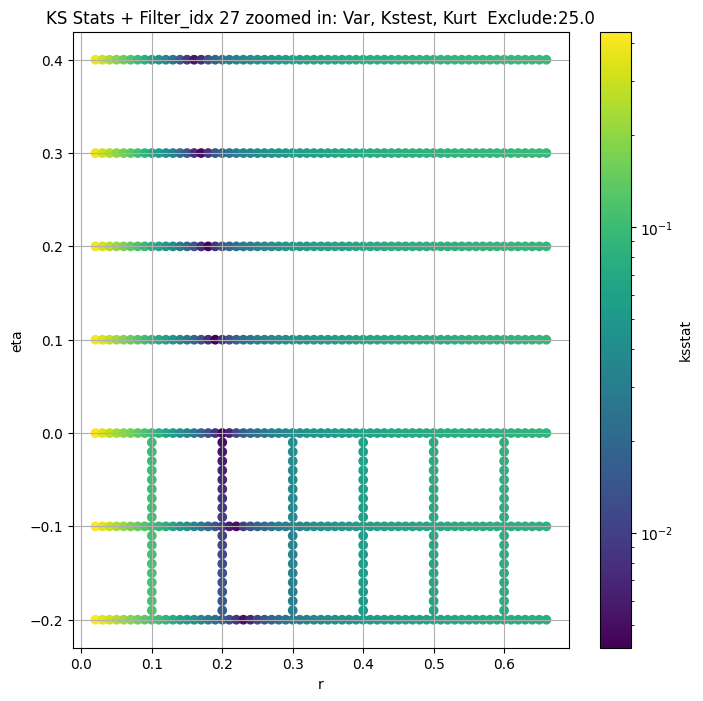

Filter_idx 28


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 100 = 200, ksstat: 0.009622105535830872, var: 19.39413524368263


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 75 = 175, ksstat: 0.009714122903673572, var: 19.784169001305433


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 50 = 150, ksstat: 0.009047667382595659, var: 20.208983929582544


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 25 = 125, ksstat: 0.0097356727104973, var: 20.677288238051013


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 0 = 100, ksstat: 0.009369187899131604, var: 21.20239803595793


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -25 = 75, ksstat: 0.008934603559743293, var: 21.805755373521027


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -50 = 50, ksstat: 0.008457089032116505, var: 22.52746519584463


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -75 = 25, ksstat: 0.008353476297938034, var: 23.464975977366244


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -100 = 0, ksstat: 0.008110301541976561, var: 26.206570779202075
Number of samples: 100000, Without approximation : 480000000.0


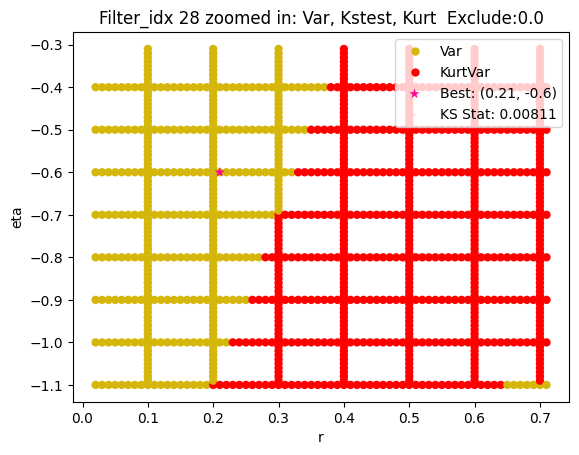

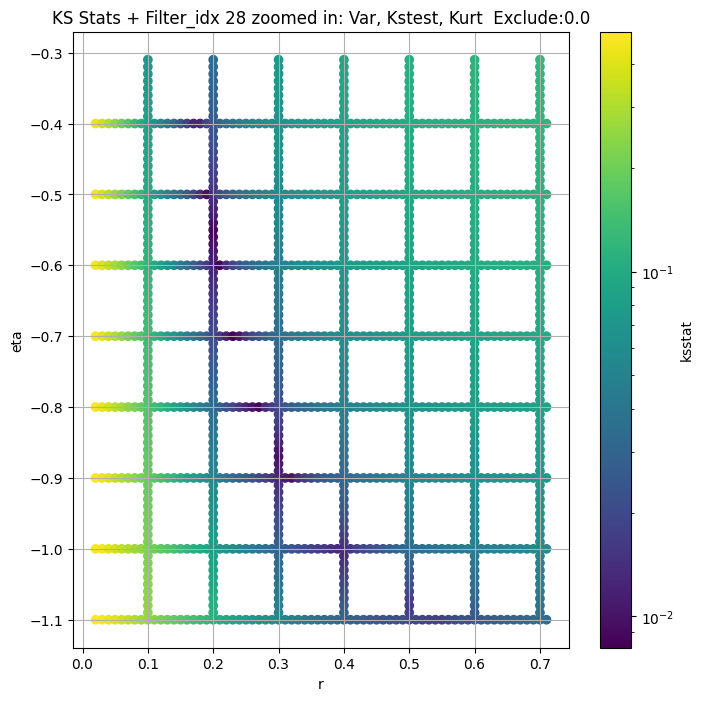

Filter_idx 29


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.03009853342196811, var: 13.936628769123852


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.03009960401629036, var: 14.289417333967243


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.0301051964373395, var: 14.684336708406057


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.03011092356324857, var: 15.136814131976006


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.03011162470425993, var: 15.675591730469767


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.030122818882690028, var: 16.370069669798248


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.03012891923059352, var: 18.060452239672472
Number of samples: 100000, Without approximation : 480000000.0


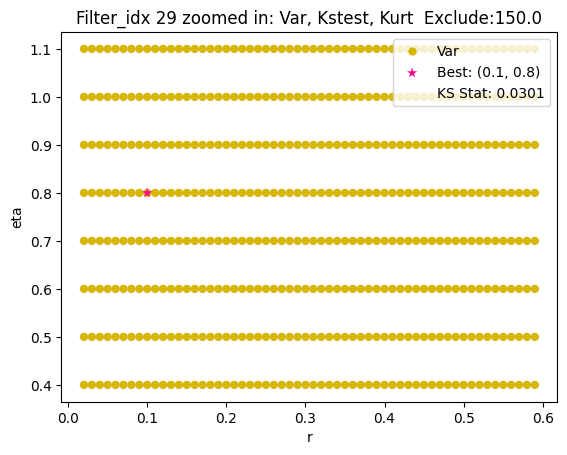

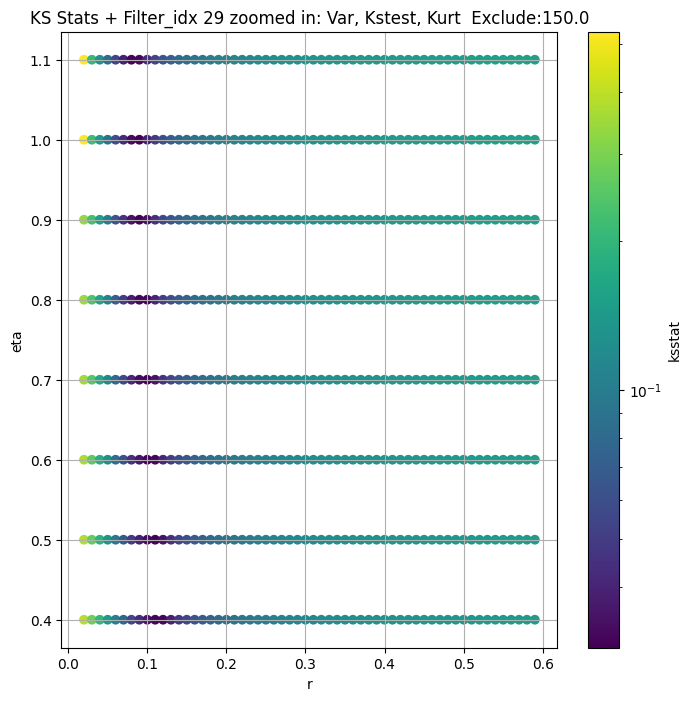

Filter_idx 30


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.010413649676319858, var: 13.676543821483993


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.008767952122967534, var: 14.159727293985798


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.008561563311002551, var: 14.745936686490285


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.008065213123249593, var: 15.520460861428608


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.006499899395806433, var: 17.88258225366284
Number of samples: 100000, Without approximation : 480000000.0


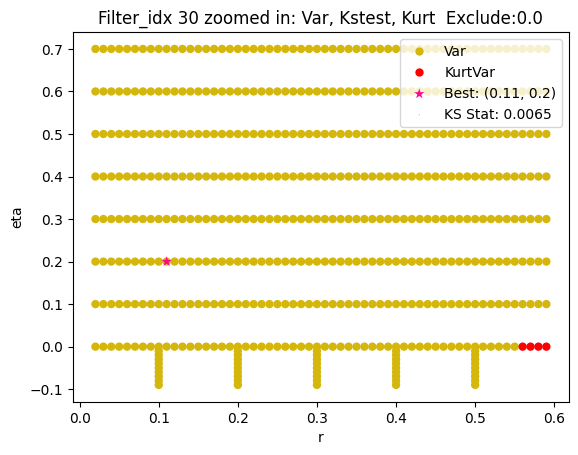

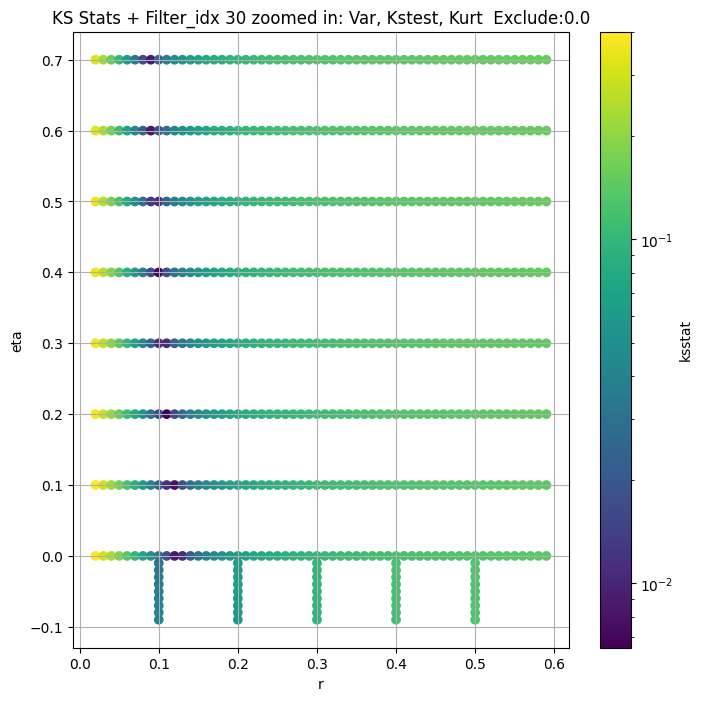

Filter_idx 31


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 100 = 100, ksstat: 0.05878466584019504, var: 36.17139321775513


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 75 = 75, ksstat: 0.058784666729410406, var: 37.050970681272915


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 50 = 50, ksstat: 0.0587846978204668, var: 38.09357601081868


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 25 = 25, ksstat: 0.0587847010593745, var: 39.426038312001246


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 31, 0.0 + 0 = 0, ksstat: 0.05878467714538416, var: 42.23151078674035
Number of samples: 100000, Without approximation : 480000000.0


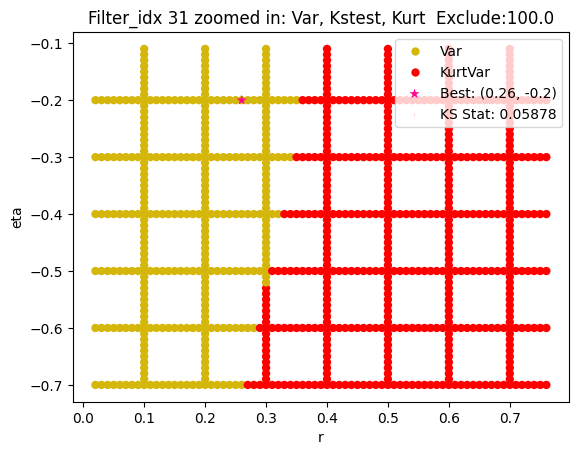

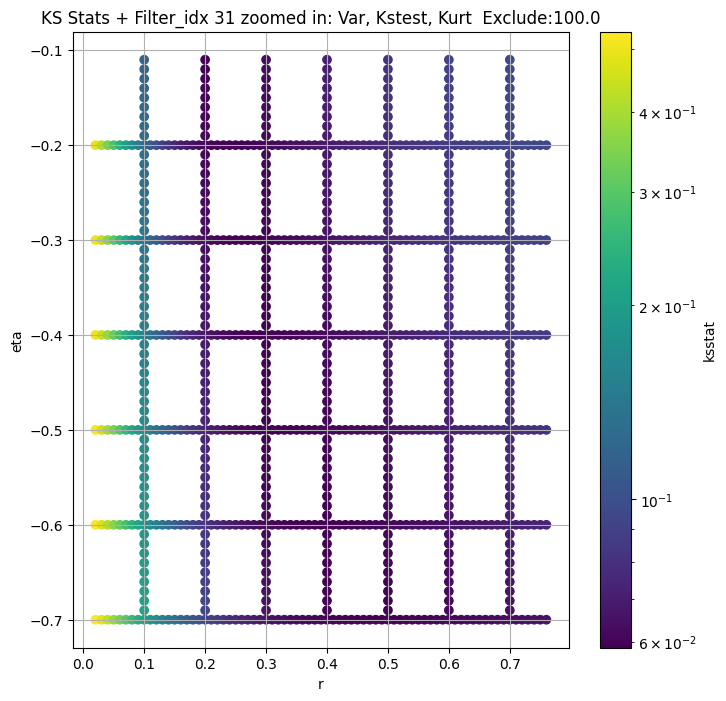

Filter_idx 32


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.015446714876116707, var: 20.08133489630811


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.015280416345744285, var: 20.415149423005168


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.015714386825640525, var: 20.769100702780996


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.015895012064617187, var: 21.1462063052758


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.015940393504282557, var: 21.550336171197486


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.015380388084148044, var: 21.986408300297686


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.01523513480516292, var: 22.461117349181997


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.014861913682042038, var: 22.983909169847113


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.01472805110964015, var: 23.568801127250733
Number of samples: 100000, Without approximation : 480000000.0


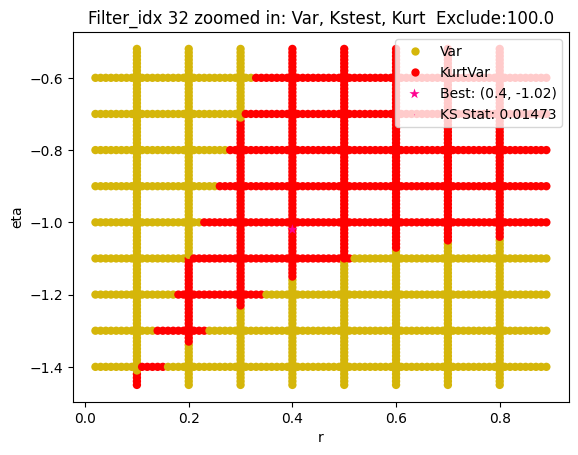

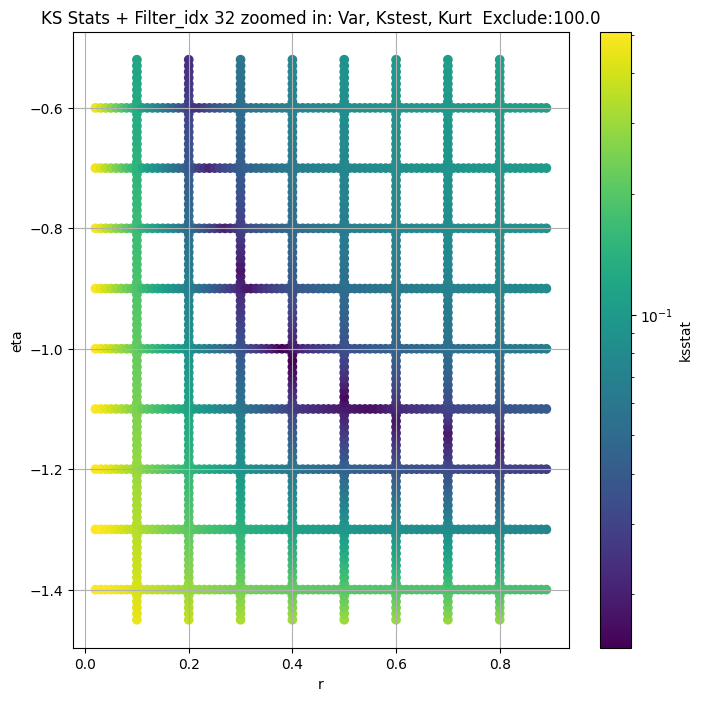

Filter_idx 33


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + 100 = 200, ksstat: 0.006629561794381858, var: 10.82092697480984


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + 75 = 175, ksstat: 0.006292467676251336, var: 11.07970365205461


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + 50 = 150, ksstat: 0.005839743714246892, var: 11.365115731614022


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + 25 = 125, ksstat: 0.005123216318595032, var: 11.68429677699482


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + 0 = 100, ksstat: 0.004501084537359944, var: 12.047982618570895


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + -25 = 75, ksstat: 0.00403360999151809, var: 12.474116958967677


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + -50 = 50, ksstat: 0.004678059555201786, var: 12.9970340075278


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + -75 = 25, ksstat: 0.004470375139446592, var: 13.700745286325837


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 33, 100.0 + -100 = 0, ksstat: 0.0058826891067637055, var: 15.705383976929351
Number of samples: 100000, Without approximation : 480000000.0


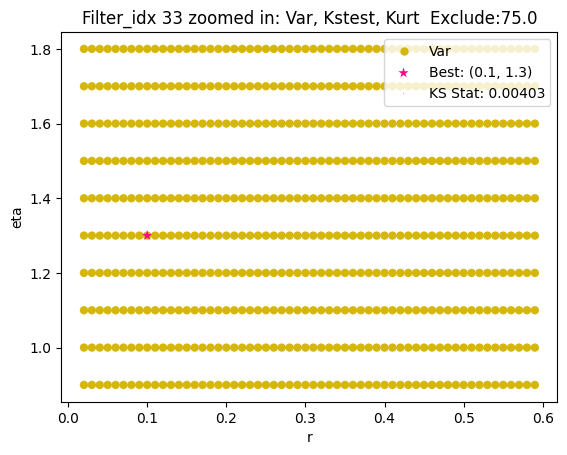

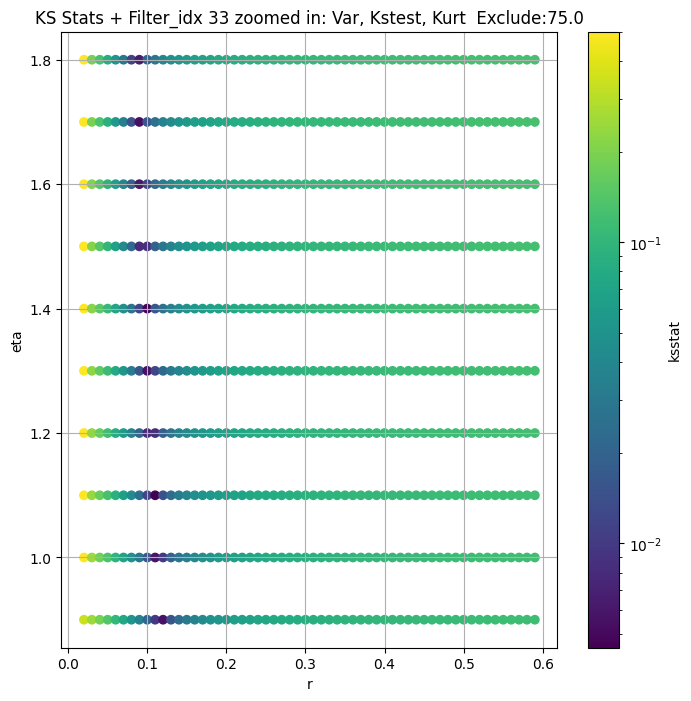

Filter_idx 34


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 100 = 100, ksstat: 0.008531623335808258, var: 18.820392629114668


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 75 = 75, ksstat: 0.00791822049430152, var: 19.376412703992056


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 50 = 50, ksstat: 0.007869431145828165, var: 20.04356799763931


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 25 = 25, ksstat: 0.00802231148798882, var: 20.915468338105406


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 0 = 0, ksstat: 0.007105306092762553, var: 23.40523629107464
Number of samples: 100000, Without approximation : 480000000.0


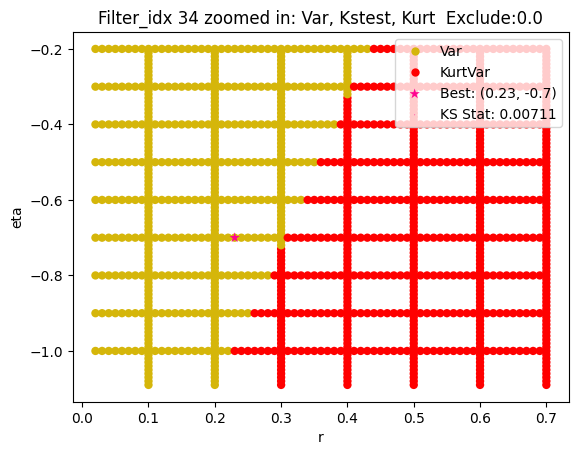

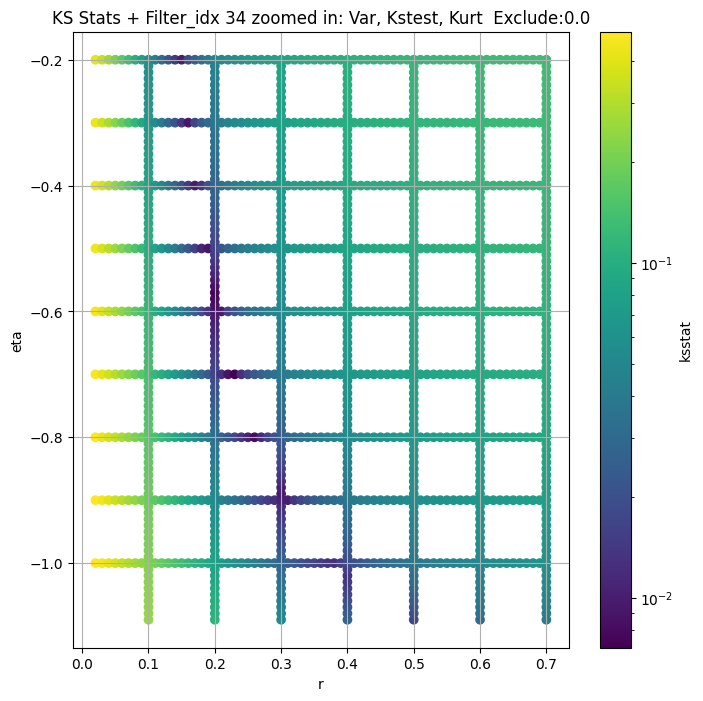

Filter_idx 38


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.024997153071955158, var: 56.63816501342044


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.025062430509317946, var: 58.226535728526976


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.02517574335641032, var: 60.126265325761786


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.025066993869238052, var: 62.58041672323128


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.025043322289001302, var: 67.93500187794221
Number of samples: 100000, Without approximation : 480000000.0


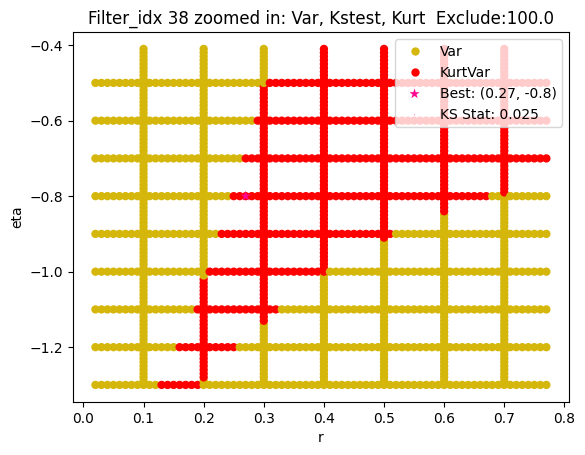

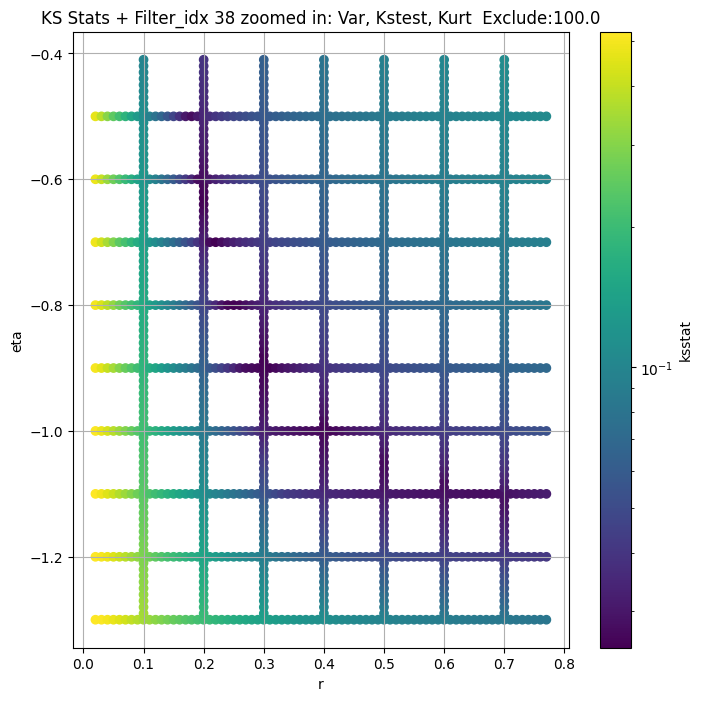

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.06174954279079614, var: 40.80369910828007


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.0617476012254316, var: 41.81833834626284


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.06174766159786266, var: 43.02074931816775


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.06174708828698977, var: 44.55997622069826


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.06174671630624534, var: 47.87546758155271
Number of samples: 100000, Without approximation : 480000000.0


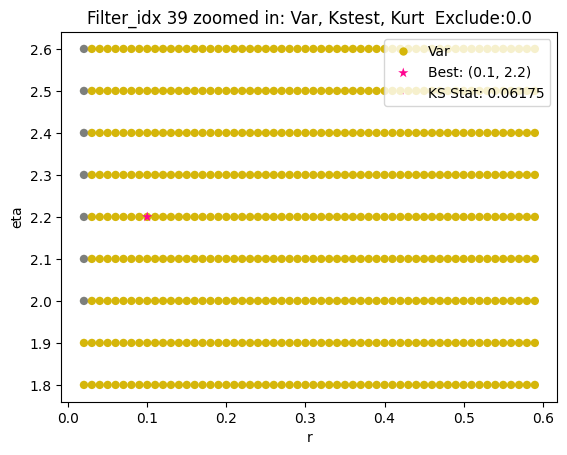

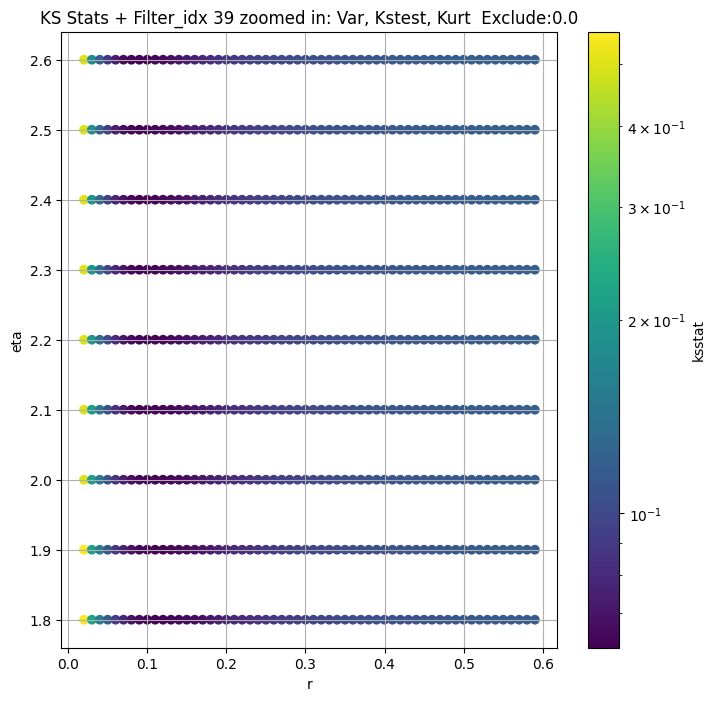

Filter_idx 40


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.010691054980374148, var: 33.63073152450031


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.010680605551666666, var: 33.943307481416014


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.010670709214008478, var: 34.27147217732792


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.010661333846633203, var: 34.61751276975446


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.010689188620083168, var: 34.984144703525416


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.01068156612120047, var: 35.37479704708821


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.010655601005973236, var: 35.794683021803976


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.010683120504312416, var: 36.25022090377742


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.010667779397165678, var: 36.75334651736487
Number of samples: 100000, Without approximation : 480000000.0


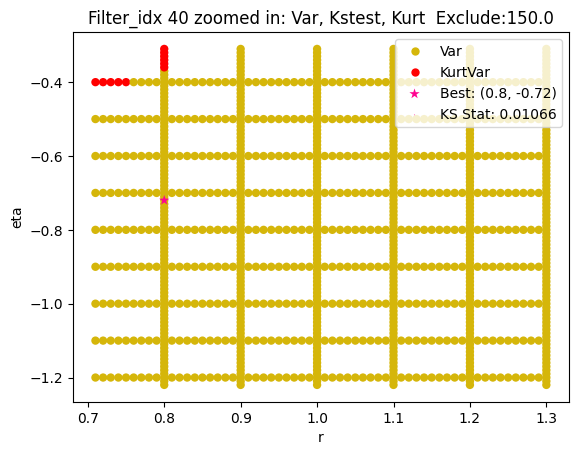

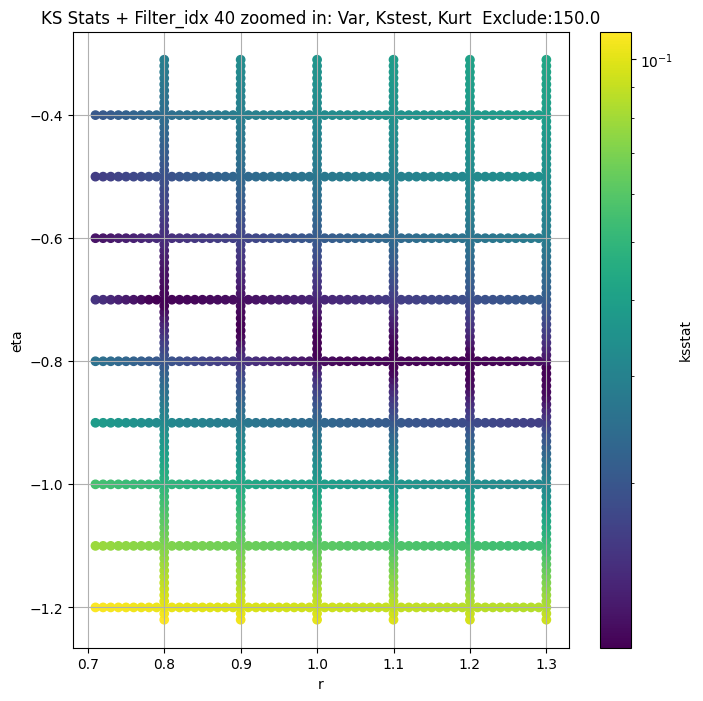

Filter_idx 41


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 100 = 150, ksstat: 0.007466681850847534, var: 19.211745995815654


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 75 = 125, ksstat: 0.007607836415646108, var: 19.786388881541413


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 50 = 100, ksstat: 0.007086646942332742, var: 20.441766195360163


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 25 = 75, ksstat: 0.0063008582266758095, var: 21.210473566746842


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + 0 = 50, ksstat: 0.005591997465169807, var: 22.15413681372297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -25 = 25, ksstat: 0.0048085314823796965, var: 23.424600250275102


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 50.0 + -50 = 0, ksstat: 0.006694553760264399, var: 27.048979509814643
Number of samples: 100000, Without approximation : 480000000.0


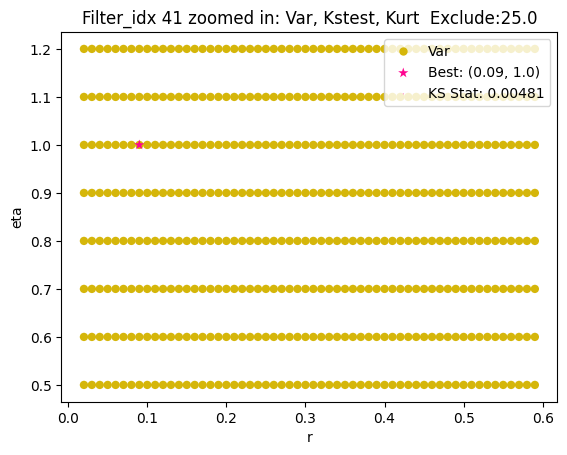

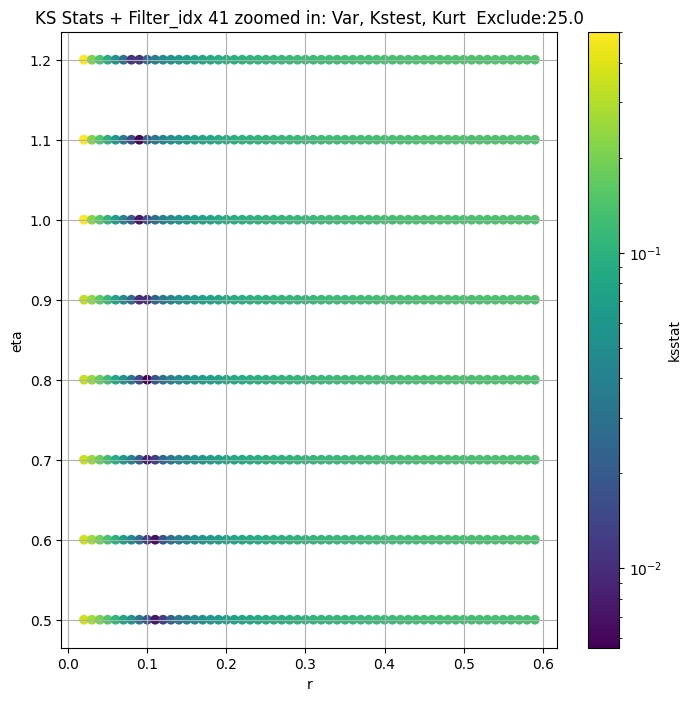

Filter_idx 42


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 100 = 100, ksstat: 0.011335988243704409, var: 59.31222989599197


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 75 = 75, ksstat: 0.011260215431551035, var: 61.1673750720539


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 50 = 50, ksstat: 0.01084889787899379, var: 63.38132968546119


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 25 = 25, ksstat: 0.01126437169240202, var: 66.24786640525575


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 0 = 0, ksstat: 0.011152494298073301, var: 72.9980805274623
Number of samples: 100000, Without approximation : 480000000.0


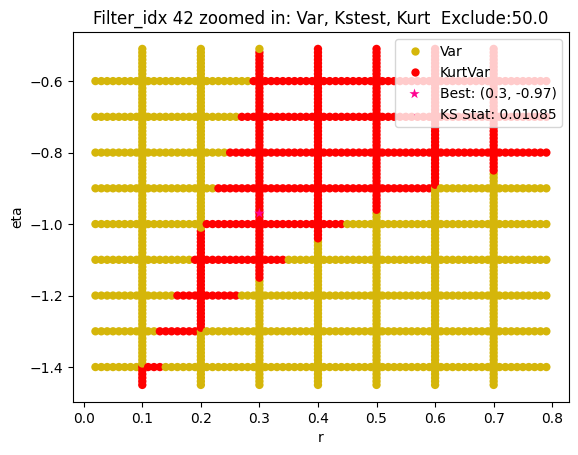

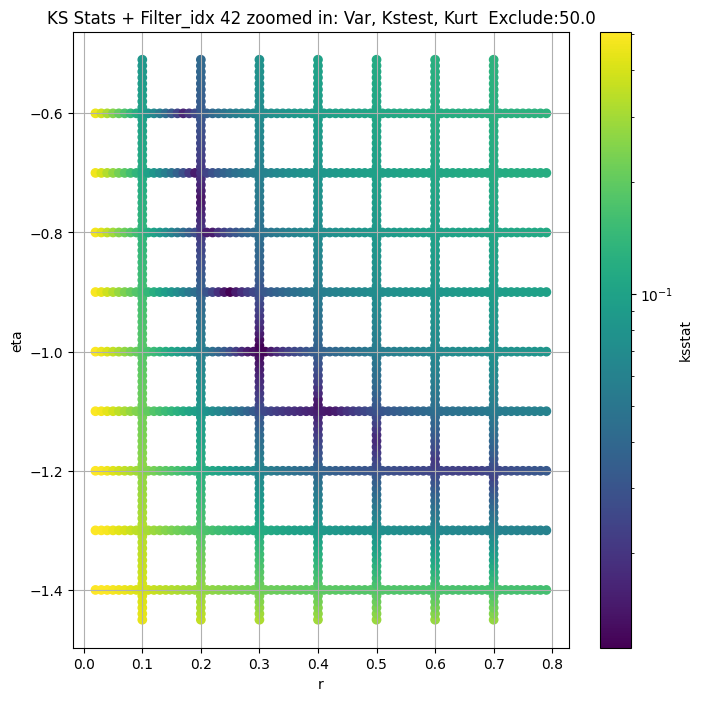

Filter_idx 43


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + 100 = 200, ksstat: 0.01610902137340592, var: 20.811231302116507


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + 75 = 175, ksstat: 0.01595800370761219, var: 21.205189707483466


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + 50 = 150, ksstat: 0.015801722861614464, var: 21.633451850492797


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + 25 = 125, ksstat: 0.015880319547812216, var: 22.104525108661576


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + 0 = 100, ksstat: 0.015921385358668133, var: 22.630577082011115


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + -25 = 75, ksstat: 0.016214061219594678, var: 23.231687950490155


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + -50 = 50, ksstat: 0.015188882390316516, var: 23.945199807855506


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + -75 = 25, ksstat: 0.015436026721262763, var: 24.85764894871311


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 100.0 + -100 = 0, ksstat: 0.015492257437019208, var: 27.02525070488623
Number of samples: 100000, Without approximation : 480000000.0


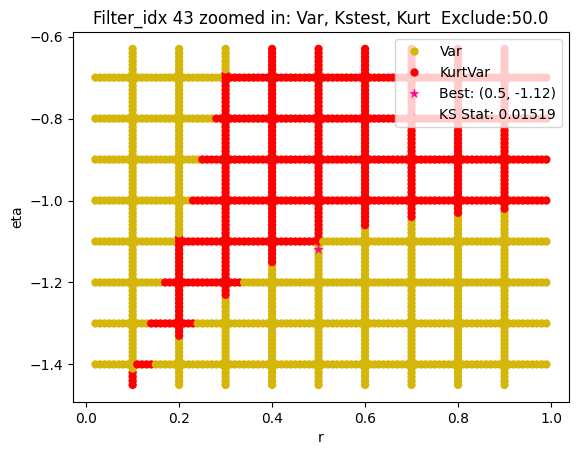

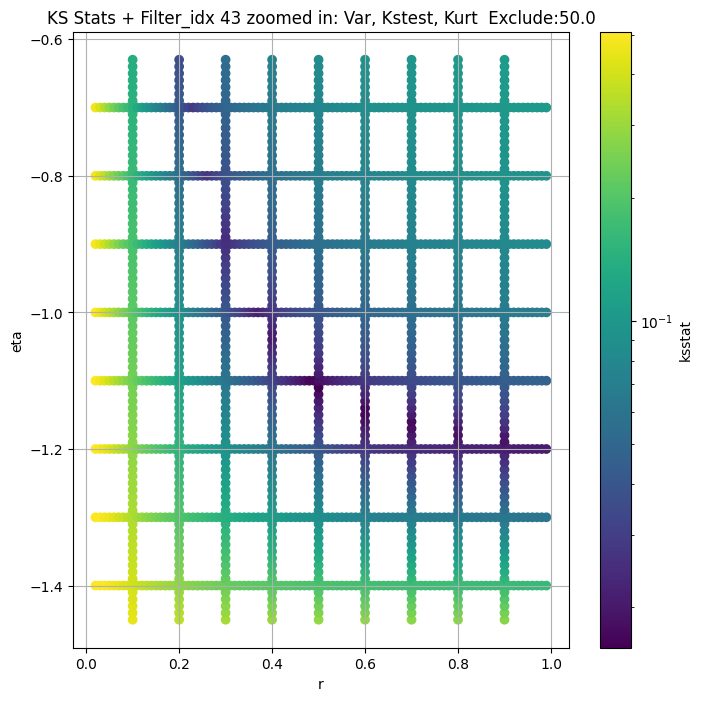

Filter_idx 44


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 44, 0.0 + 100 = 100, ksstat: 0.021629311521074057, var: 47.35953371602822


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 44, 0.0 + 75 = 75, ksstat: 0.021387834999518796, var: 48.8958695979988


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 44, 0.0 + 50 = 50, ksstat: 0.022000446910723004, var: 50.72438796051985


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 44, 0.0 + 25 = 25, ksstat: 0.021654072308796013, var: 53.07973372477083


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 44, 0.0 + 0 = 0, ksstat: 0.02110731528091242, var: 58.2231766209637
Number of samples: 100000, Without approximation : 480000000.0


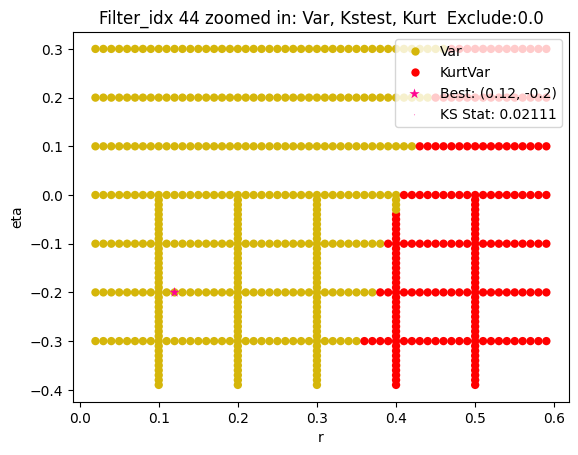

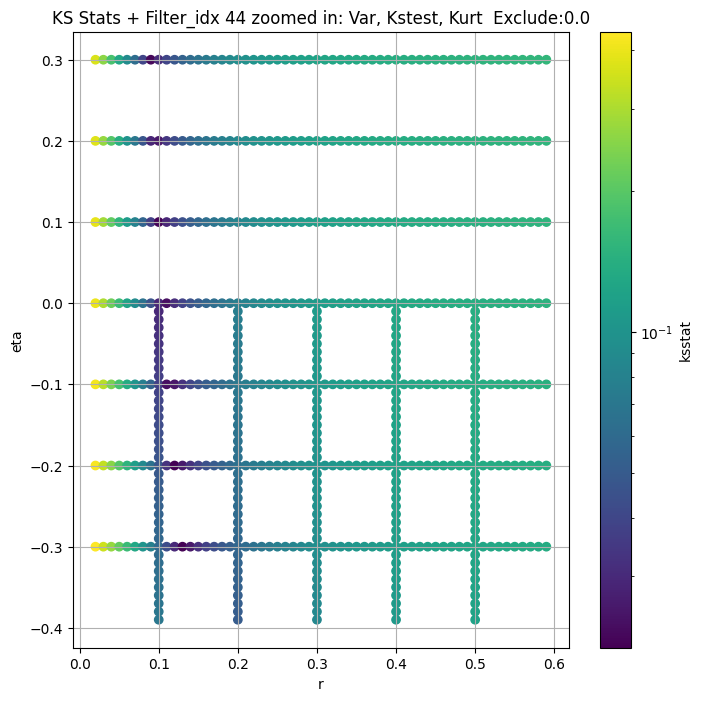

Filter_idx 45


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 0.0 + 100 = 100, ksstat: 0.0278749169507147, var: 30.42867450015054


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 0.0 + 75 = 75, ksstat: 0.027874852361841562, var: 31.24200327713513


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 0.0 + 50 = 50, ksstat: 0.027874899786889062, var: 32.209509437327576


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 0.0 + 25 = 25, ksstat: 0.02787487265798011, var: 33.45527285254054


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 0.0 + 0 = 0, ksstat: 0.027875053284542595, var: 36.25946688273299
Number of samples: 100000, Without approximation : 480000000.0


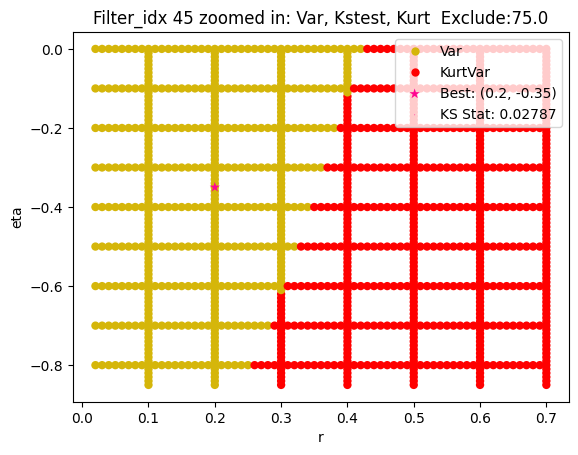

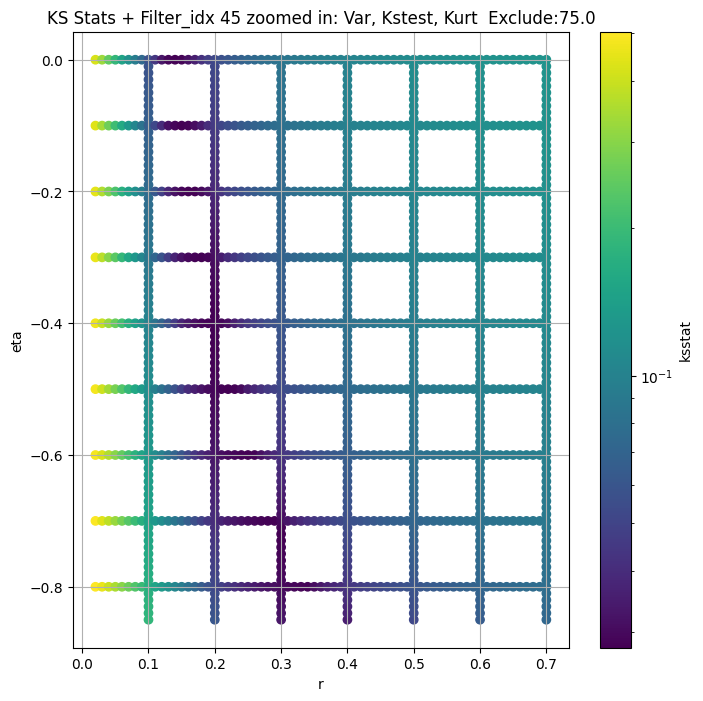

Filter_idx 46


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + 100 = 300, ksstat: 0.03761773970135135, var: 18.801380836317


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + 75 = 275, ksstat: 0.03724968412913138, var: 19.037993331644792


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + 50 = 250, ksstat: 0.03687510839878072, var: 19.287543084228698


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + 25 = 225, ksstat: 0.03690653861105153, var: 19.551883590321246


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + 0 = 200, ksstat: 0.03701379924370446, var: 19.833427177353872


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + -25 = 175, ksstat: 0.03721640647212865, var: 20.135323465716905


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + -50 = 150, ksstat: 0.0372537822745623, var: 20.46176637006669


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + -75 = 125, ksstat: 0.03869730662828172, var: 20.818640363818957


  0%|          | 0/90 [00:00<?, ?it/s]

Finding Minimum after computing 90 CDFs
filter_idx 46, 200.0 + -100 = 100, ksstat: 0.040269620834243625, var: 21.21491605276852
Number of samples: 100000, Without approximation : 480000000.0


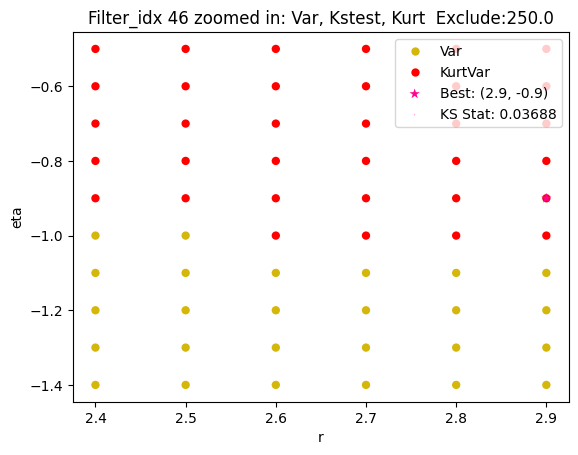

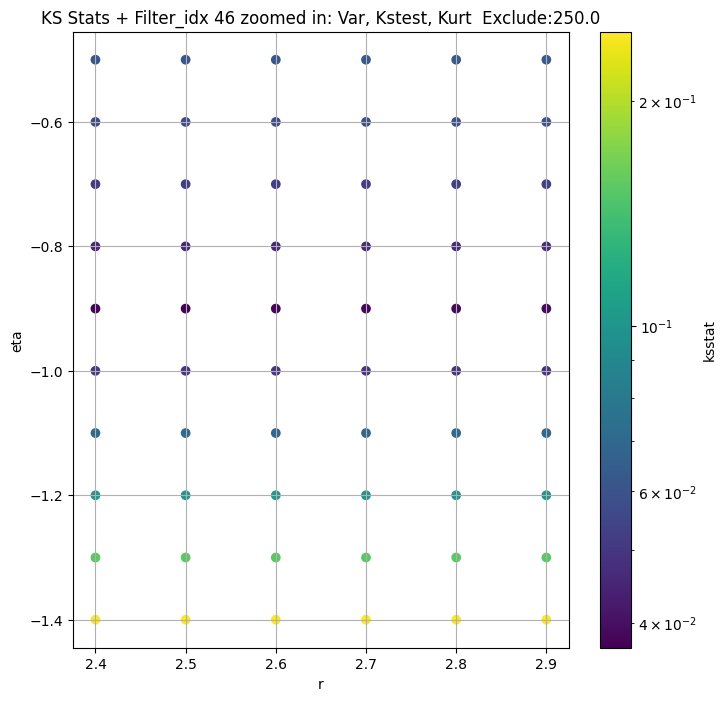

Filter_idx 47


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + 100 = 300, ksstat: 0.012143426427979442, var: 36.13386741011309


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + 75 = 275, ksstat: 0.012191344677523697, var: 36.634036016722014


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + 50 = 250, ksstat: 0.012120366543604821, var: 37.159713281192076


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + 25 = 225, ksstat: 0.01228418657852004, var: 37.714440971327775


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + 0 = 200, ksstat: 0.012206804896511936, var: 38.30260510846674


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + -25 = 175, ksstat: 0.012125597893654194, var: 38.92988564426043


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + -50 = 150, ksstat: 0.012472286654363729, var: 39.603923933914764


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + -75 = 125, ksstat: 0.012828241937257956, var: 40.33484210915705


  0%|          | 0/1111 [00:00<?, ?it/s]

Finding Minimum after computing 1111 CDFs
filter_idx 47, 200.0 + -100 = 100, ksstat: 0.012863562200530643, var: 41.138514892434955
Number of samples: 100000, Without approximation : 480000000.0


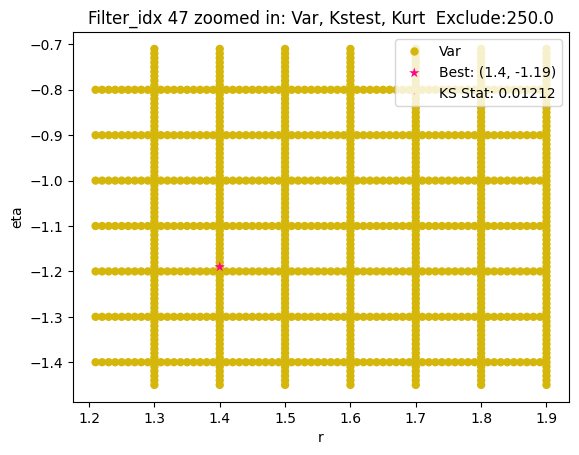

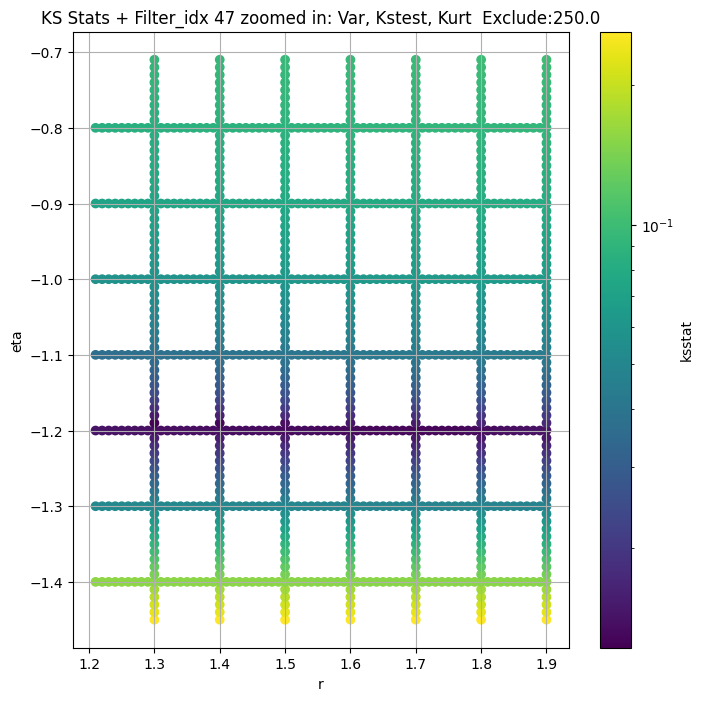

Filter_idx 48


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 100 = 150, ksstat: 0.012766029245587007, var: 13.498228670802979


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 75 = 125, ksstat: 0.011585566492684274, var: 13.865336289835739


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 50 = 100, ksstat: 0.010570455588252647, var: 14.279865510446932


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 25 = 75, ksstat: 0.010889112188778194, var: 14.759853120890545


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 0 = 50, ksstat: 0.010603443921894107, var: 15.338555091335573


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + -25 = 25, ksstat: 0.010421199330114816, var: 16.096143104890512


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + -50 = 0, ksstat: 0.0105774546543847, var: 18.0165819166905
Number of samples: 100000, Without approximation : 480000000.0


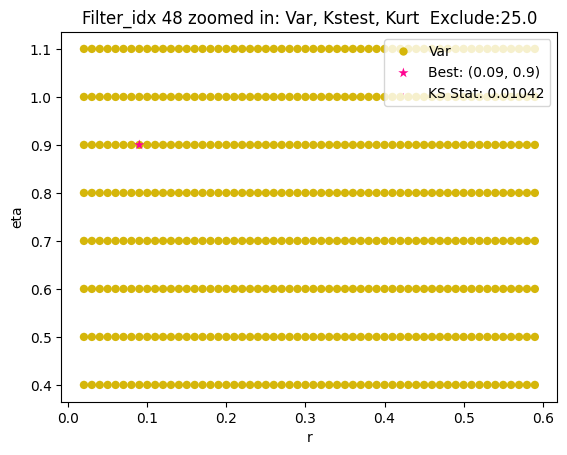

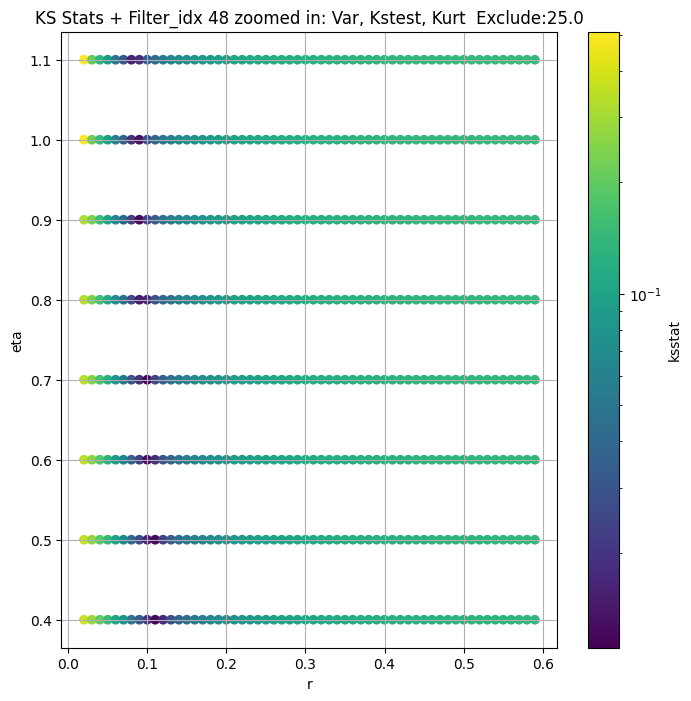

Filter_idx 49


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 100 = 100, ksstat: 0.014118430764133993, var: 56.14722669040746


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 75 = 75, ksstat: 0.01520553568521954, var: 58.01953586036654


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 50 = 50, ksstat: 0.014684049905497099, var: 60.259796344138515


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 25 = 25, ksstat: 0.015398974659092457, var: 63.15998245244893


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 0 = 0, ksstat: 0.014233973268566125, var: 69.44232218976379
Number of samples: 100000, Without approximation : 480000000.0


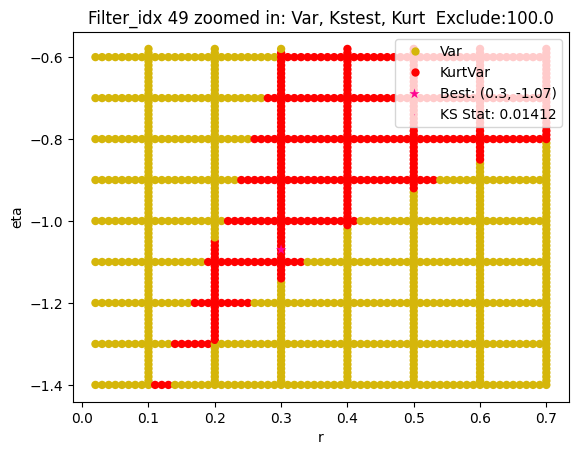

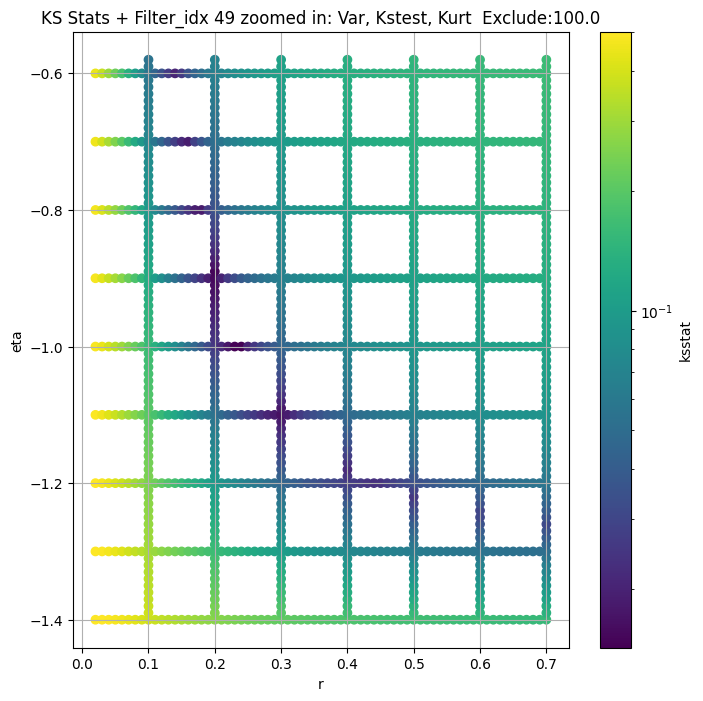

Filter_idx 50


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 50, 0.0 + 100 = 100, ksstat: 0.019161297220764317, var: 44.04844886658286


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 50, 0.0 + 75 = 75, ksstat: 0.019144768660706024, var: 45.33881855475958


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 50, 0.0 + 50 = 50, ksstat: 0.018515258721586436, var: 46.88118193834001


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 50, 0.0 + 25 = 25, ksstat: 0.019396207955334865, var: 48.8832950813577


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 50, 0.0 + 0 = 0, ksstat: 0.018541108872639434, var: 53.79102487969156
Number of samples: 100000, Without approximation : 480000000.0


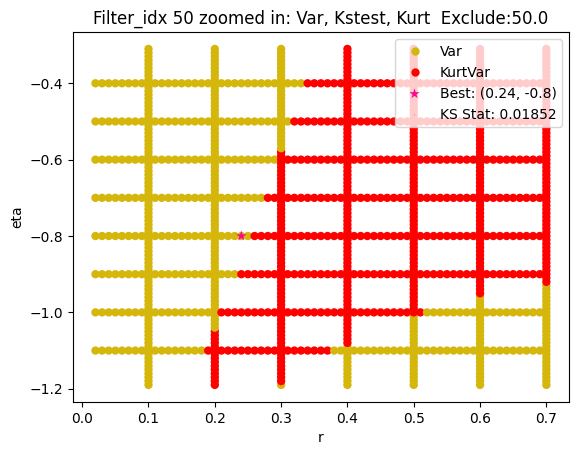

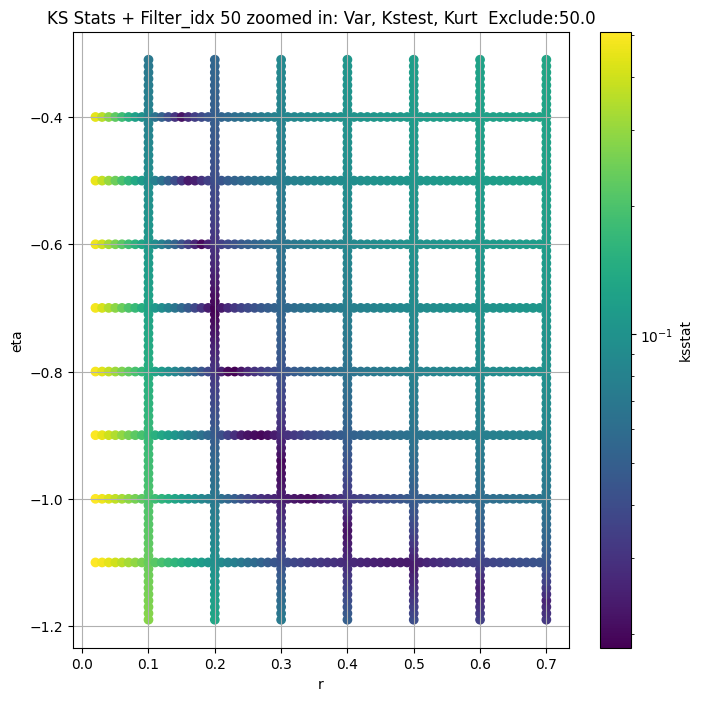

Filter_idx 52


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + 100 = 300, ksstat: 0.021271033676648565, var: 32.35327434582835


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + 75 = 275, ksstat: 0.02127103359314958, var: 32.67189952737112


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + 50 = 250, ksstat: 0.021271408187301832, var: 33.00610984733696


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + 25 = 225, ksstat: 0.02127140892102547, var: 33.35864047212316


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + 0 = 200, ksstat: 0.021271041946196723, var: 33.732738884215486


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + -25 = 175, ksstat: 0.021271764887024314, var: 34.133093560478216


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + -50 = 150, ksstat: 0.021271274342875623, var: 34.56524774242932


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + -75 = 125, ksstat: 0.021272209070821113, var: 35.03756757381173


  0%|          | 0/969 [00:00<?, ?it/s]

Finding Minimum after computing 969 CDFs
filter_idx 52, 200.0 + -100 = 100, ksstat: 0.021271037933546955, var: 35.56373557204745
Number of samples: 100000, Without approximation : 480000000.0


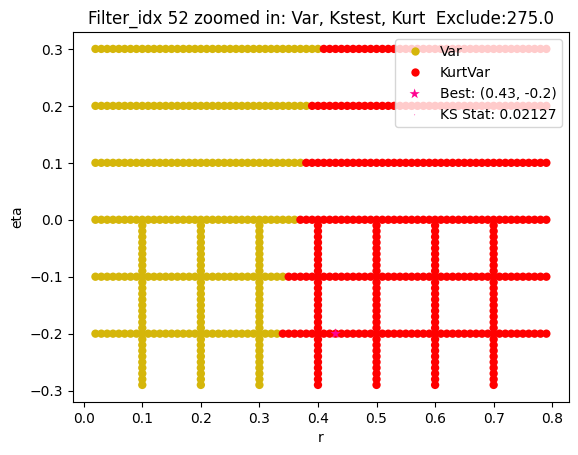

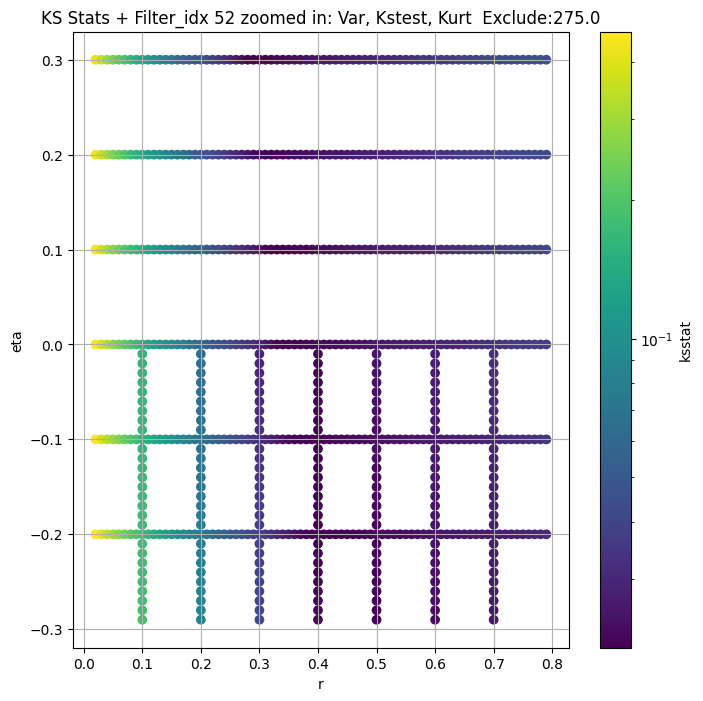

Filter_idx 54


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + 100 = 150, ksstat: 0.006226020142749693, var: 4.4134229675746175


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + 75 = 125, ksstat: 0.005823193490359535, var: 4.515913948936692


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + 50 = 100, ksstat: 0.004989591100333257, var: 4.632621780396664


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + 25 = 75, ksstat: 0.004155268598910855, var: 4.769542863245063


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + 0 = 50, ksstat: 0.0036091901033763474, var: 4.937975713401619


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + -25 = 25, ksstat: 0.002836150865209275, var: 5.166542115909088


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 50.0 + -50 = 0, ksstat: 0.004121619213402705, var: 5.910095395399763
Number of samples: 100000, Without approximation : 480000000.0


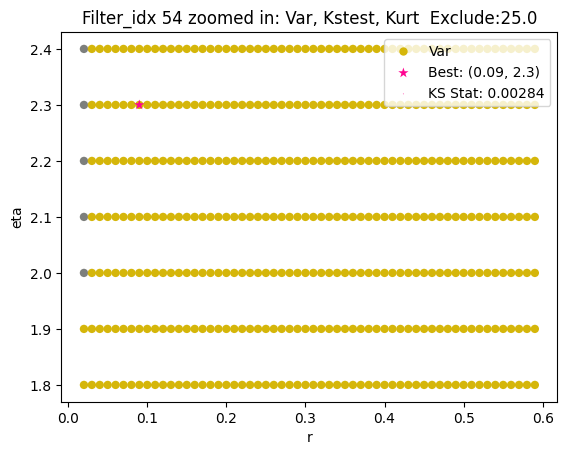

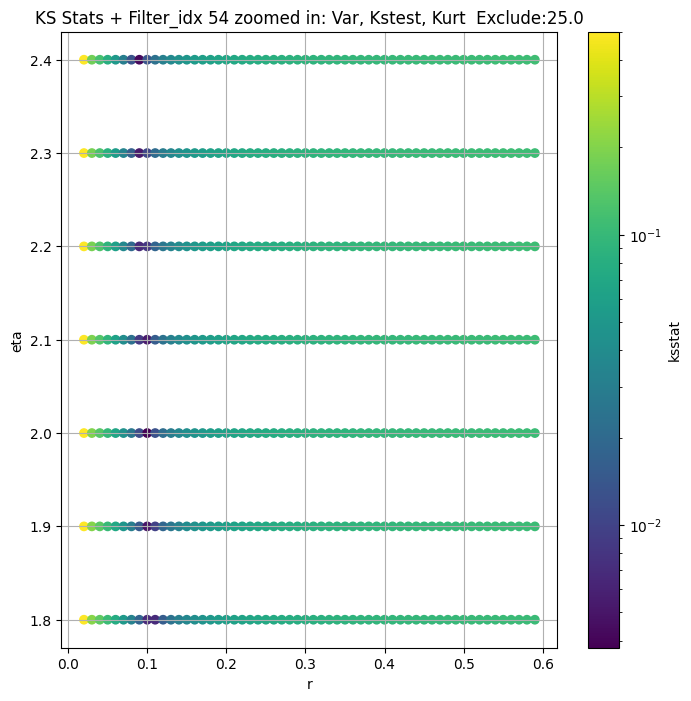

Filter_idx 55


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 100 = 100, ksstat: 0.007716883282957221, var: 21.823147384402056


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 75 = 75, ksstat: 0.007616592000200373, var: 22.58824485555257


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 50 = 50, ksstat: 0.00736891123487593, var: 23.525398226135323


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 25 = 25, ksstat: 0.00699553999278324, var: 24.785680684365353


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 0 = 0, ksstat: 0.005954240232972641, var: 28.245968155496502
Number of samples: 100000, Without approximation : 480000000.0


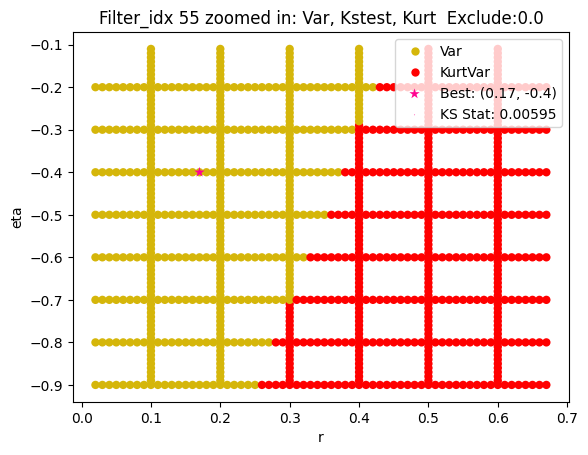

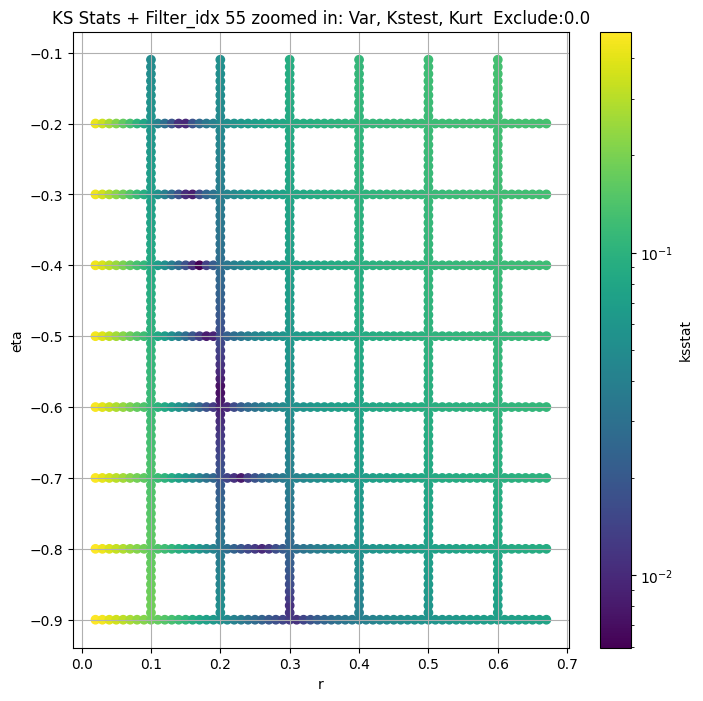

Filter_idx 56


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + 100 = 150, ksstat: 0.01529278209293694, var: 48.46932910342795


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + 75 = 125, ksstat: 0.014638035992910525, var: 49.67114451971583


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + 50 = 100, ksstat: 0.014998459115429408, var: 51.014249543138554


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + 25 = 75, ksstat: 0.014150203190687077, var: 52.5504836948523


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + 0 = 50, ksstat: 0.013734695263176083, var: 54.37577618033677


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + -25 = 25, ksstat: 0.013808517271568288, var: 56.71448199223291


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 56, 50.0 + -50 = 0, ksstat: 0.014021655306357905, var: 61.738980325914646
Number of samples: 100000, Without approximation : 480000000.0


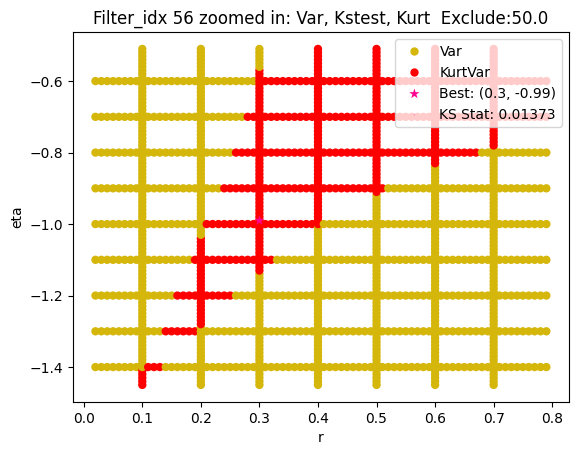

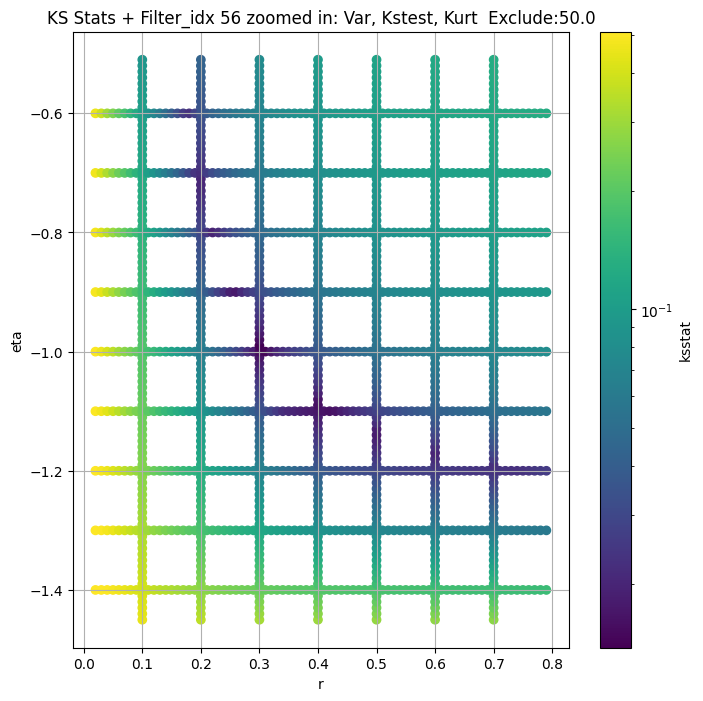

Filter_idx 57


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 100 = 150, ksstat: 0.011948020301009873, var: 35.79693029867744


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 75 = 125, ksstat: 0.010899704846386388, var: 36.68667511408639


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 50 = 100, ksstat: 0.010711535503240888, var: 37.68715067188307


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 25 = 75, ksstat: 0.010935573868763648, var: 38.840682975302634


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 0 = 50, ksstat: 0.010662588061115419, var: 40.22581761511787


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + -25 = 25, ksstat: 0.01022264367429715, var: 42.03451270377857


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + -50 = 0, ksstat: 0.009871755859504394, var: 46.4092453378672
Number of samples: 100000, Without approximation : 480000000.0


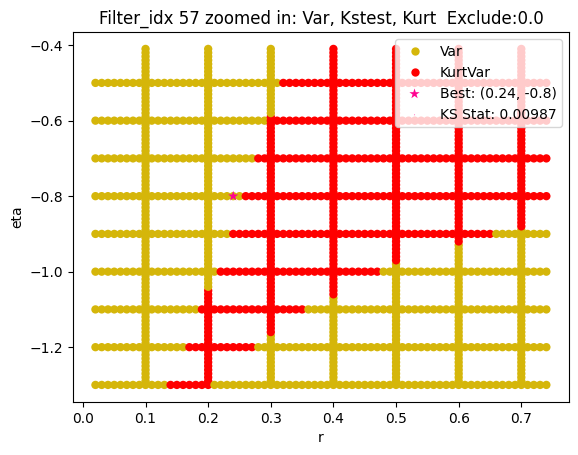

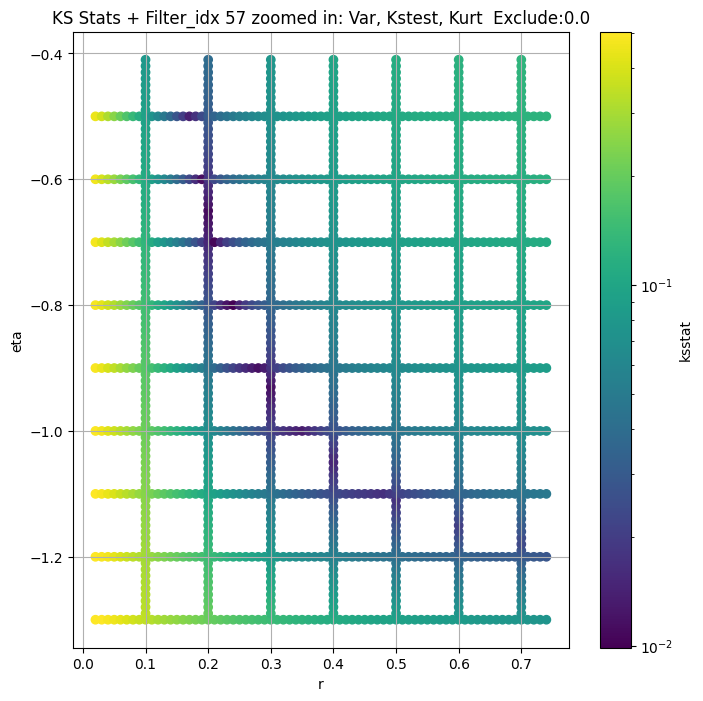

Filter_idx 58


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 100 = 300, ksstat: 0.020303712235979904, var: 16.66209246893793


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 75 = 275, ksstat: 0.020400716986640643, var: 16.820973728811524


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 50 = 250, ksstat: 0.020612151299452652, var: 16.98818290844261


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 25 = 225, ksstat: 0.020739892230312973, var: 17.16495274979365


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 0 = 200, ksstat: 0.02099931495303392, var: 17.35293239050904


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -25 = 175, ksstat: 0.02115203090314899, var: 17.5542523262821


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -50 = 150, ksstat: 0.02134664100760919, var: 17.771623525551092


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -75 = 125, ksstat: 0.021588517700216026, var: 18.008660608317065


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -100 = 100, ksstat: 0.02187051404561391, var: 18.271282440926644
Number of samples: 100000, Without approximation : 480000000.0


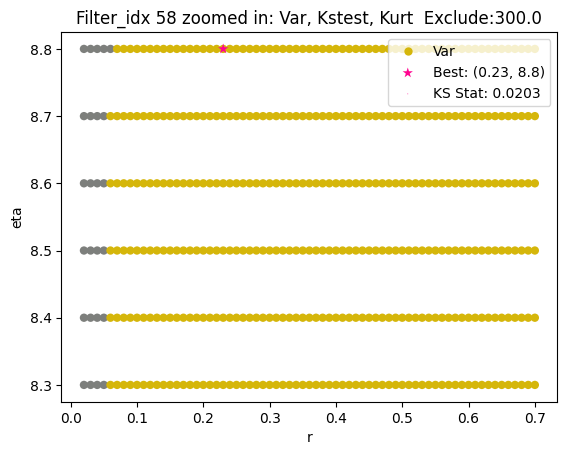

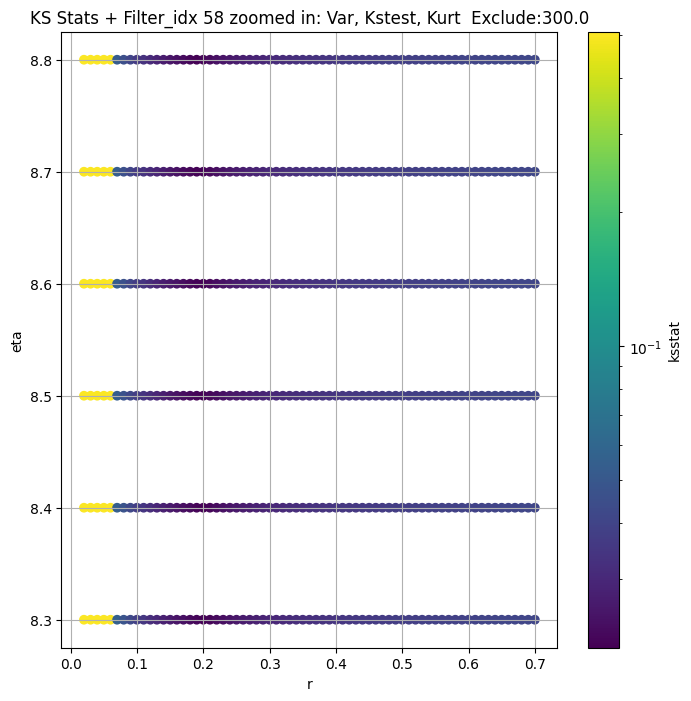

Filter_idx 59


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + 100 = 200, ksstat: 0.013069871607001904, var: 57.100124148489144


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + 75 = 175, ksstat: 0.013122952517588937, var: 58.12591963728562


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + 50 = 150, ksstat: 0.013003377260977056, var: 59.23241221141562


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + 25 = 125, ksstat: 0.012878660289873, var: 60.438073133788926


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + 0 = 100, ksstat: 0.01244435487996004, var: 61.77055583394157


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + -25 = 75, ksstat: 0.012674396636431218, var: 63.275264697390675


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + -50 = 50, ksstat: 0.012464328188623919, var: 65.03620316881579


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + -75 = 25, ksstat: 0.012261183436483525, var: 67.25307782512661


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 59, 100.0 + -100 = 0, ksstat: 0.012509149025163424, var: 71.705622302549
Number of samples: 100000, Without approximation : 480000000.0


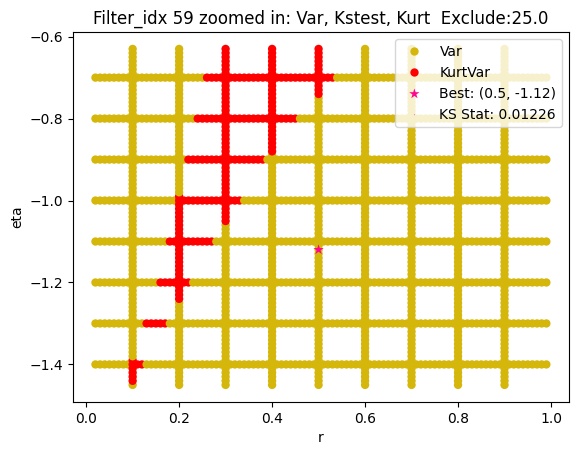

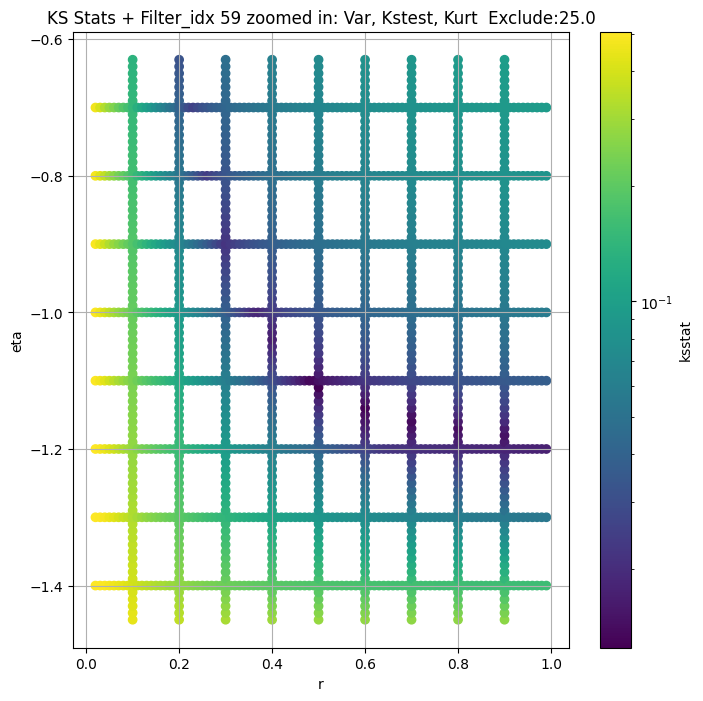

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 100 = 300, ksstat: 0.007903577041260892, var: 3.449940169109869


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 75 = 275, ksstat: 0.007486654464068876, var: 3.4992780677499327


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 50 = 250, ksstat: 0.007180023511653366, var: 3.551656960561518


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 25 = 225, ksstat: 0.007270246147407122, var: 3.607559941390725


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 0 = 200, ksstat: 0.00739814203610778, var: 3.667592926536633


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -25 = 175, ksstat: 0.007560150314286029, var: 3.7325706806934593


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -50 = 150, ksstat: 0.00748196669068435, var: 3.8035929483859485


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -75 = 125, ksstat: 0.007586864970107521, var: 3.8822565880791964


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -100 = 100, ksstat: 0.007681203898559419, var: 3.971012642173954
Number of samples: 100000, Without approximation : 480000000.0


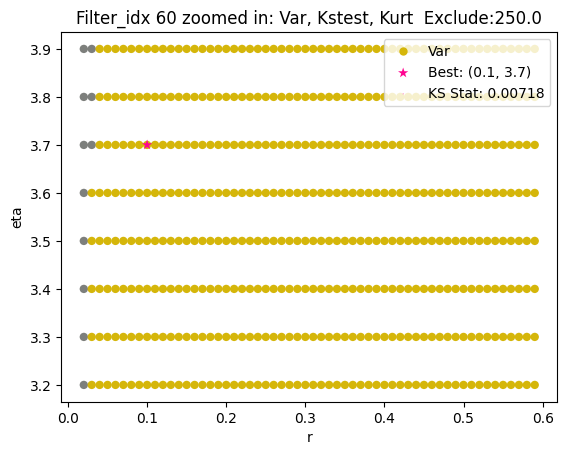

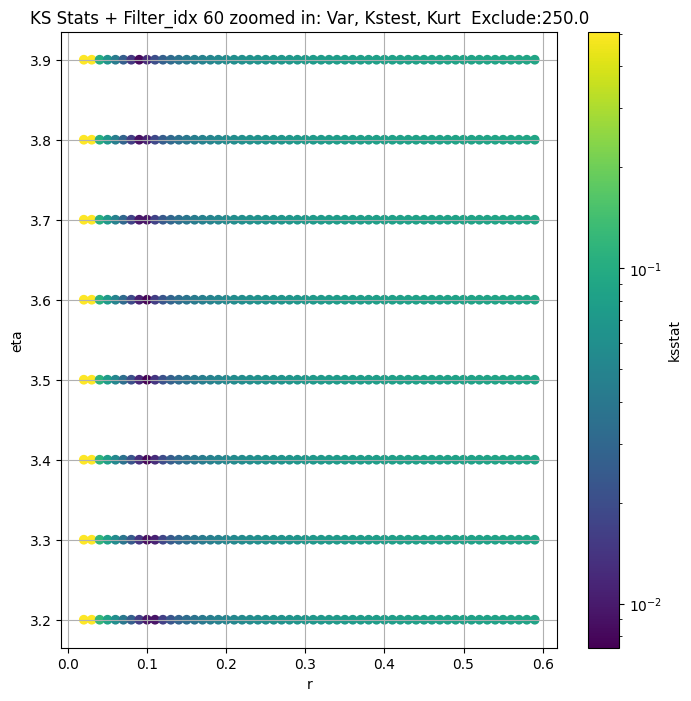

Filter_idx 61


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 100 = 200, ksstat: 0.010524220324964986, var: 14.078150129858507


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 75 = 175, ksstat: 0.01080443725136937, var: 14.35835182686507


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 50 = 150, ksstat: 0.010581967389354574, var: 14.662997178809947


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 25 = 125, ksstat: 0.011097461709099865, var: 14.998276035740183


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 0 = 100, ksstat: 0.01074348195689756, var: 15.373639728841216


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -25 = 75, ksstat: 0.010161858270005347, var: 15.803963081845696


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -50 = 50, ksstat: 0.009975746033262789, var: 16.317119592029073


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -75 = 25, ksstat: 0.009841176059061874, var: 16.980508991180084


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -100 = 0, ksstat: 0.010034594305760702, var: 18.599342555035143
Number of samples: 100000, Without approximation : 480000000.0


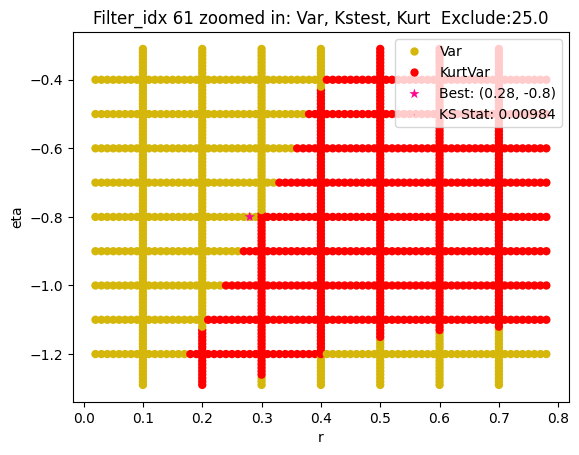

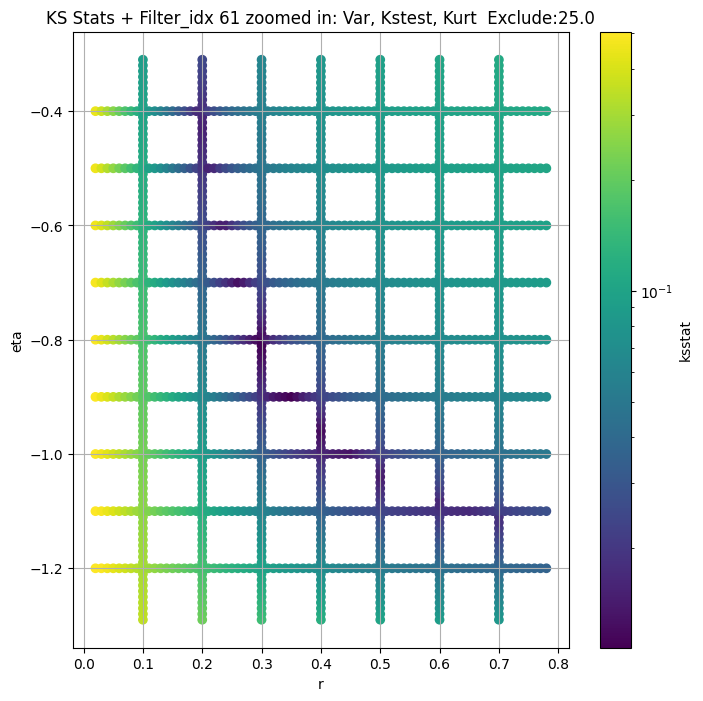

Filter_idx 62


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 0.0 + 100 = 100, ksstat: 0.03166032995858037, var: 50.1536358265829


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 0.0 + 75 = 75, ksstat: 0.031676145126752486, var: 51.33869564052186


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 0.0 + 50 = 50, ksstat: 0.03166033314146616, var: 52.724263336609084


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 0.0 + 25 = 25, ksstat: 0.03166970577242556, var: 54.462516935192134


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 0.0 + 0 = 0, ksstat: 0.03166306047283762, var: 58.03867676431666
Number of samples: 100000, Without approximation : 480000000.0


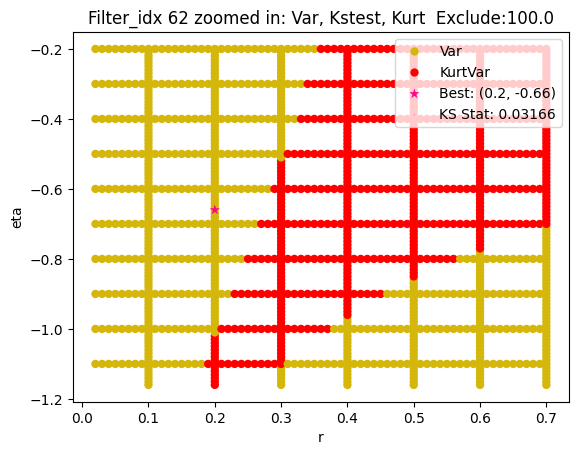

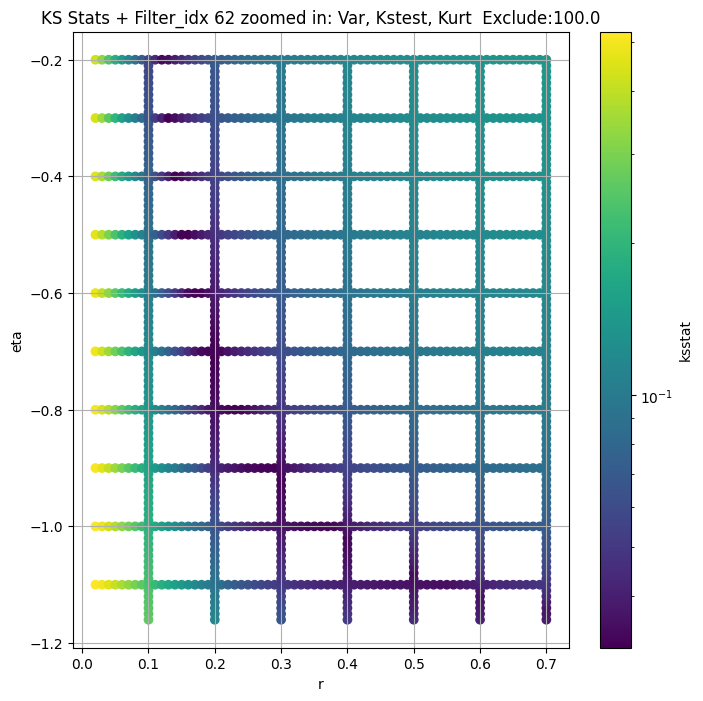

Filter_idx 63


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + 100 = 150, ksstat: 0.005168422979630924, var: 10.381954252060913


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + 75 = 125, ksstat: 0.004676675342903433, var: 10.648816882832959


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + 50 = 100, ksstat: 0.003901301749083763, var: 10.954213091615797


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + 25 = 75, ksstat: 0.003261747807022264, var: 11.313990838753584


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + 0 = 50, ksstat: 0.003283913452111431, var: 11.758588921122437


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + -25 = 25, ksstat: 0.0037773754626055367, var: 12.364058983376196


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 63, 50.0 + -50 = 0, ksstat: 0.005166405561753851, var: 14.228201687632874
Number of samples: 100000, Without approximation : 480000000.0


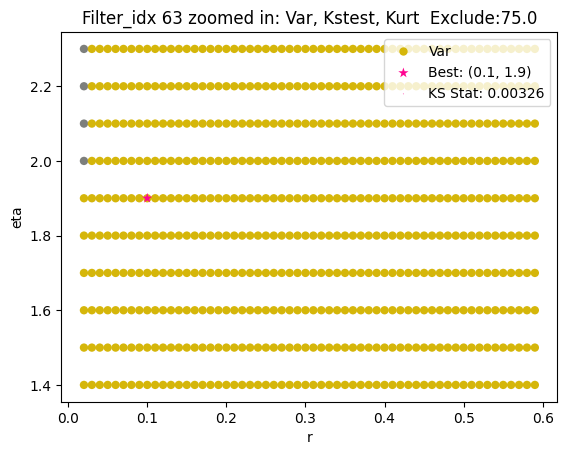

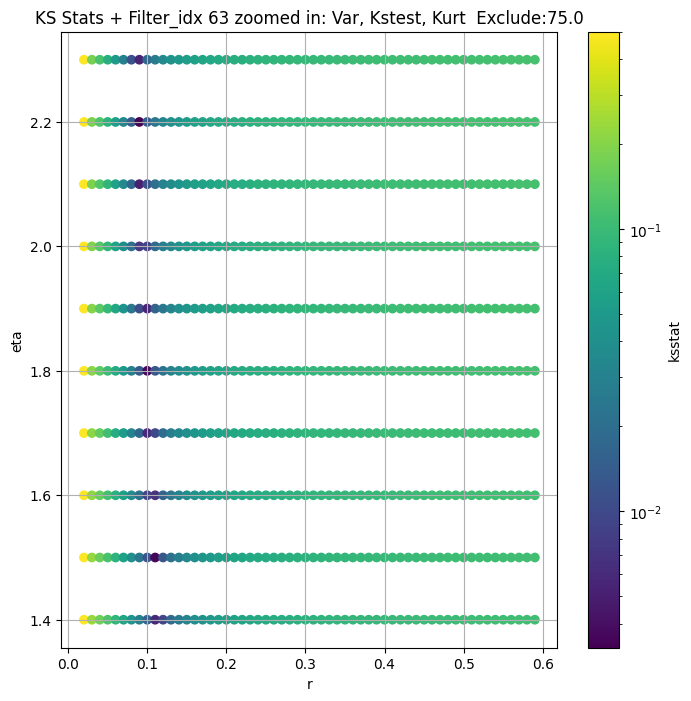

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,53.276510,33.872886,152.802713,68.874435,7.629437,437.942804,480000000.0,dual_color,0.025803,0.2,...,3.523579e-03,0.0,46.256614,0.000062,0.025800,0.20,-0.46,2.641464e-03,50.0,2746
2,72.914954,46.840640,194.994765,70.467031,8.488360,409.581182,480000000.0,dual_color,0.015952,0.2,...,1.726628e-02,0.0,72.914954,0.000062,0.012901,0.20,-0.77,1.494649e-02,0.0,10986
3,21.122359,13.977334,48.453006,60.386705,7.087002,367.258826,480000000.0,single_edge,0.006576,0.2,...,1.396981e-03,0.0,21.122359,0.000062,0.006576,0.20,-0.50,1.396981e-03,0.0,43944
4,87.957409,60.473776,142.215733,21.750371,7.542111,108.327211,480000000.0,dual_color,0.014571,0.3,...,2.848052e+00,100.0,82.733845,0.000062,0.013603,0.29,-1.00,2.420821e+00,25.0,10426
5,55.207904,39.862001,87.753125,16.862899,5.354291,133.778512,480000000.0,dual_color,0.025055,0.4,...,1.131375e+01,0.0,50.896948,0.000062,0.024932,0.40,-0.99,1.007182e+01,50.0,3088
6,40.185553,25.679989,105.328409,60.163445,6.741069,394.752770,480000000.0,single_edge,0.015931,0.4,...,6.174842e+00,200.0,33.001450,0.000062,0.014144,0.37,-1.00,4.577200e+00,100.0,9268
7,22.804529,16.940818,43.045728,22.371653,3.175920,204.336144,480000000.0,inside_out,0.029699,0.2,...,3.724690e-06,200.0,18.337940,0.000062,0.029632,0.19,2.90,7.646188e-07,275.0,2059
8,1.781040,1.258188,6.086729,120.835038,3.632314,537.290190,480000000.0,misc,0.014081,0.1,...,5.344107e-19,200.0,1.324201,0.000062,0.014080,0.10,5.30,3.326494e-19,300.0,9268
9,8.497680,4.809712,79.841307,1072.609333,6.218030,802.832624,480000000.0,multi_edge,0.003632,0.1,...,9.212643e-15,0.0,8.497680,0.000062,0.003632,0.10,1.20,9.212643e-15,0.0,140781


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

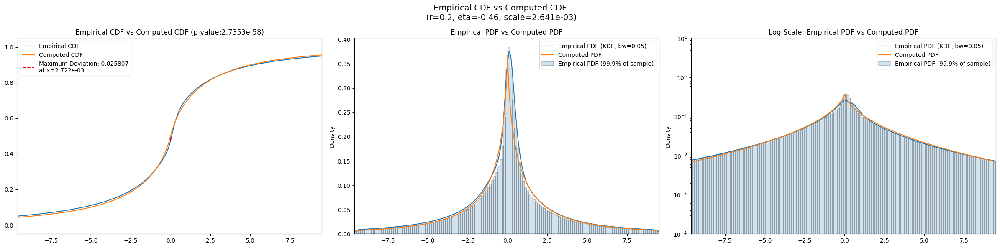

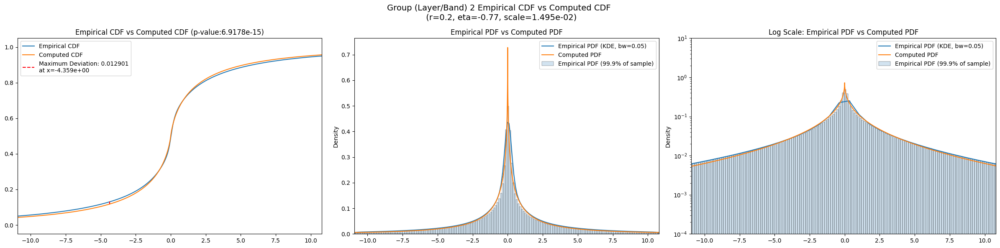

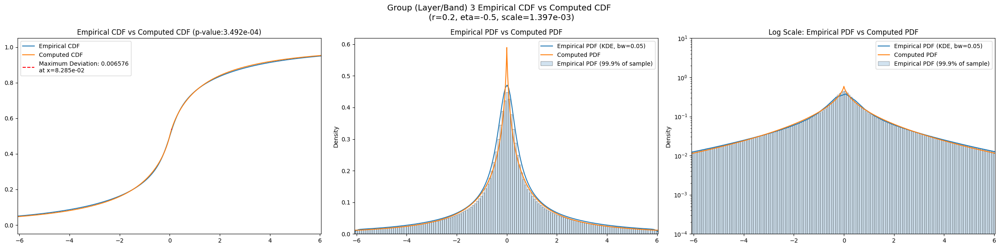

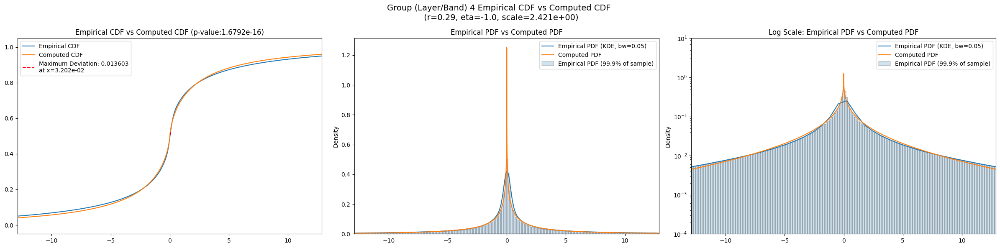

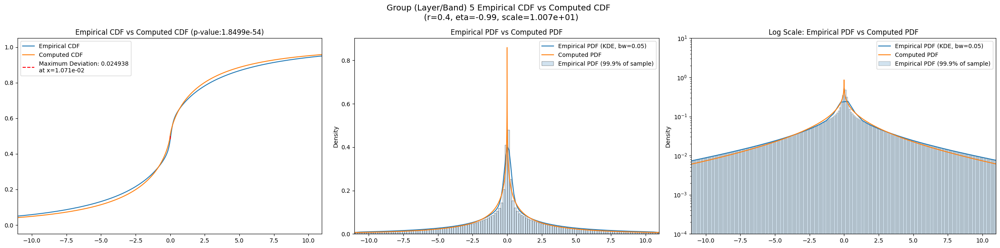

...

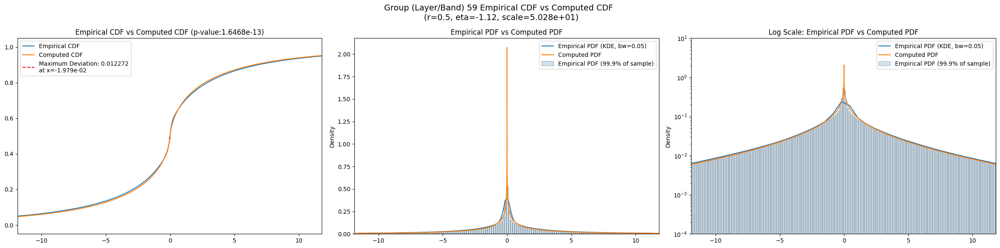

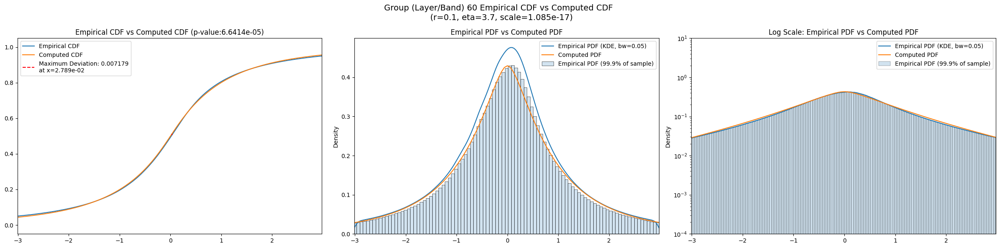

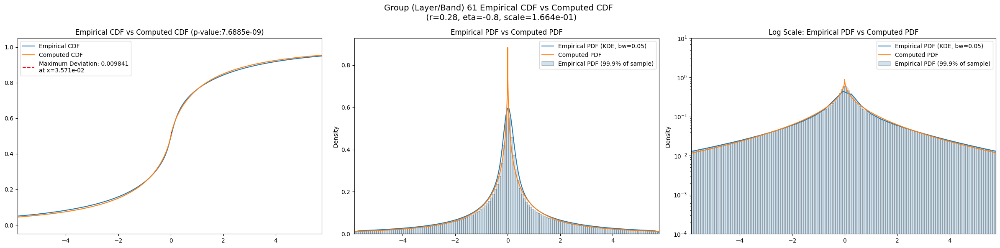

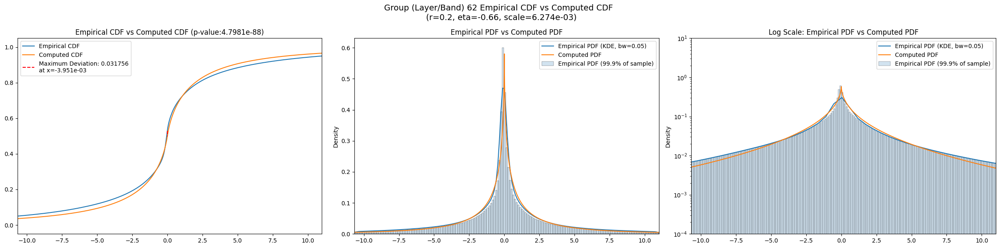

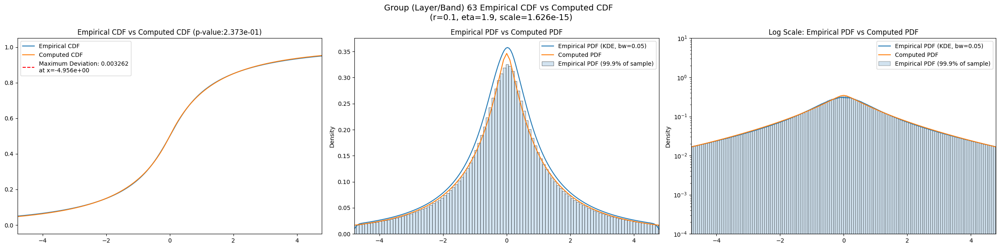

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,53.276510,33.872886,152.802713,68.874435,7.629437,437.942804,480000000.0,dual_color,0.025803,0.2,...,2.829450,0.074662,0.0,2.465740,0.047766,0.0,1.951510,0.048521,0.0,0.0
2,72.914954,46.840640,194.994765,70.467031,8.488360,409.581182,480000000.0,dual_color,0.015952,0.2,...,2.839180,0.081934,0.0,2.415930,0.057923,0.0,1.861730,0.059223,0.0,0.0
3,21.122359,13.977334,48.453006,60.386705,7.087002,367.258826,480000000.0,single_edge,0.006576,0.2,...,1.905640,0.069107,0.0,1.665240,0.042086,0.0,1.316330,0.042575,0.0,0.0
4,87.957409,60.473776,142.215733,21.750371,7.542111,108.327211,480000000.0,dual_color,0.014571,0.3,...,2.984230,0.089300,0.0,2.562430,0.064997,0.0,1.964360,0.065135,0.0,0.0
5,55.207904,39.862001,87.753125,16.862899,5.354291,133.778512,480000000.0,dual_color,0.025055,0.4,...,3.314710,0.077526,0.0,2.709190,0.057141,0.0,2.149630,0.060480,0.0,0.0
6,40.185553,25.679989,105.328409,60.163445,6.741069,394.752770,480000000.0,single_edge,0.015931,0.4,...,2.392350,0.079938,0.0,2.011950,0.056397,0.0,1.581060,0.059076,0.0,0.0
7,22.804529,16.940818,43.045728,22.371653,3.175920,204.336144,480000000.0,inside_out,0.029699,0.2,...,3.251990,0.041860,0.0,3.242930,0.030096,0.0,2.446680,0.029568,0.0,0.0
8,1.781040,1.258188,6.086729,120.835038,3.632314,537.290190,480000000.0,misc,0.014081,0.1,...,0.869876,0.037525,0.0,0.791239,0.014814,0.0,0.608901,0.014786,0.0,0.0
9,8.497680,4.809712,79.841307,1072.609333,6.218030,802.832624,480000000.0,multi_edge,0.003632,0.1,...,1.390110,0.052096,0.0,1.223710,0.024828,0.0,0.975549,0.024057,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.025803,0.000062,0.025800,0.074662,0.047766,0.048521
2,0.015952,0.000062,0.012901,0.081934,0.057923,0.059223
3,0.006576,0.000062,0.006576,0.069107,0.042086,0.042575
4,0.014571,0.000062,0.013603,0.089300,0.064997,0.065135
5,0.025055,0.000062,0.024932,0.077526,0.057141,0.060480
6,0.015931,0.000062,0.014144,0.079938,0.056397,0.059076
7,0.029699,0.000062,0.029632,0.041860,0.030096,0.029568
8,0.014081,0.000062,0.014080,0.037525,0.014814,0.014786
9,0.003632,0.000062,0.003632,0.052096,0.024828,0.024057


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,46.256614,0.025800,0.20,-0.46,2.641464e-03,50.0
2,72.914954,0.012901,0.20,-0.77,1.494649e-02,0.0
3,21.122359,0.006576,0.20,-0.50,1.396981e-03,0.0
4,82.733845,0.013603,0.29,-1.00,2.420821e+00,25.0
5,50.896948,0.024932,0.40,-0.99,1.007182e+01,50.0
6,33.001450,0.014144,0.37,-1.00,4.577200e+00,100.0
7,18.337940,0.029632,0.19,2.90,7.646188e-07,275.0
8,1.324201,0.014080,0.10,5.30,3.326494e-19,300.0
9,8.497680,0.003632,0.10,1.20,9.212643e-15,0.0
